In [1]:
import torch
import torchvision
import matplotlib.pyplot as plt
import numpy as np
from torchvision import transforms
from torch.utils.data import DataLoader
import torch.nn.functional as F
import math
from torch import nn
from tqdm import tqdm

In [2]:
# Helper function to show images
def show_images(dataset, num_samples=20, cols=4):
    plt.figure(figsize=(15,15))
    for i, (img, _) in enumerate(dataset):  # Access image and label from dataset
        if i == num_samples:
            break
        plt.subplot(int(num_samples/cols) + 1, cols, i + 1)
        plt.imshow(img)  # Display the image directly

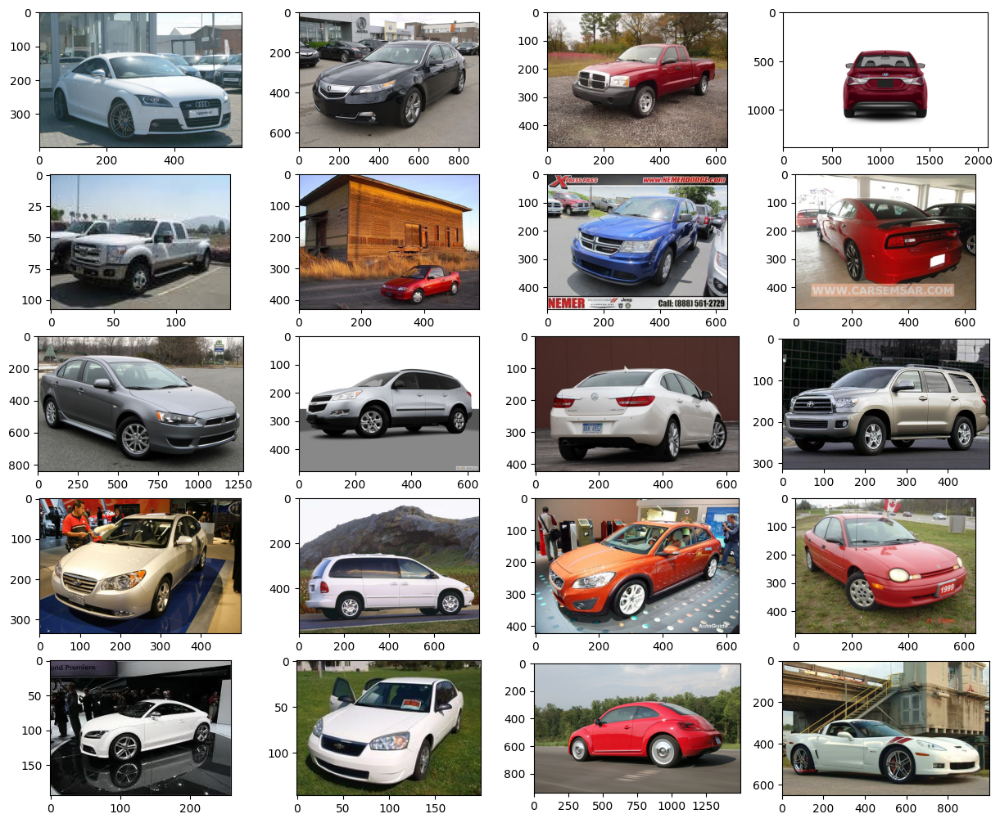

In [3]:
# Load the dataset, setting download=False and providing the path
data = torchvision.datasets.StanfordCars(root="./", download=False)
show_images(data)

### Forward Diffusion Process
In the forward diffusion process, we start from an image $𝑥_0$ and gradually add noise to it over a series of $T$ steps to generate $x_T$. <br>
**Beta Schedule:** $\beta_{t}$ = linear_beta_schedule(t) <br>
**Alpha Calculation:** $\alpha_{t} = 1 - \beta_{t}$ <br>
**Cumulative Alpha Product:** $\alpha_t^{(i)} = \prod_{i=1}^{t} \alpha_i$ <br>
**Posterior Variance:** $\text{posterior\_variance}_t = \frac{\beta_t (1 - \prod_{i=1}^{t-1} \alpha_i)}{1 - \prod_{i=1}^{t} \alpha_i}$ <br>
**Noise Scaling Formulas:** <br>
* $\sqrt{\frac{1}{\alpha_t}}$
* $\sqrt{\prod_{i=1}^{t} \alpha_i}$
* $\sqrt{1 - \prod_{i=1}^{t} \alpha_i}$

In [4]:
# Beta schedule and forward diffusion functions
def linear_beta_schedule(timesteps, start=0.0001, end=0.02):
    return torch.linspace(start, end, timesteps)

def get_index_from_list(vals, t, x_shape):
    batch_size = t.shape[0]
    out = vals.gather(-1, t.cpu())
    return out.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device)

def forward_diffusion_sample(x_0, t, device="cpu"):
    noise = torch.randn_like(x_0)
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod, t, x_0.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(sqrt_one_minus_alphas_cumprod, t, x_0.shape)
    return sqrt_alphas_cumprod_t.to(device) * x_0.to(device) + sqrt_one_minus_alphas_cumprod_t.to(device) * noise.to(device), noise.to(device)

In [5]:
# Define beta schedule
T = 300
betas = linear_beta_schedule(timesteps=T)

In [6]:
# Pre-calculate different terms for closed form
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, axis=0)
alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0)
sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)

In [7]:
# Dataset transformations and loading
IMG_SIZE = 64
BATCH_SIZE = 128

In [8]:
def load_transformed_dataset():
    data_transforms = [
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(), # Scales data into [0,1]
        transforms.Lambda(lambda t: (t * 2) - 1) # Scale between [-1, 1]
    ]
    data_transform = transforms.Compose(data_transforms)

    train = torchvision.datasets.StanfordCars(root="./", download=False,
                                         transform=data_transform)

    test = torchvision.datasets.StanfordCars(root="./", download=False,
                                         transform=data_transform, split='test')
    return torch.utils.data.ConcatDataset([train, test])

In [9]:
def show_tensor_image(image):
    reverse_transforms = transforms.Compose([
        transforms.Lambda(lambda t: (t + 1) / 2),
        transforms.Lambda(lambda t: t.permute(1, 2, 0)), # CHW to HWC
        transforms.Lambda(lambda t: t * 255.),
        transforms.Lambda(lambda t: t.cpu().numpy().astype(np.uint8)), # Move tensor to CPU
        transforms.ToPILImage(),
    ])

    if len(image.shape) == 4:
        image = image[0, :, :, :]
    plt.imshow(reverse_transforms(image))

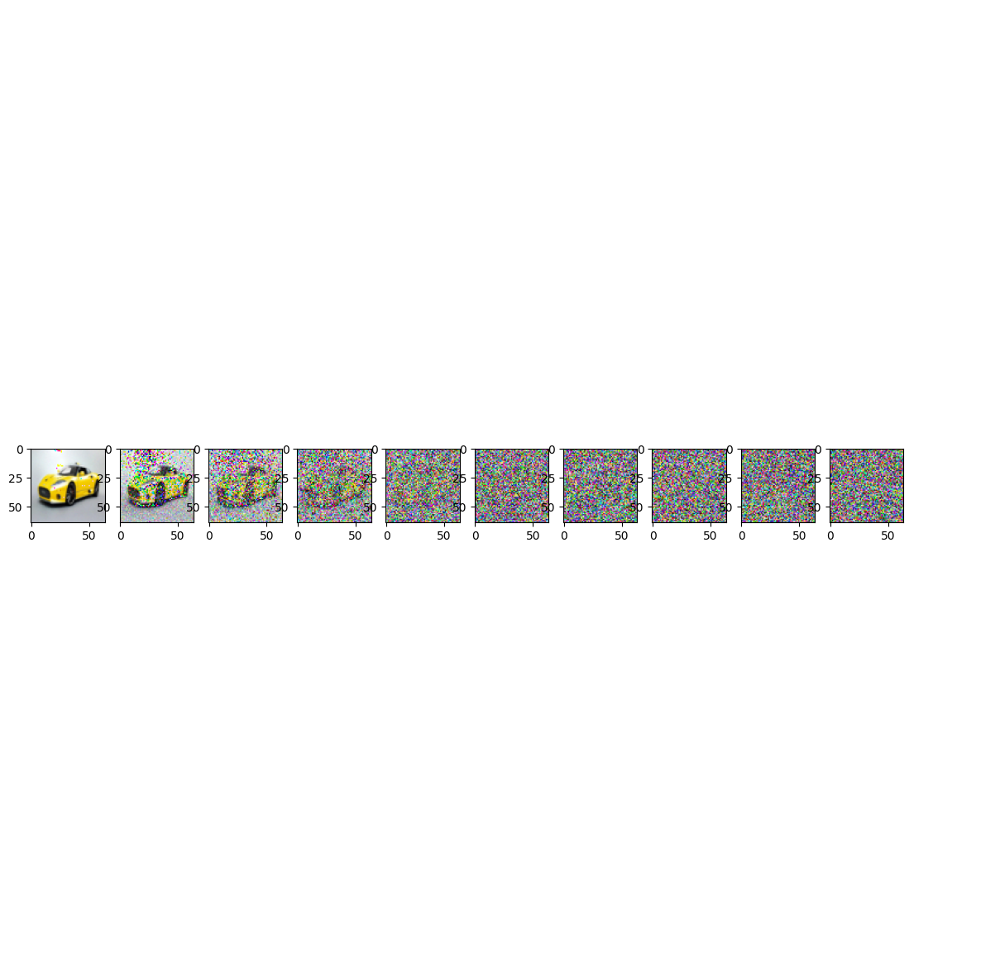

In [10]:
data = load_transformed_dataset()
dataloader = DataLoader(data, batch_size=BATCH_SIZE, shuffle=True, drop_last=True)

# Simulate forward diffusion
device = "cuda" if torch.cuda.is_available() else "cpu"
image = next(iter(dataloader))[0]

plt.figure(figsize=(15,15))
plt.axis('off')
num_images = 10
stepsize = int(T/num_images)

for idx in range(0, T, stepsize):
    t = torch.Tensor([idx]).type(torch.int64)
    plt.subplot(1, num_images+1, int(idx/stepsize) + 1)
    img, noise = forward_diffusion_sample(image, t, device)
    show_tensor_image(img)

In [11]:
# UNet model definition
class Block(nn.Module):
    def __init__(self, in_ch, out_ch, time_emb_dim, up=False):
        super().__init__()
        self.time_mlp =  nn.Linear(time_emb_dim, out_ch)
        if up:
            self.conv1 = nn.Conv2d(2*in_ch, out_ch, 3, padding=1)
            self.transform = nn.ConvTranspose2d(out_ch, out_ch, 4, 2, 1)
        else:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
            self.transform = nn.Conv2d(out_ch, out_ch, 4, 2, 1)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.bnorm1 = nn.BatchNorm2d(out_ch)
        self.bnorm2 = nn.BatchNorm2d(out_ch)
        self.relu  = nn.ReLU()

    def forward(self, x, t):
        h = self.bnorm1(self.relu(self.conv1(x)))
        time_emb = self.relu(self.time_mlp(t))
        time_emb = time_emb[(..., ) + (None, ) * 2]
        h = h + time_emb
        h = self.bnorm2(self.relu(self.conv2(h)))
        return self.transform(h)

In [12]:
class SinusoidalPositionEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        device = time.device
        half_dim = self.dim // 2
        embeddings = math.log(10000) / (half_dim - 1)
        embeddings = torch.exp(torch.arange(half_dim, device=device) * -embeddings)
        embeddings = time[:, None] * embeddings[None, :]
        embeddings = torch.cat((embeddings.sin(), embeddings.cos()), dim=-1)
        return embeddings

In [13]:
class SimpleUnet(nn.Module):
    def __init__(self):
        super().__init__()
        image_channels = 3
        down_channels = (64, 128, 256, 512, 1024)
        up_channels = (1024, 512, 256, 128, 64)
        out_dim = 3
        time_emb_dim = 32

        self.time_mlp = nn.Sequential(
                SinusoidalPositionEmbeddings(time_emb_dim),
                nn.Linear(time_emb_dim, time_emb_dim),
                nn.ReLU()
            )

        self.conv0 = nn.Conv2d(image_channels, down_channels[0], 3, padding=1)

        self.downs = nn.ModuleList([Block(down_channels[i], down_channels[i+1], time_emb_dim) for i in range(len(down_channels)-1)])
        self.ups = nn.ModuleList([Block(up_channels[i], up_channels[i+1], time_emb_dim, up=True) for i in range(len(up_channels)-1)])
        self.output = nn.Conv2d(up_channels[-1], out_dim, 1)

    def forward(self, x, timestep):
        t = self.time_mlp(timestep)
        x = self.conv0(x)
        residual_inputs = []
        for down in self.downs:
            x = down(x, t)
            residual_inputs.append(x)
        for up in self.ups:
            residual_x = residual_inputs.pop()
            x = torch.cat((x, residual_x), dim=1)
            x = up(x, t)
        return self.output(x)

In [14]:
model = SimpleUnet()
print("Num params: ", sum(p.numel() for p in model.parameters()))
model

Num params:  62438883


SimpleUnet(
  (time_mlp): Sequential(
    (0): SinusoidalPositionEmbeddings()
    (1): Linear(in_features=32, out_features=32, bias=True)
    (2): ReLU()
  )
  (conv0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (downs): ModuleList(
    (0): Block(
      (time_mlp): Linear(in_features=32, out_features=128, bias=True)
      (conv1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transform): Conv2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bnorm1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (bnorm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
    )
    (1): Block(
      (time_mlp): Linear(in_features=32, out_features=256, bias=True)
      (conv1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transfor

### Training Objective
* Train the model $\epsilon_\theta(x_t, t)$ to predict the noise $\epsilon$ added to $x_t$.
* The loss function is typically the mean square error (MSE) between the true noise $\epsilon$ and the predicted noise $\epsilon_\theta(x_t, t)$:
  $$L = \mathbb{E}_{x_0,\epsilon,t}\bigg{[} ||\epsilon - \epsilon_\theta(x_t, t)||^{2} \bigg{]}$$

In [15]:
# Loss and sampling functions
def get_loss(model, x_0, t, device):
    x_noisy, noise = forward_diffusion_sample(x_0, t, device)
    noise_pred = model(x_noisy, t)
    return F.l1_loss(noise, noise_pred)

In [ ]:
# def get_loss(model, x_0, t, device):
#     x_noisy, noise = forward_diffusion_sample(x_0.to(device), t, device)
#     noise_pred = model(x_noisy, t)
#     return F.l1_loss(noise, noise_pred)


### Reverse Diffusion Process
*  Gradually denoise $x_T$ through *T* timesteps to generate a new image $x_0$.
*  At each timestep *t*, use the model $\epsilon_\theta(x_t,t)$ to predict the noise, and update the image using the reverse process: <br>
  $ x_{t-1} =  \frac{1}{\sqrt{\alpha_t}} \bigg{(} x_t - \frac{1 - \alpha_t}{\sqrt{1 - \bar\alpha_t}} \epsilon_\theta (x_t, t) \bigg{)} + \sigma_tz,$  &nbsp;$ z \sim \mathcal{N}(0, I)$
* Here, $\sigma_t$ is the standard deviation for the noise added at each reverse step, ensuring that the sampling process retains some randomness.                 

In [16]:
@torch.no_grad()
def sample_timestep(x, t, device):
    betas_t = get_index_from_list(betas, t, x.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(sqrt_one_minus_alphas_cumprod, t, x.shape)
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas, t, x.shape)

    model_mean = sqrt_recip_alphas_t * (x - betas_t * model(x, t) / sqrt_one_minus_alphas_cumprod_t)
    posterior_variance_t = get_index_from_list(posterior_variance, t, x.shape)

    if t == 0:
        return model_mean
    else:
        noise = torch.randn_like(x)
        return model_mean + torch.sqrt(posterior_variance_t) * noise

In [17]:
# @torch.no_grad()
# def sample_plot_image(device):
#     img_size = 64
#     img = torch.randn((1, 3, img_size, img_size), device=device)
#     plt.figure(figsize=(15,15))
#     plt.axis('off')
#     num_images = 10
#     stepsize = int(T/num_images)

#     for i in range(0, T)[::-1]:
#         t = torch.full((1,), i, device=device, dtype=torch.long)
#         img = sample_timestep(img, t, device)
#         if i % stepsize == 0:
#             plt.subplot(1, num_images+1, int(i/stepsize) + 1)
#             show_tensor_image(img.detach().cpu())

#     plt.show()

@torch.no_grad()
def sample_plot_image(device):
    img_size = IMG_SIZE
    img = torch.randn((1, 3, img_size, img_size), device=device)
    plt.figure(figsize=(15, 15))
    plt.axis('off')
    num_images = 10
    stepsize = int(T / num_images)

    for i in range(0, T):
        t = torch.full((1,), T - 1 - i, device=device, dtype=torch.long)  # Reverse the order of t
        img = sample_timestep(img, t, device)
        img = torch.clamp(img, -1.0, 1.0)
        if i % stepsize == 0:
            plt.subplot(1, num_images, int(i / stepsize) + 1)
            show_tensor_image(img.detach().cpu())
    plt.show()

In [18]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
epochs = 300
path = 'model_checkpoint.pth'
loss = None

In [19]:
def train_model(optimizer, epochs, path):
    device = "cuda" if torch.cuda.is_available() else "cpu"
    model.to(device)
    loss = None  # Initialize loss within the function
    for epoch in range(epochs):
        print(f"Epoch {epoch} started")
        for step, batch in enumerate(dataloader):
            optimizer.zero_grad()
            t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
            loss = get_loss(model, batch[0].to(device), t, device)
            loss.backward()
            optimizer.step()

            if epoch % 10 == 0 and step == 0:
                print(f"Loss: {loss.item()}")
                sample_plot_image(device)
    return loss

In [20]:
# def train_model(optimizer, epochs, path):
#     device = "cuda" if torch.cuda.is_available() else "cpu"
#     model.to(device)
#     loss = None  # Initialize loss within the function
#     for epoch in range(epochs):
#         print(f"Epoch {epoch} started")
#         for step, batch in enumerate(dataloader):
#             optimizer.zero_grad()
#             t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
#             loss = get_loss(model, batch[0].to(device), t, device)
#             loss.backward()
#             optimizer.step()

#             if epoch % 5 == 0 and step == 0:
#                 print(f"Loss: {loss.item()}")
#                 sample_plot_image(device)
#     return loss

In [21]:
def save_model(model, optimizer, epoch, loss, path):
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'loss': loss,
    }, path)

In [22]:
def load_model(model, optimizer, path):
    checkpoint = torch.load(path)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    loss = checkpoint['loss']
    return epoch, loss

In [ ]:
# loss = train_model(optimizer, epochs, path)


In [ ]:
# save_model(model, optimizer, epochs, loss, path)

In [23]:
epoch, loss = load_model(model, optimizer, path)
print(f"Loaded model from epoch {epoch} with loss {loss}")

Loaded model from epoch 400 with loss None


In [24]:
#####

In [25]:
def get_loss(model, x_0, t, device):
    x_noisy, noise = forward_diffusion_sample(x_0.to(device), t.to(device), device)
    noise_pred = model(x_noisy, t)
    return F.l1_loss(noise, noise_pred)


In [26]:
@torch.no_grad()
def sample_timestep(x, t, device):
    betas_t = get_index_from_list(betas, t, x.shape).to(device)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x.shape).to(device)
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas, t, x.shape).to(device)

    model_mean = sqrt_recip_alphas_t * (
        x - betas_t * model(x, t) / sqrt_one_minus_alphas_cumprod_t
    )
    posterior_variance_t = get_index_from_list(posterior_variance, t, x.shape).to(device)

    if t == 0:
        return model_mean
    else:
        noise = torch.randn_like(x, device=device)
        return model_mean + torch.sqrt(posterior_variance_t) * noise


In [27]:
@torch.no_grad()
def sample_plot_image(device):
    img_size = IMG_SIZE
    img = torch.randn((1, 3, img_size, img_size), device=device)
    plt.figure(figsize=(15, 15))
    plt.axis('off')
    num_images = 10
    stepsize = int(T / num_images)

    for i in range(0, T):
        t = torch.full((1,), T - 1 - i, device=device, dtype=torch.long)  # Reverse the order of t
        img = sample_timestep(img, t, device)
        img = torch.clamp(img, -1.0, 1.0)
        if i % stepsize == 0:
            plt.subplot(1, num_images, int(i / stepsize) + 1)
            show_tensor_image(img.detach().cpu())
    plt.show()


Epoch 0 started
Loss: 0.13231411576271057


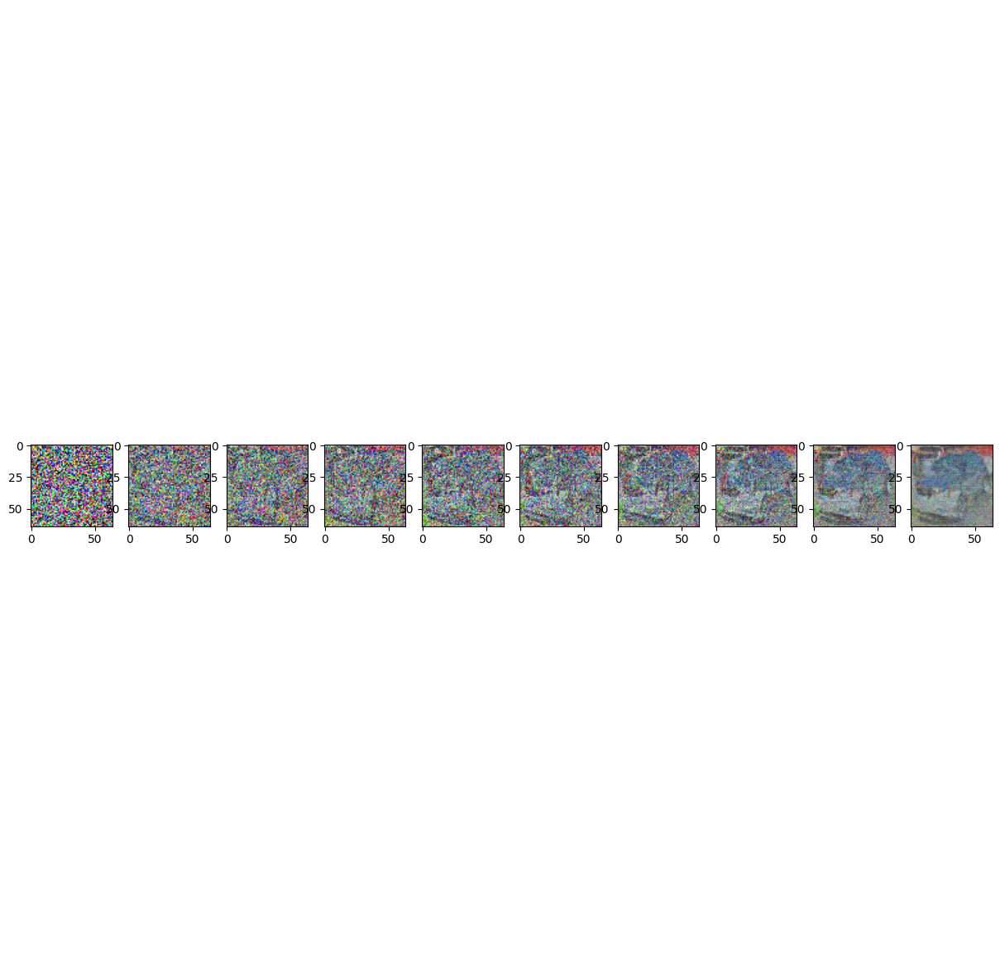

Epoch 1 started
Epoch 2 started
Epoch 3 started
Epoch 4 started
Epoch 5 started
Loss: 0.12688755989074707


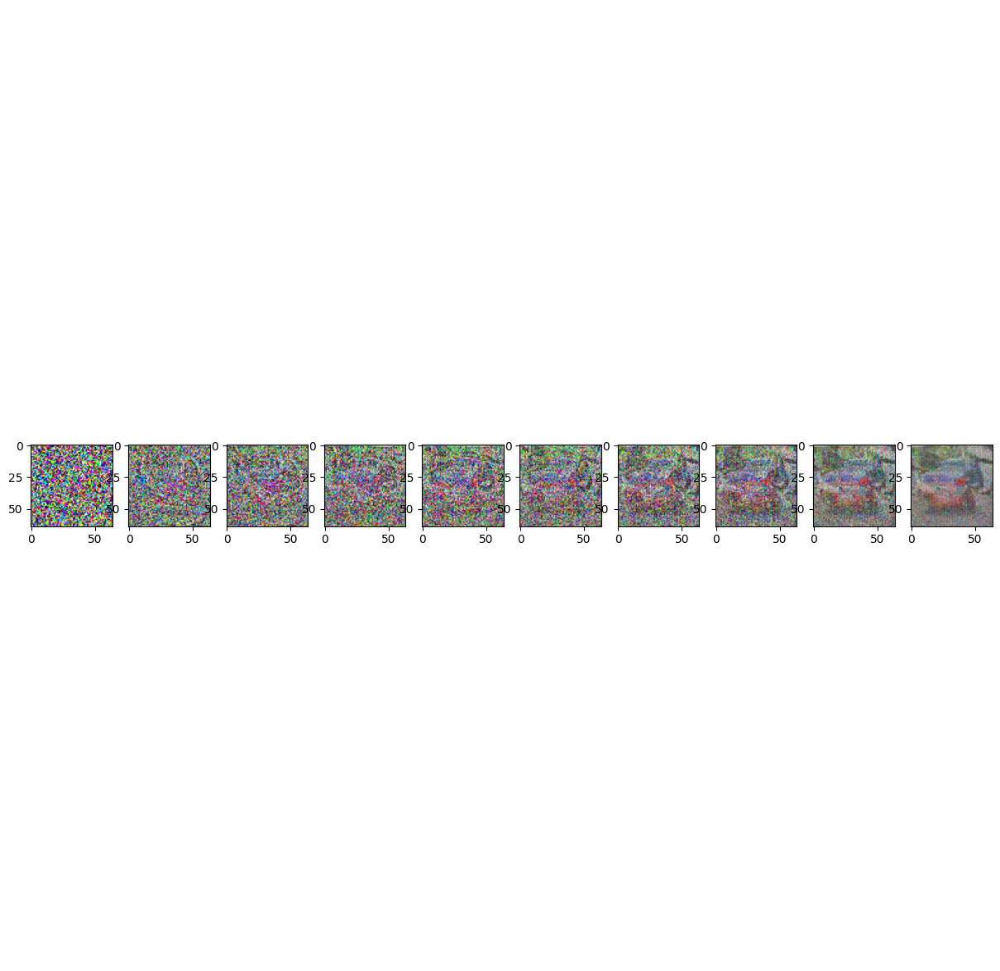

Epoch 6 started
Epoch 7 started
Epoch 8 started
Epoch 9 started
Epoch 10 started
Loss: 0.11843588203191757


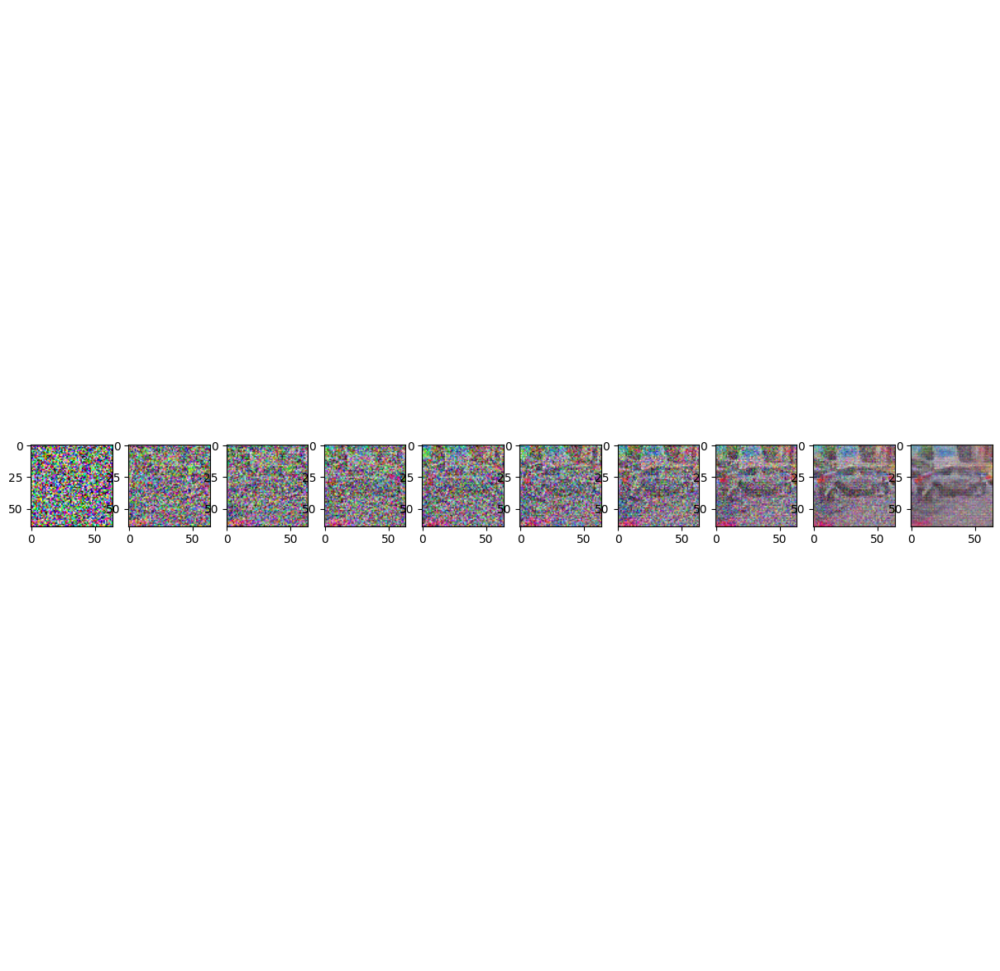

Epoch 11 started
Epoch 12 started
Epoch 13 started
Epoch 14 started
Epoch 15 started
Loss: 0.11829042434692383


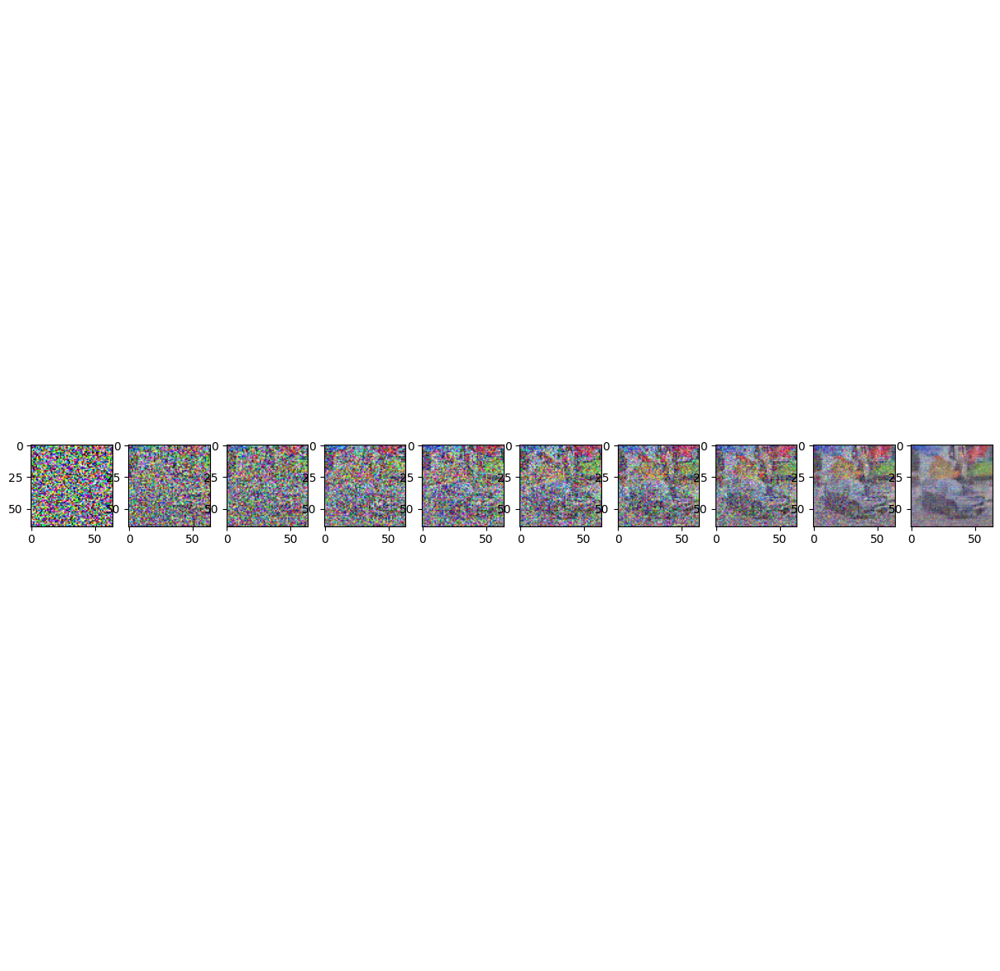

Epoch 16 started
Epoch 17 started
Epoch 18 started
Epoch 19 started
Epoch 20 started
Loss: 0.13345615565776825


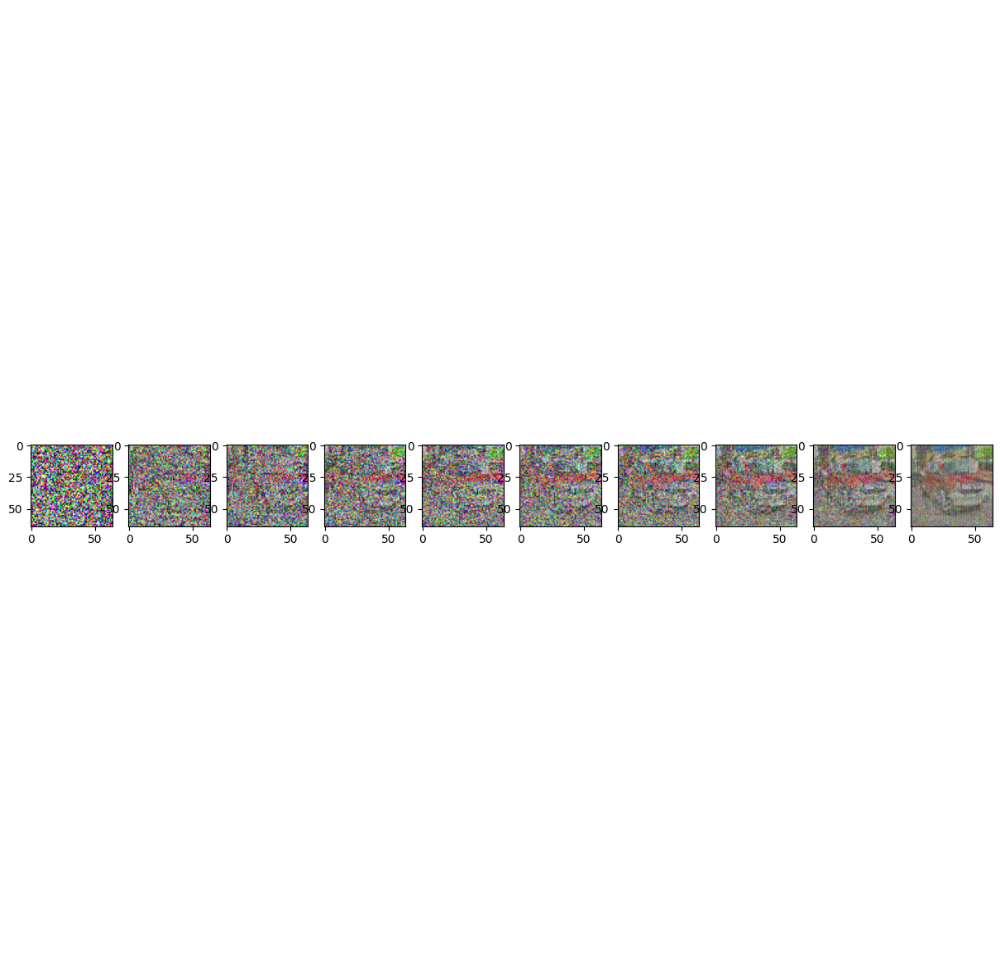

Epoch 21 started
Epoch 22 started
Epoch 23 started
Epoch 24 started
Epoch 25 started
Loss: 0.12042635679244995


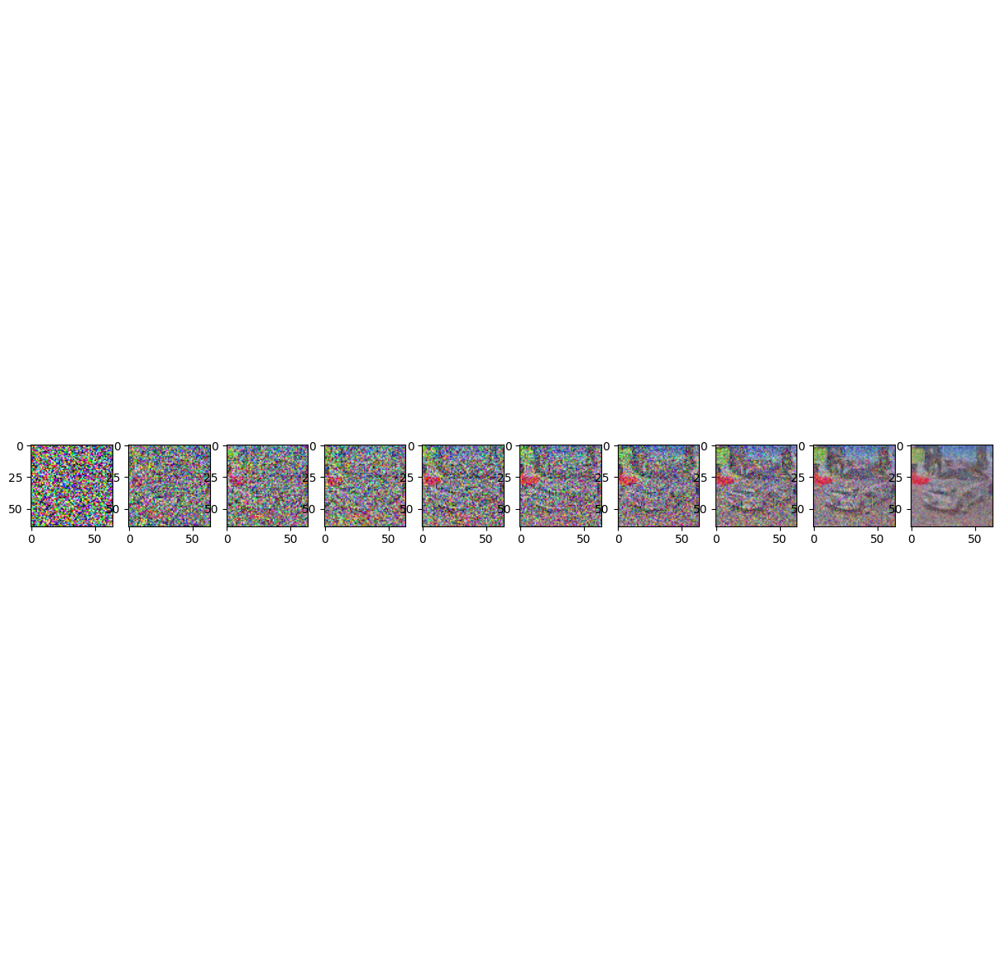

Epoch 26 started
Epoch 27 started
Epoch 28 started
Epoch 29 started
Epoch 30 started
Loss: 0.12131626904010773


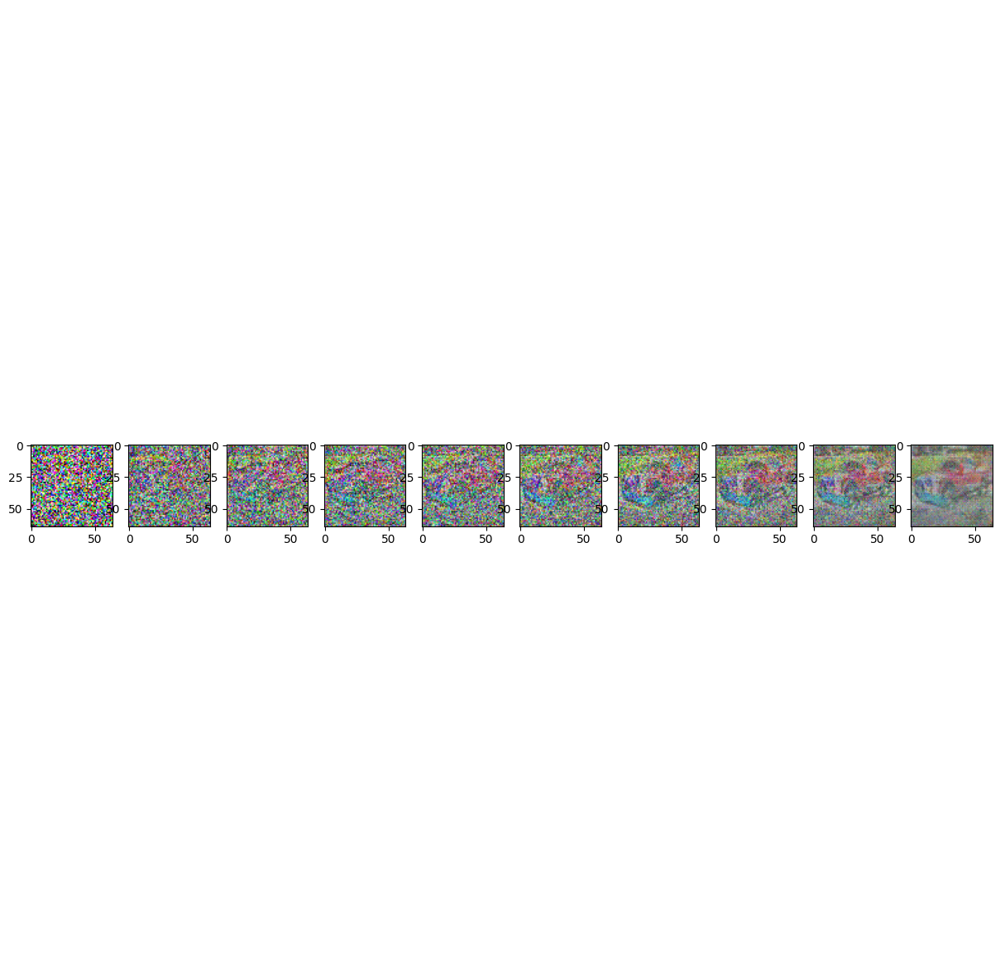

Epoch 31 started
Epoch 32 started
Epoch 33 started
Epoch 34 started
Epoch 35 started
Loss: 0.11881214380264282


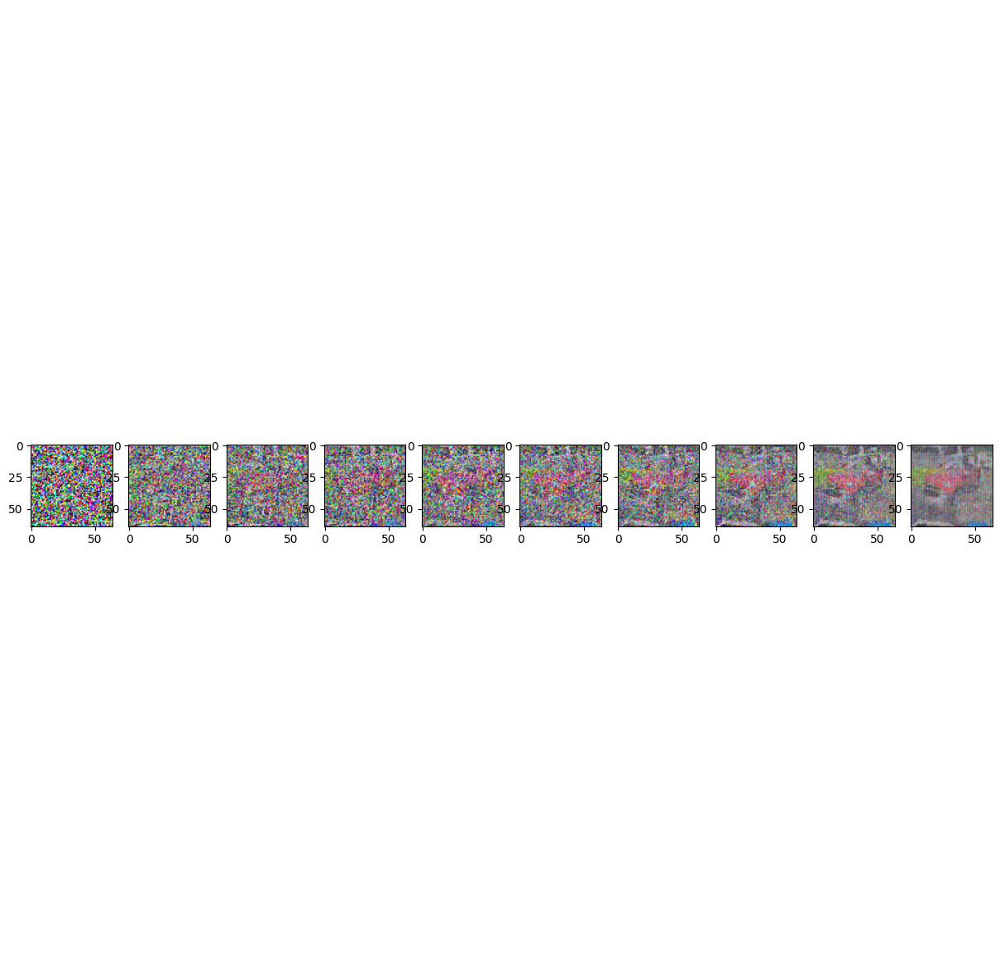

Epoch 36 started
Epoch 37 started
Epoch 38 started
Epoch 39 started
Epoch 40 started
Loss: 0.13175146281719208


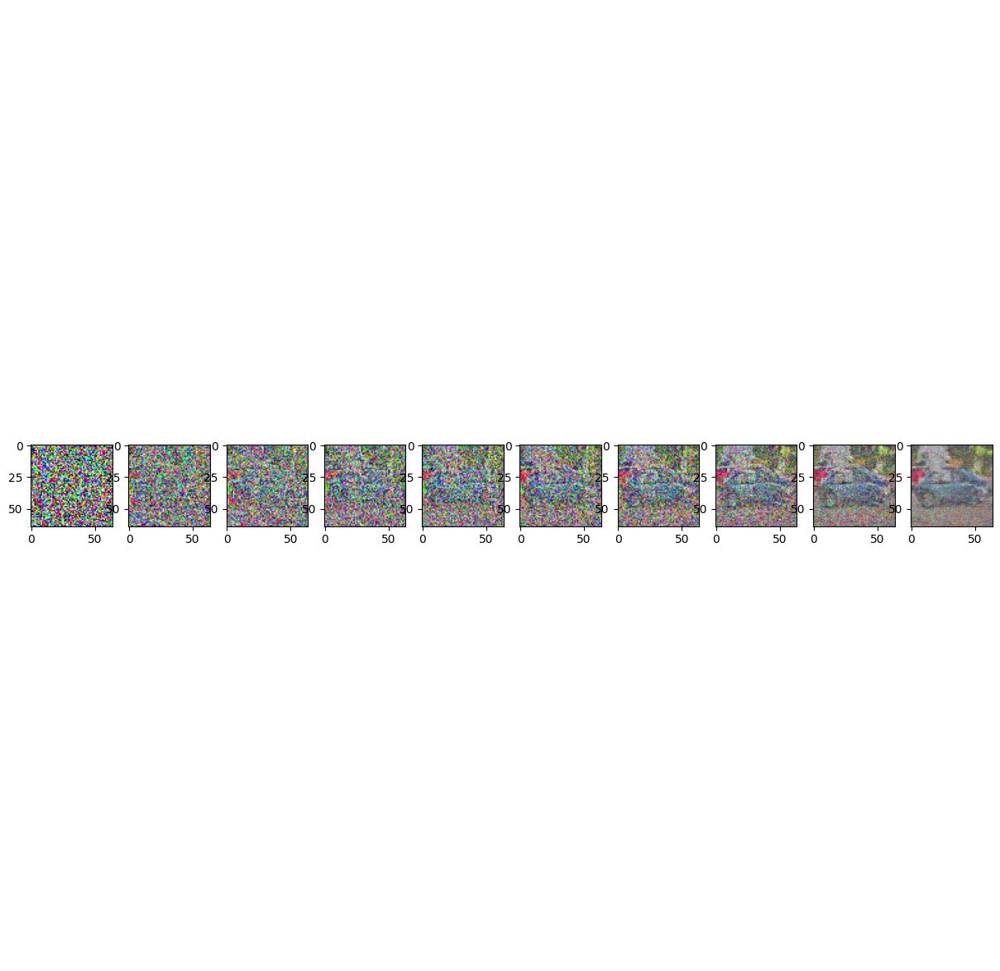

Epoch 41 started
Epoch 42 started
Epoch 43 started
Epoch 44 started
Epoch 45 started
Loss: 0.1263577789068222


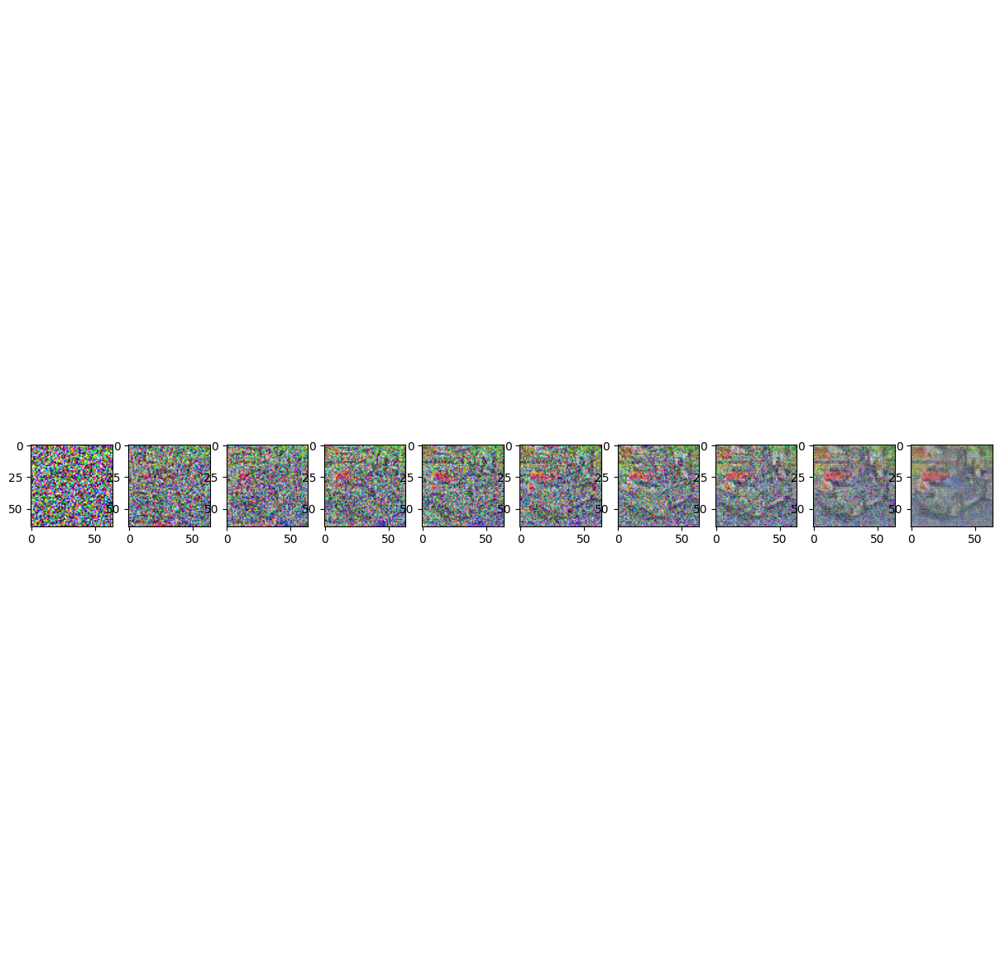

Epoch 46 started
Epoch 47 started
Epoch 48 started
Epoch 49 started
Epoch 50 started
Loss: 0.14975950121879578


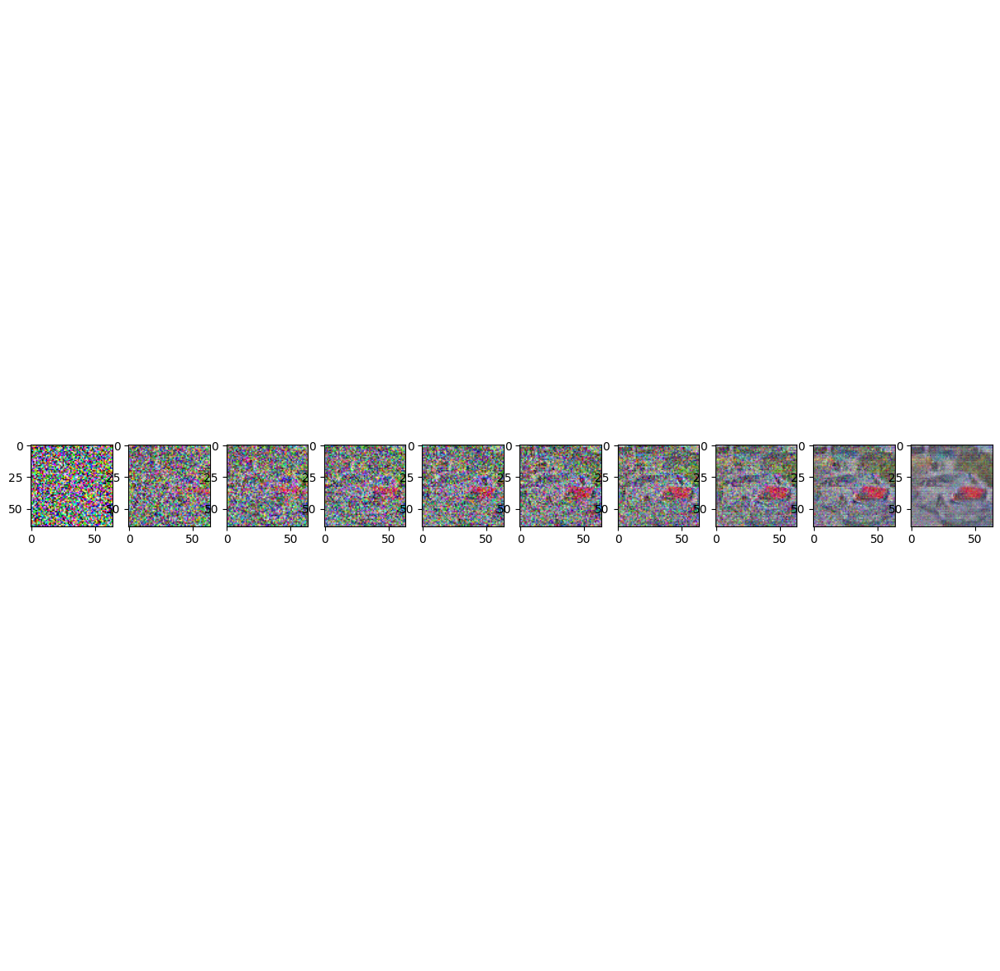

Epoch 51 started
Epoch 52 started
Epoch 53 started
Epoch 54 started
Epoch 55 started
Loss: 0.15538112819194794


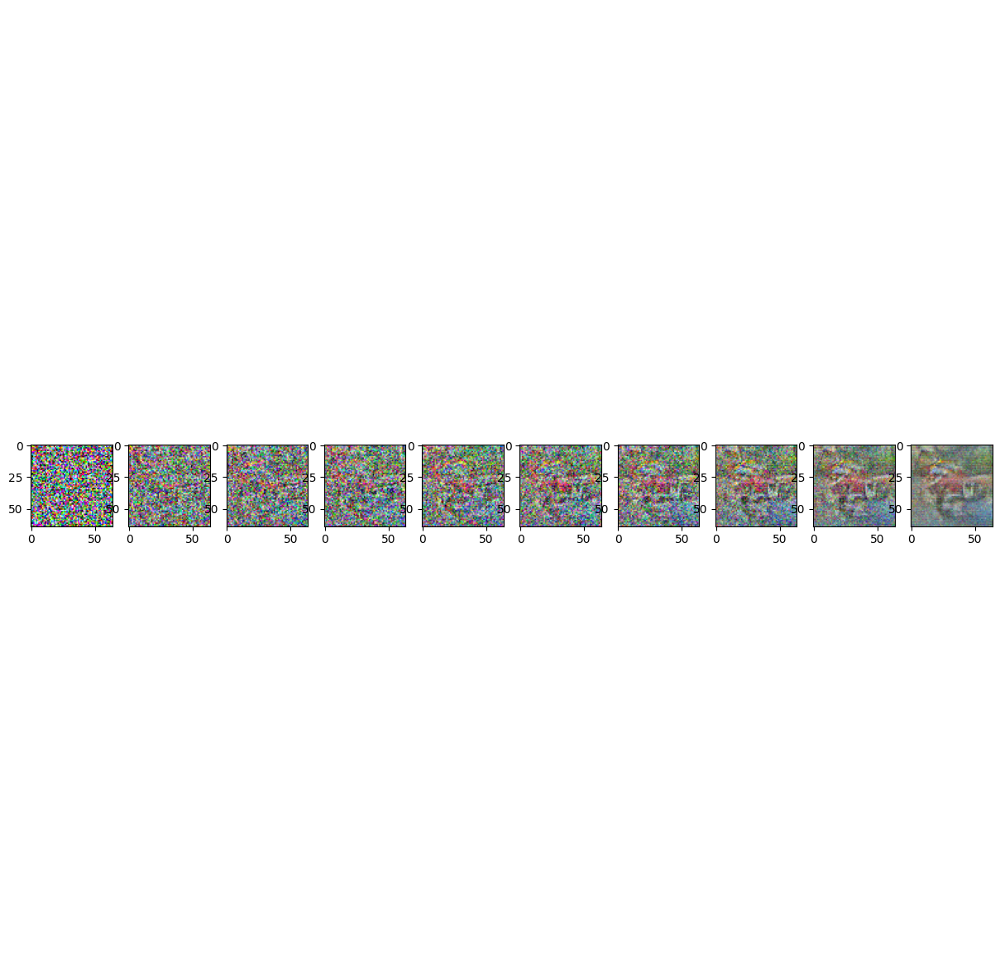

Epoch 56 started
Epoch 57 started
Epoch 58 started
Epoch 59 started
Epoch 60 started
Loss: 0.14564426243305206


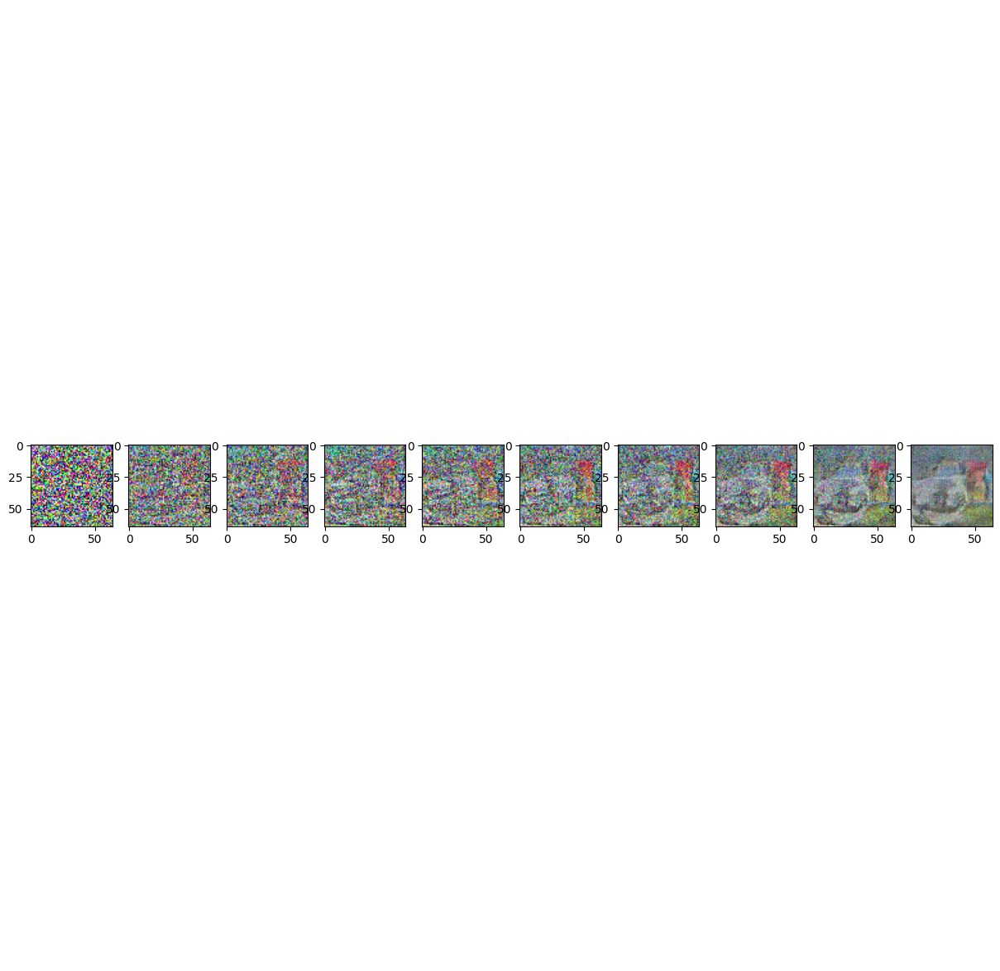

Epoch 61 started
Epoch 62 started
Epoch 63 started
Epoch 64 started
Epoch 65 started
Loss: 0.12788930535316467


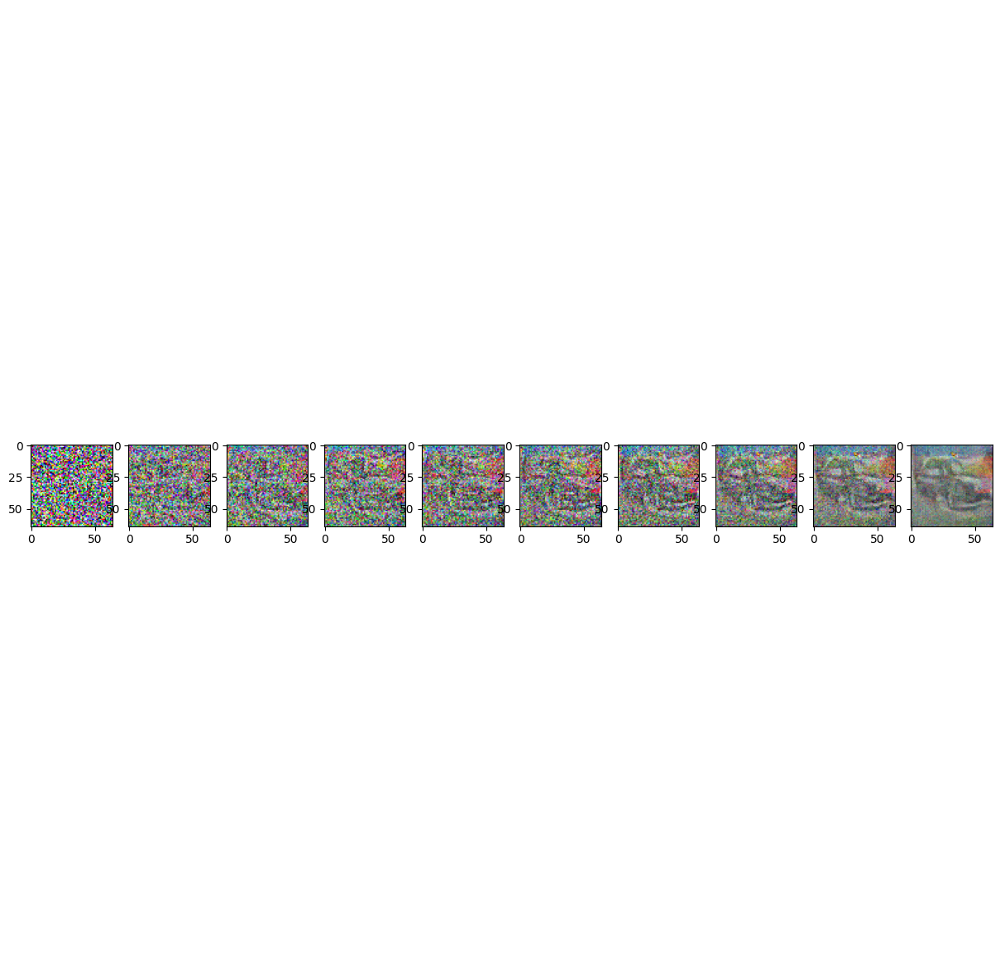

Epoch 66 started
Epoch 67 started
Epoch 68 started
Epoch 69 started
Epoch 70 started
Loss: 0.12965945899486542


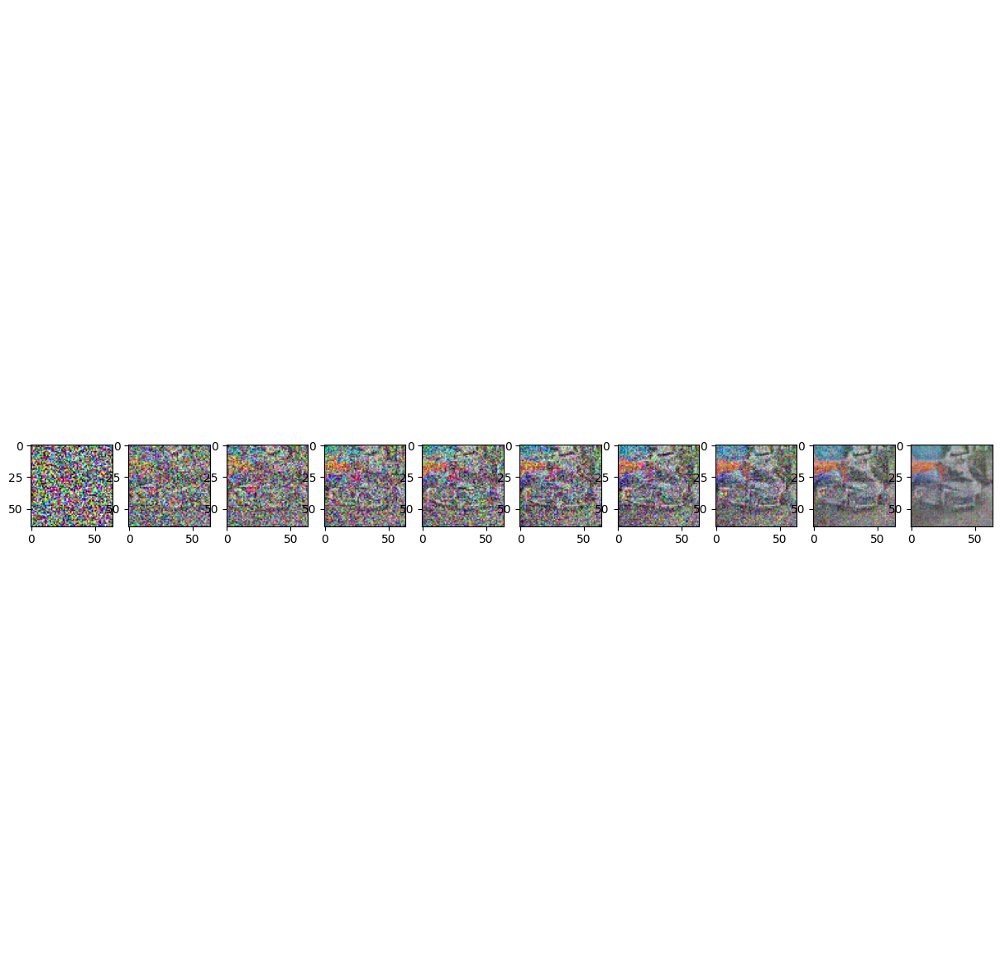

Epoch 71 started
Epoch 72 started
Epoch 73 started
Epoch 74 started
Epoch 75 started
Loss: 0.13516241312026978


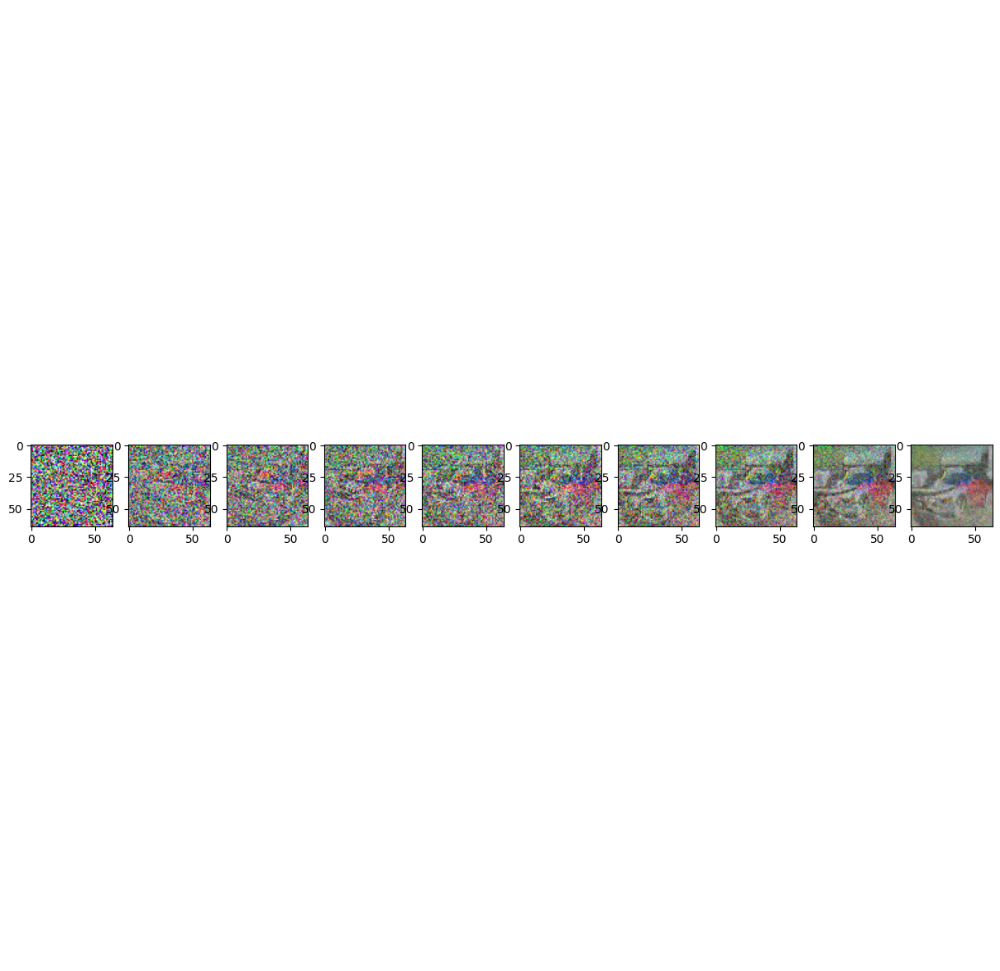

Epoch 76 started
Epoch 77 started
Epoch 78 started
Epoch 79 started
Epoch 80 started
Loss: 0.13845603168010712


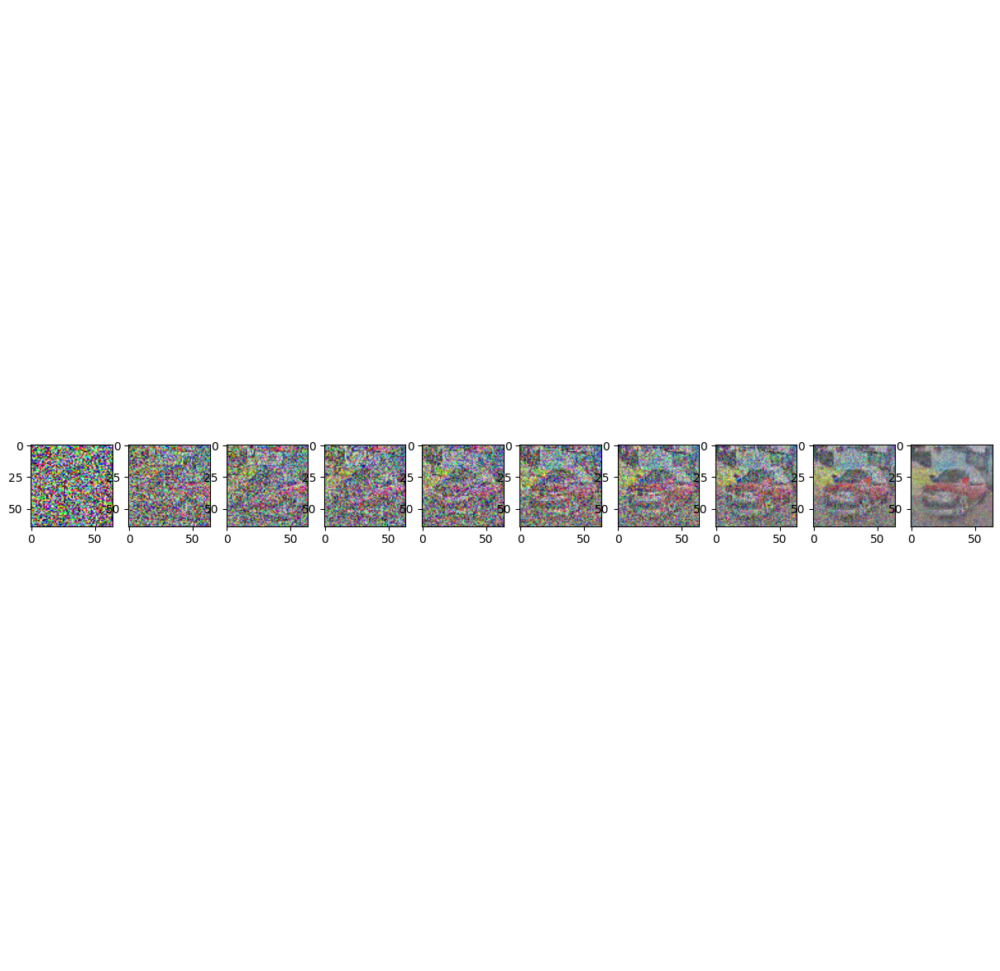

Epoch 81 started
Epoch 82 started
Epoch 83 started
Epoch 84 started
Epoch 85 started
Loss: 0.12885859608650208


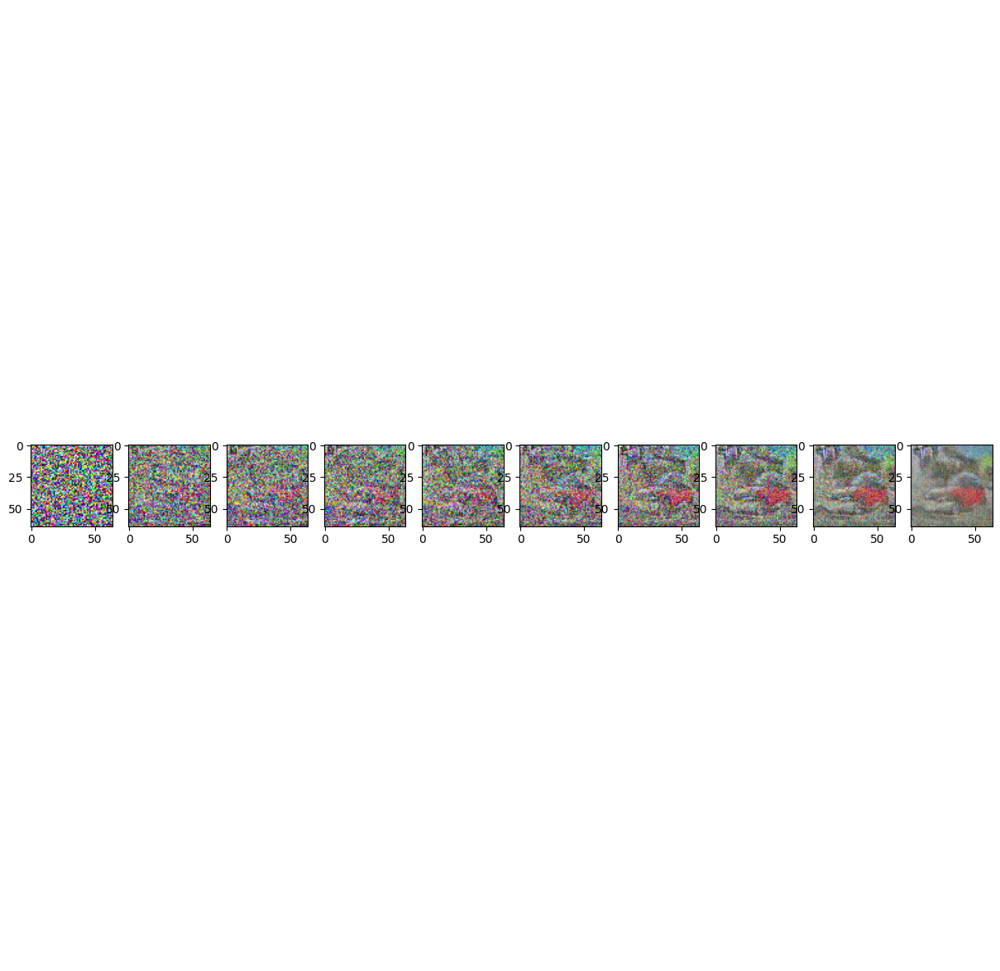

Epoch 86 started
Epoch 87 started
Epoch 88 started
Epoch 89 started
Epoch 90 started
Loss: 0.13791371881961823


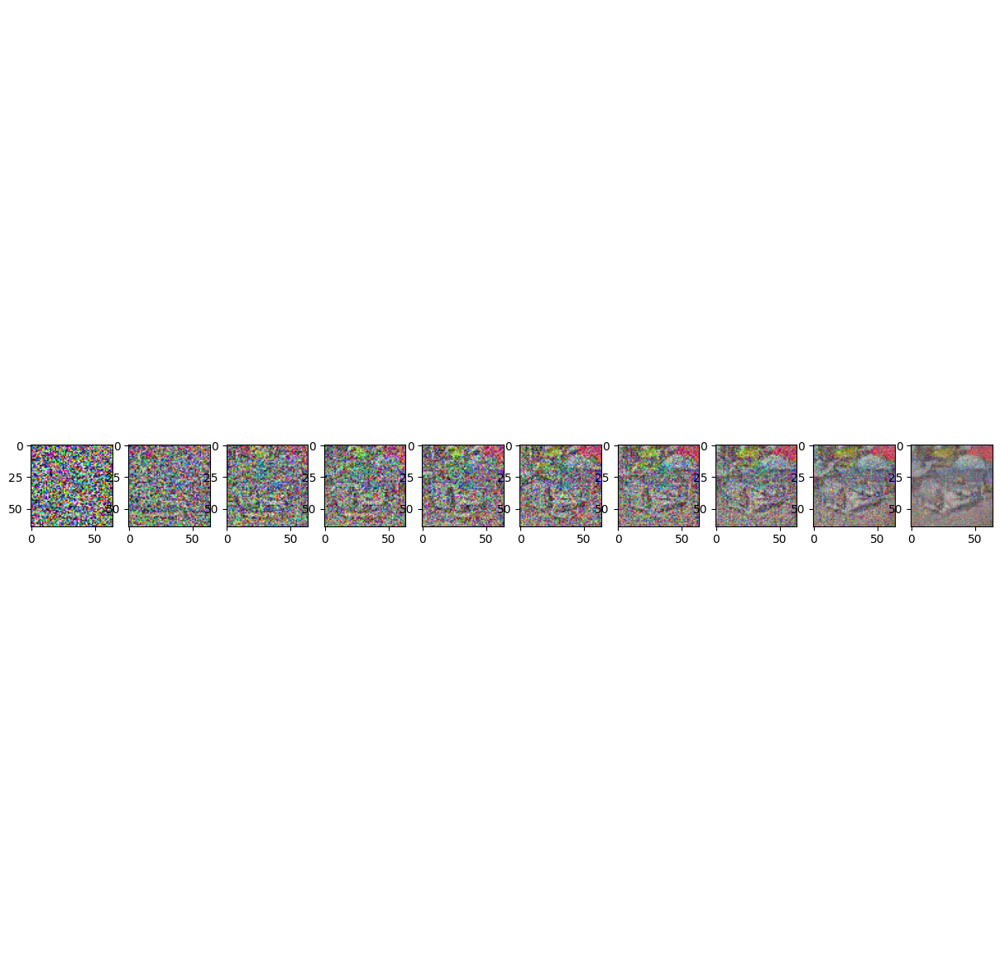

Epoch 91 started
Epoch 92 started
Epoch 93 started
Epoch 94 started
Epoch 95 started
Loss: 0.11979670822620392


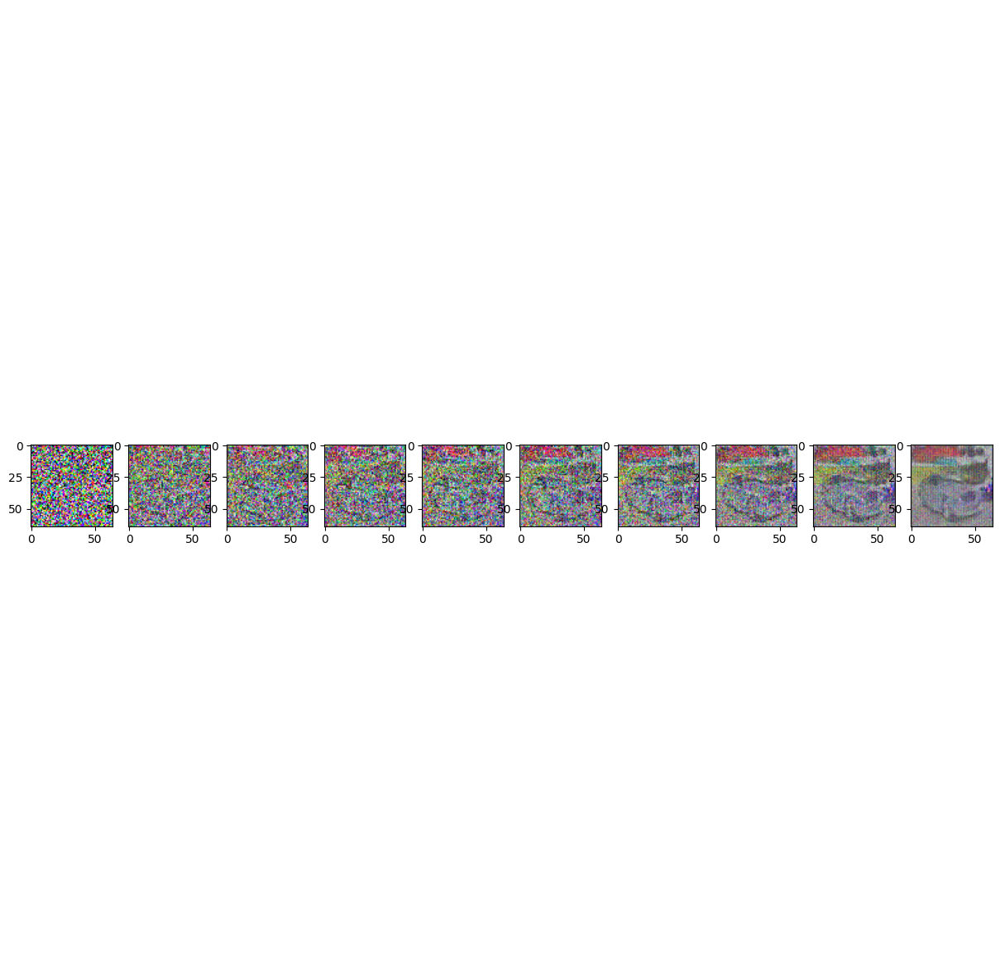

Epoch 96 started
Epoch 97 started
Epoch 98 started
Epoch 99 started
Epoch 100 started
Loss: 0.12739723920822144


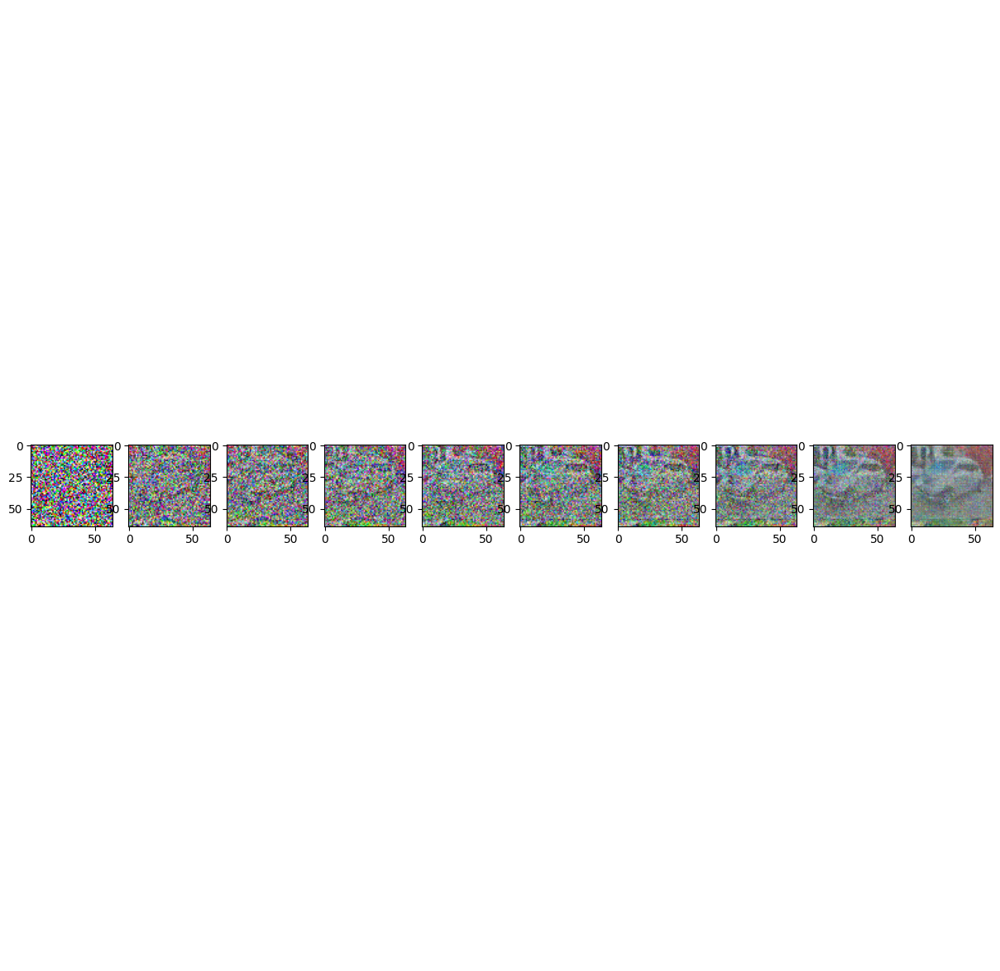

Epoch 101 started
Epoch 102 started
Epoch 103 started
Epoch 104 started
Epoch 105 started
Loss: 0.12152387946844101


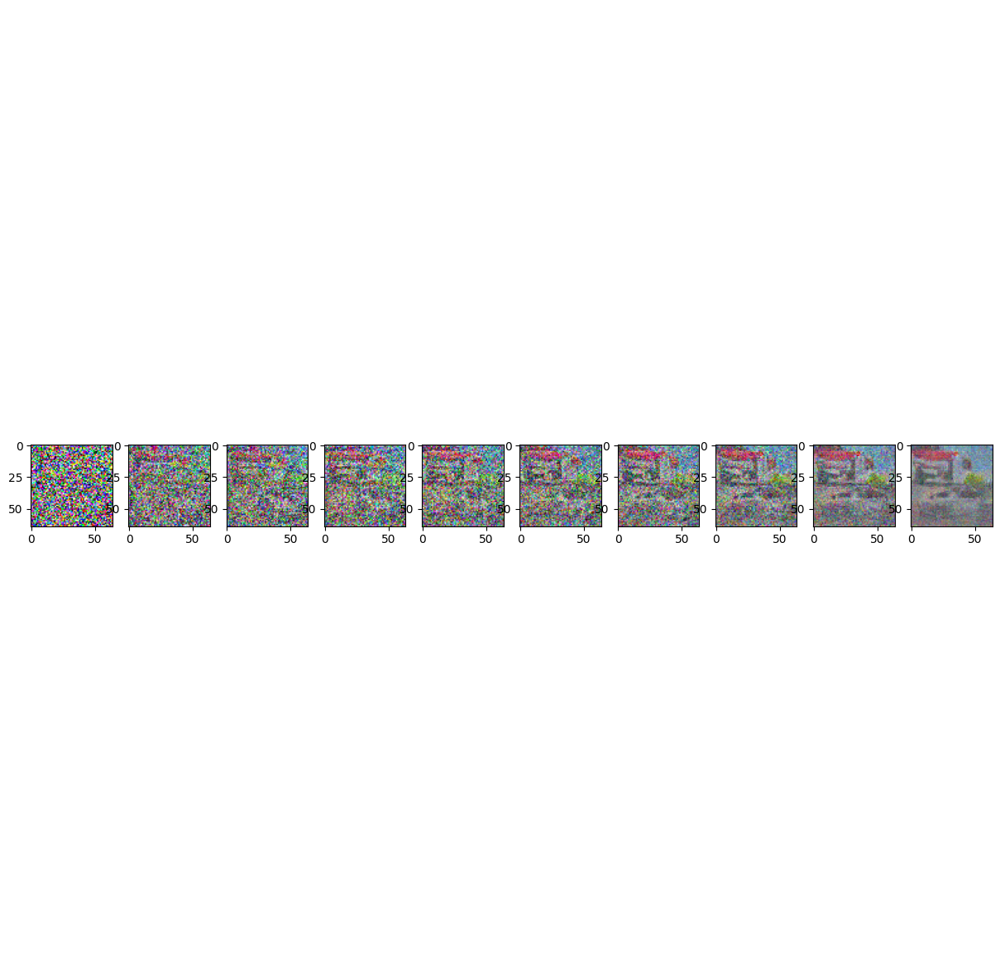

Epoch 106 started
Epoch 107 started
Epoch 108 started
Epoch 109 started
Epoch 110 started
Loss: 0.13917331397533417


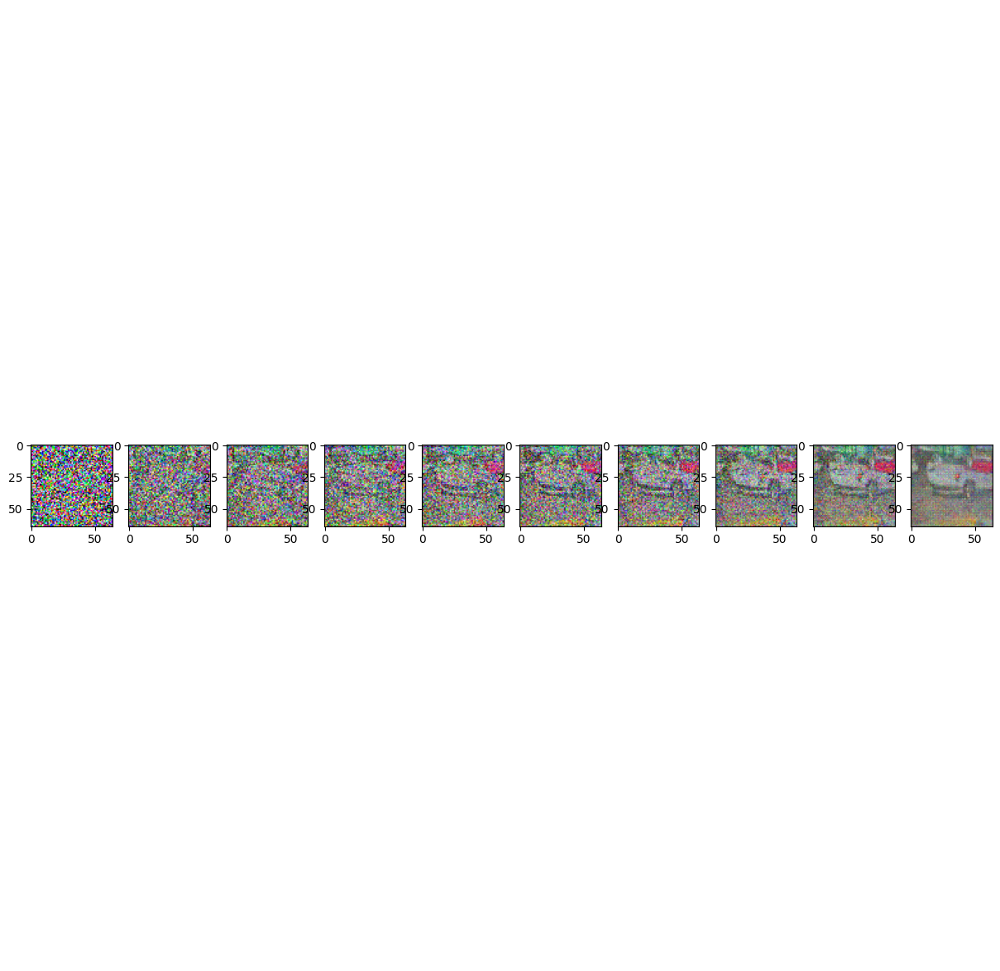

Epoch 111 started
Epoch 112 started
Epoch 113 started
Epoch 114 started
Epoch 115 started
Loss: 0.1241312026977539


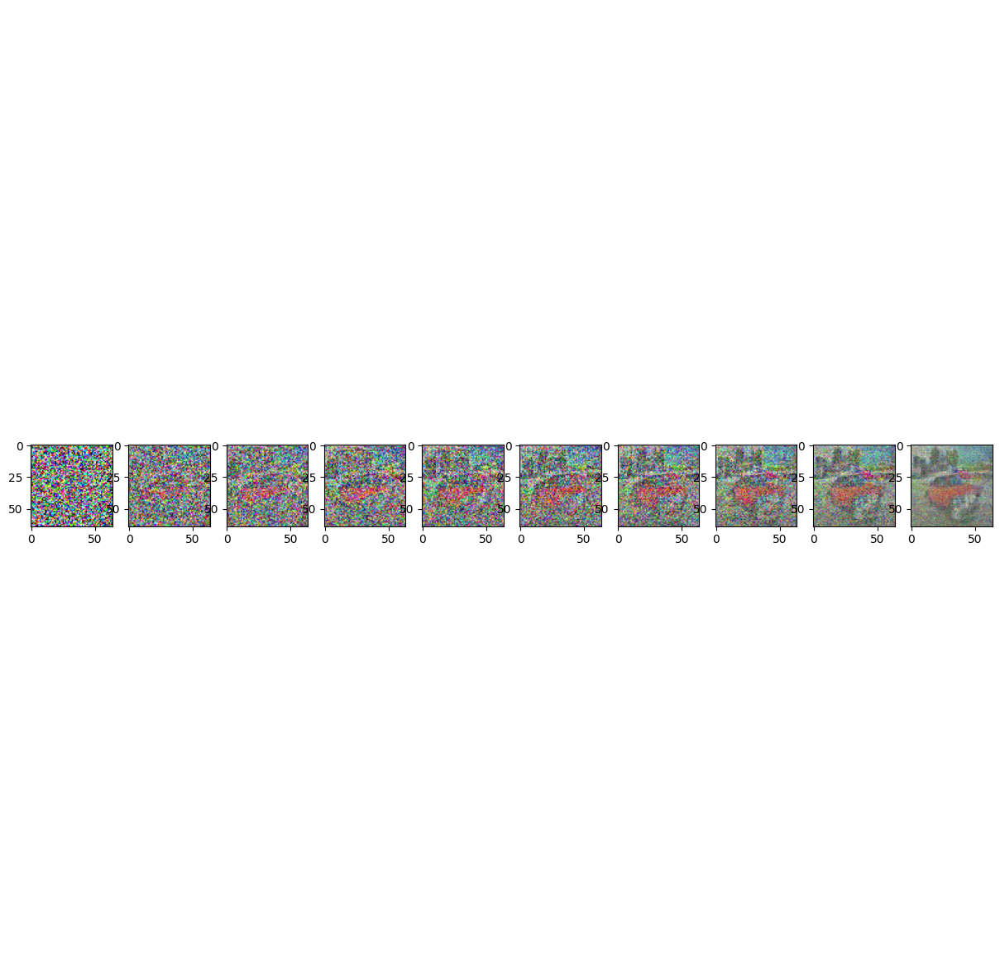

Epoch 116 started
Epoch 117 started
Epoch 118 started
Epoch 119 started
Epoch 120 started
Loss: 0.12848156690597534


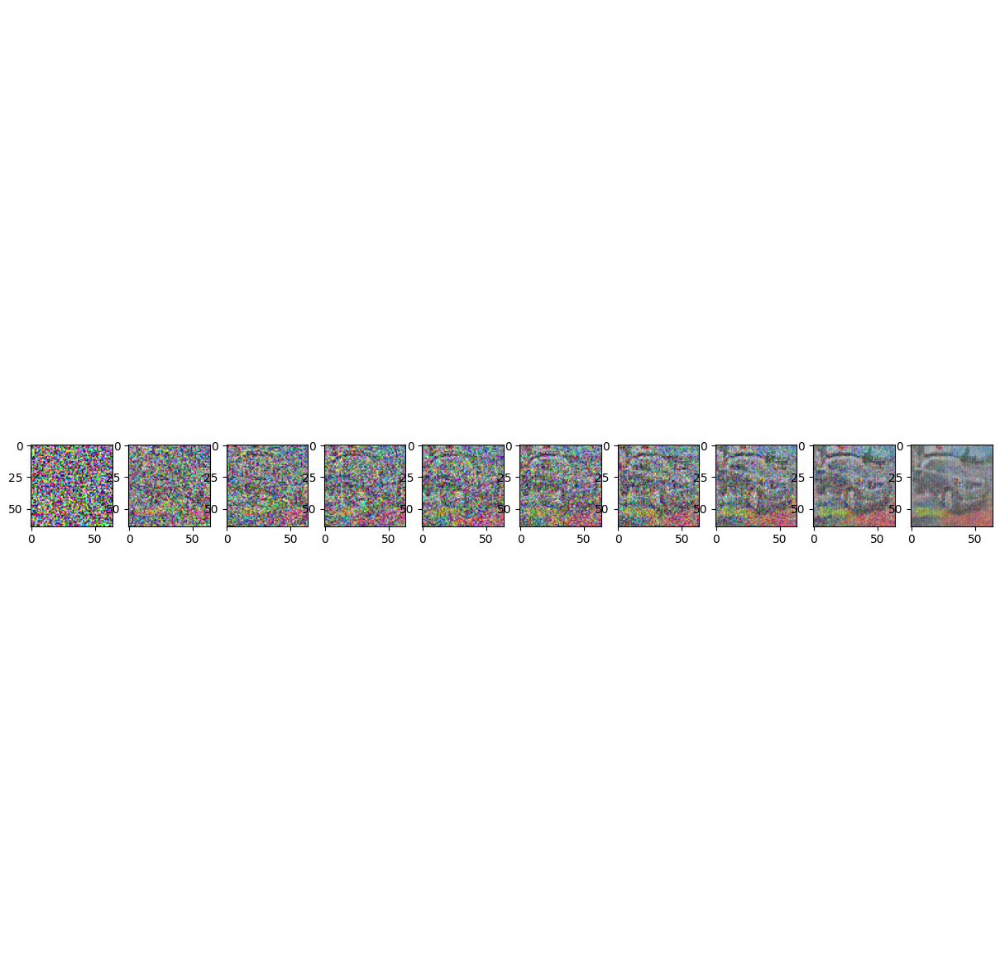

Epoch 121 started
Epoch 122 started
Epoch 123 started
Epoch 124 started
Epoch 125 started
Loss: 0.11282707750797272


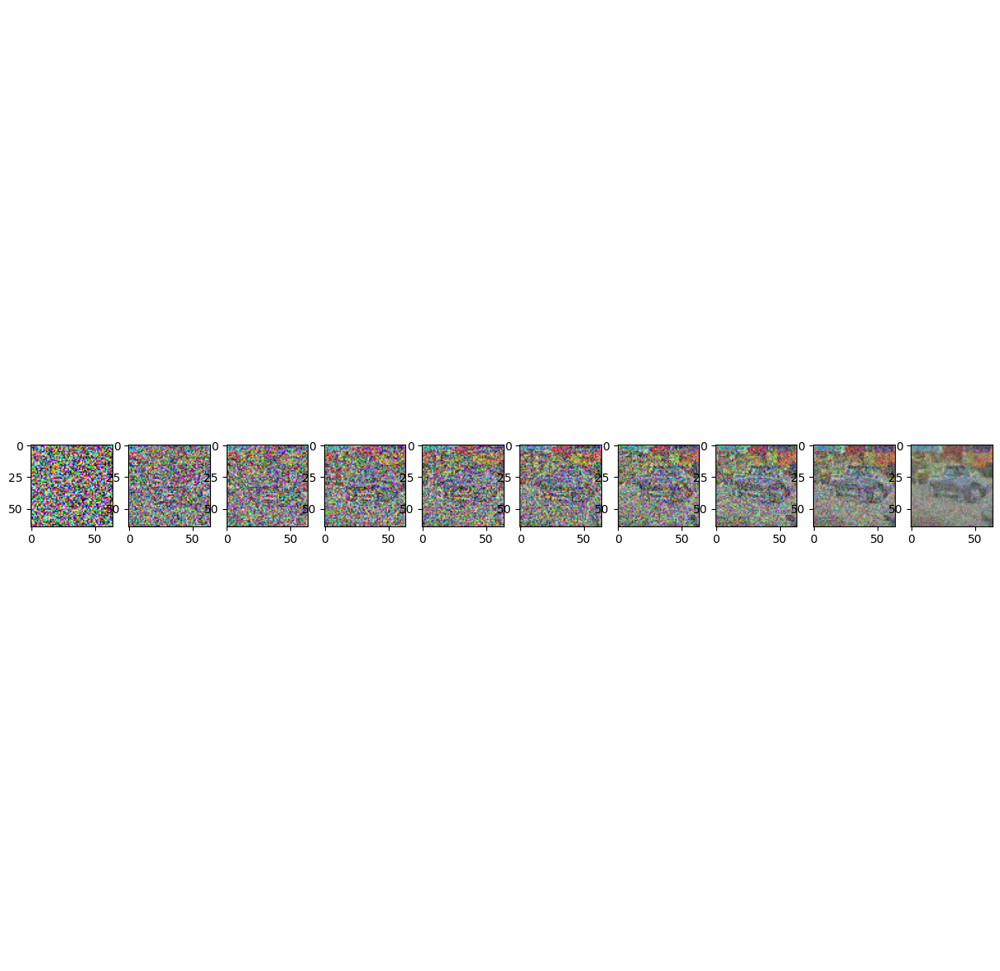

Epoch 126 started
Epoch 127 started
Epoch 128 started
Epoch 129 started
Epoch 130 started
Loss: 0.12283618748188019


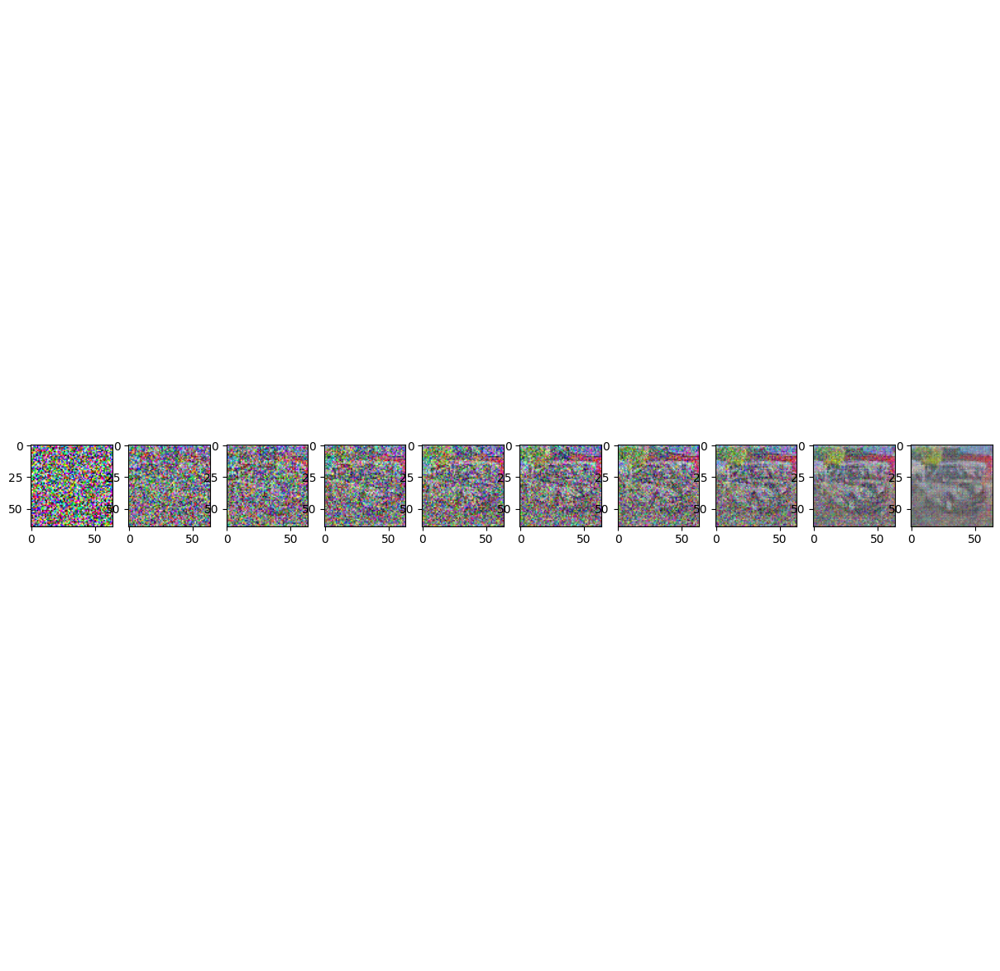

Epoch 131 started
Epoch 132 started
Epoch 133 started
Epoch 134 started
Epoch 135 started
Loss: 0.11767628788948059


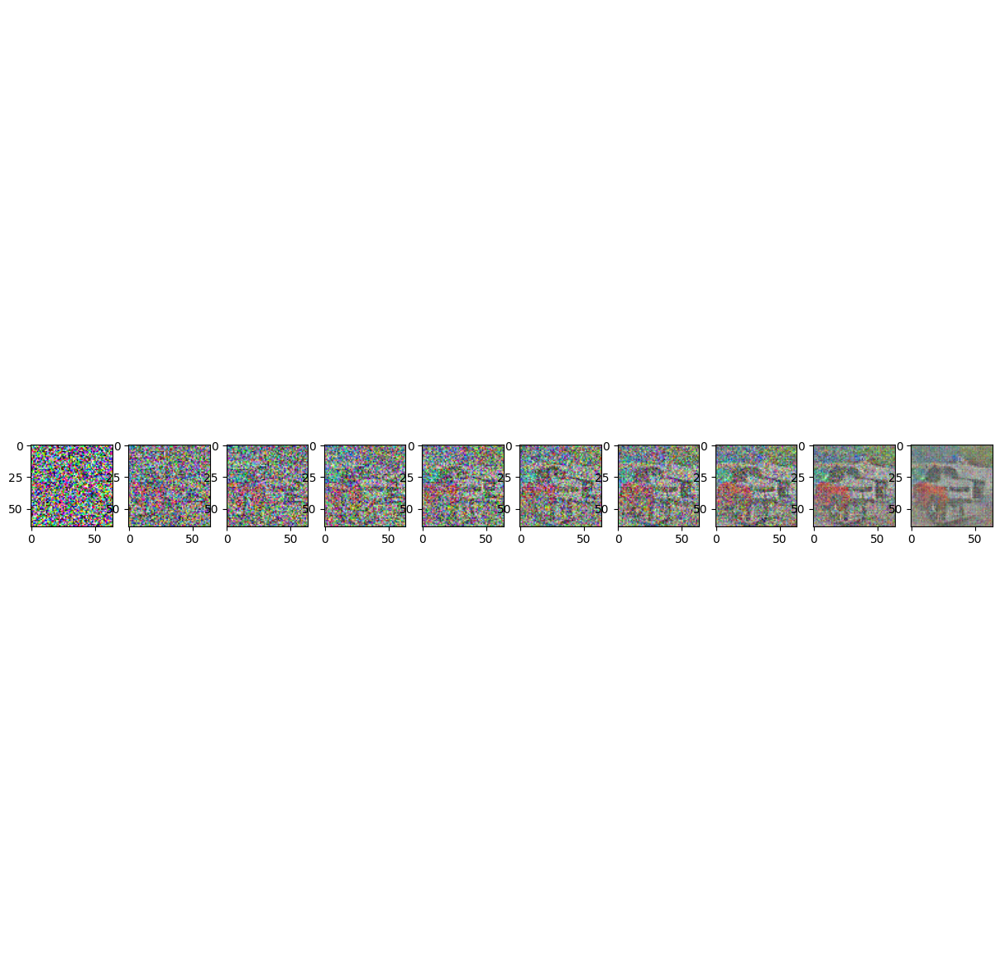

Epoch 136 started
Epoch 137 started
Epoch 138 started
Epoch 139 started
Epoch 140 started
Loss: 0.11539112031459808


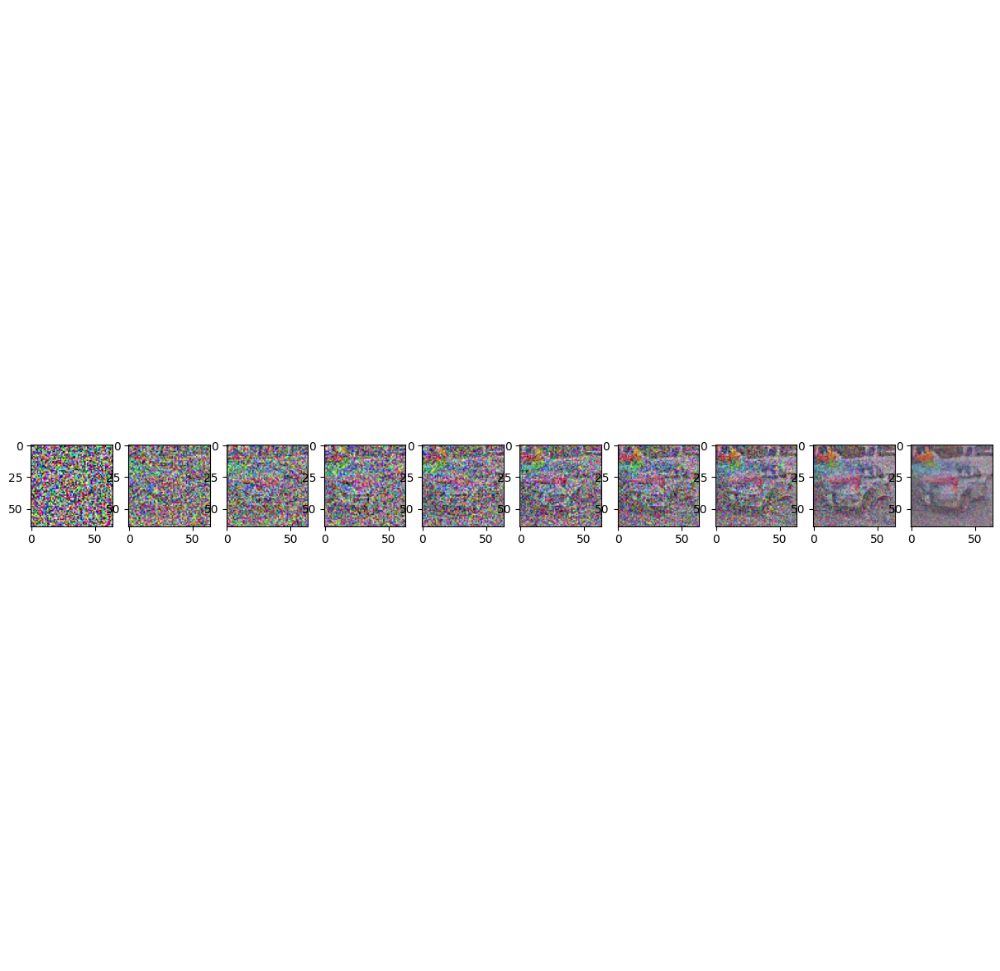

Epoch 141 started
Epoch 142 started
Epoch 143 started
Epoch 144 started
Epoch 145 started
Loss: 0.12864463031291962


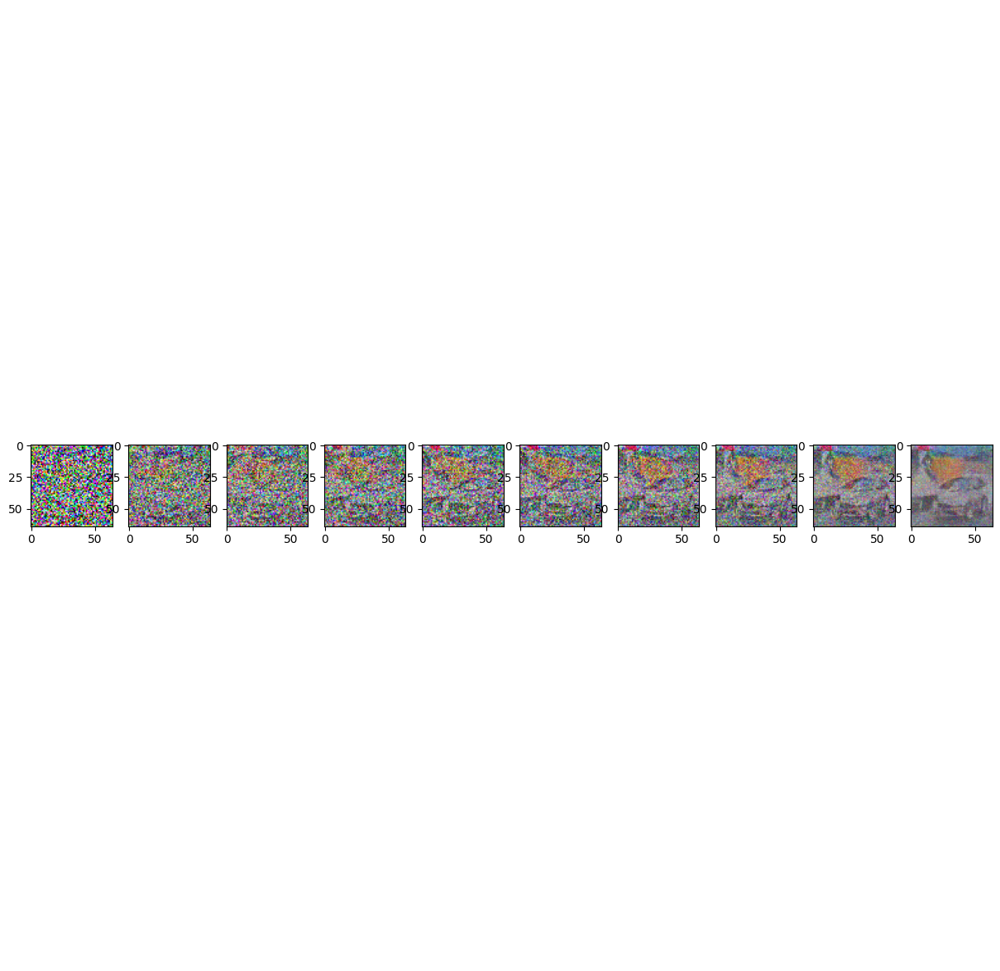

Epoch 146 started
Epoch 147 started
Epoch 148 started
Epoch 149 started
Epoch 150 started
Loss: 0.12868404388427734


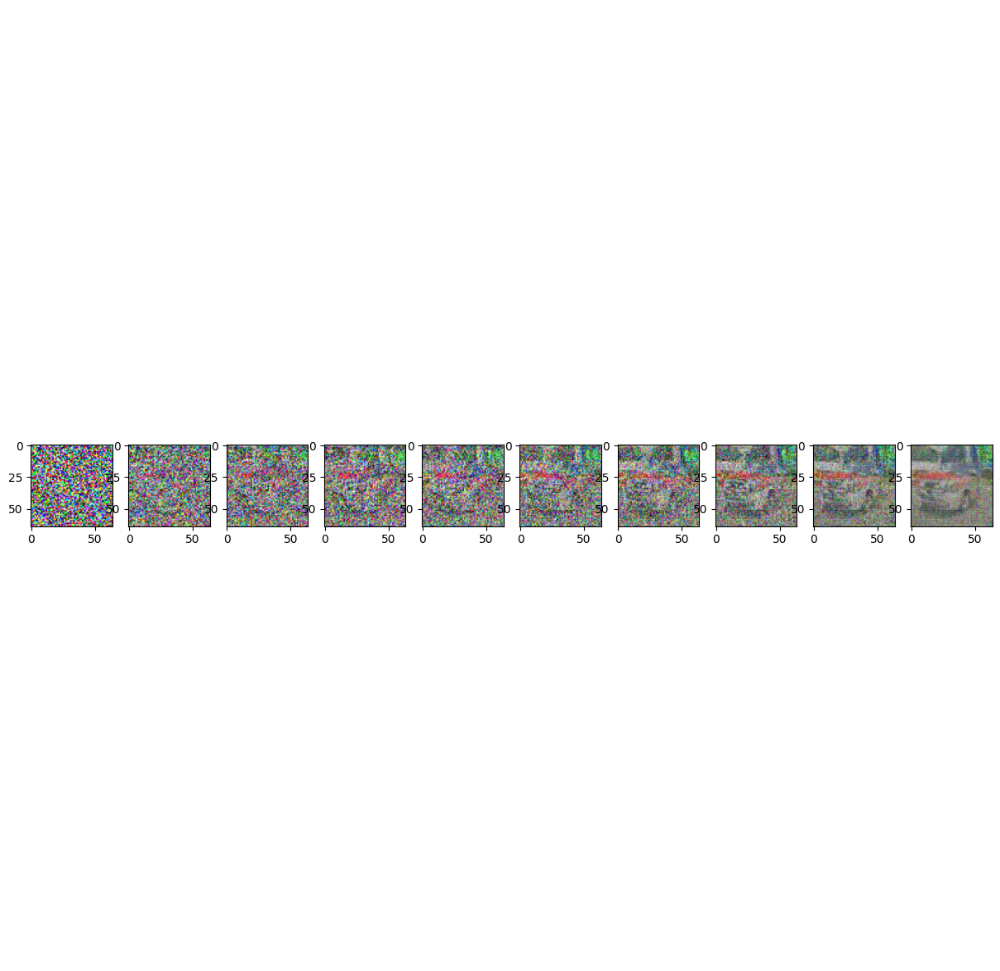

Epoch 151 started
Epoch 152 started
Epoch 153 started
Epoch 154 started
Epoch 155 started
Loss: 0.1224447637796402


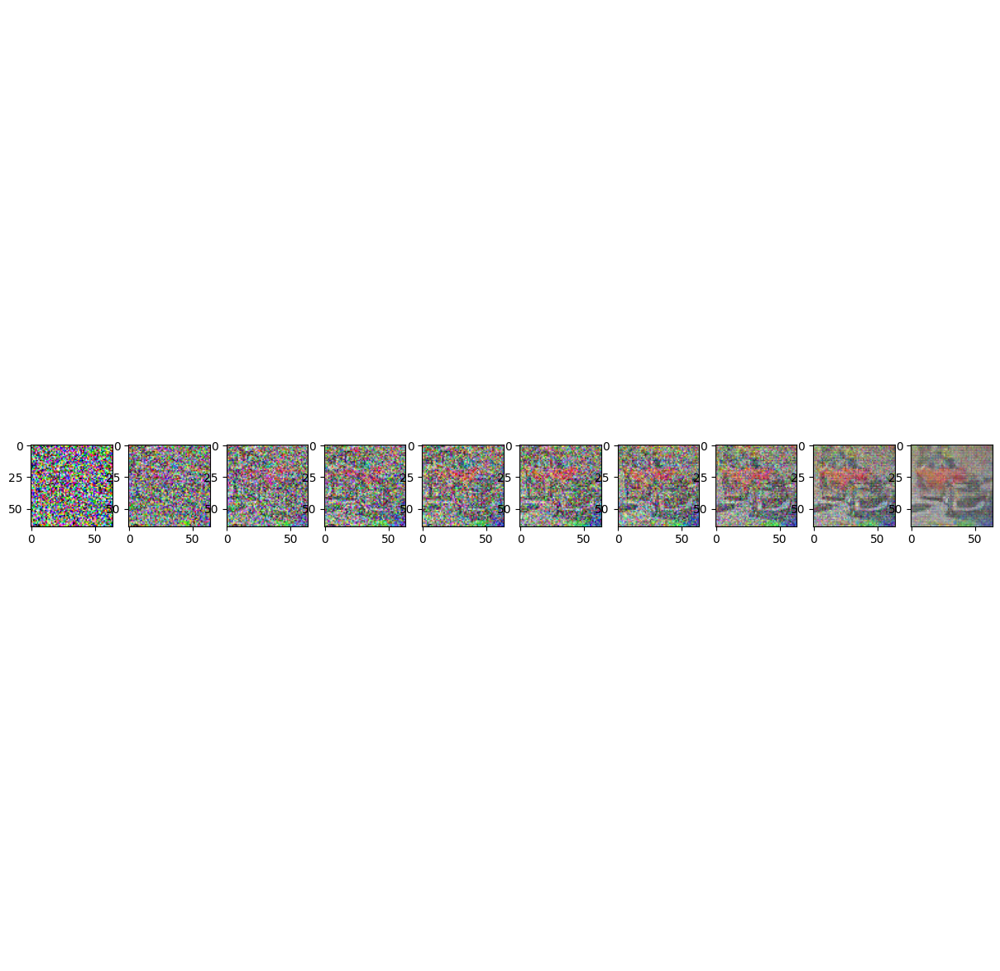

Epoch 156 started
Epoch 157 started
Epoch 158 started
Epoch 159 started
Epoch 160 started
Loss: 0.11166628450155258


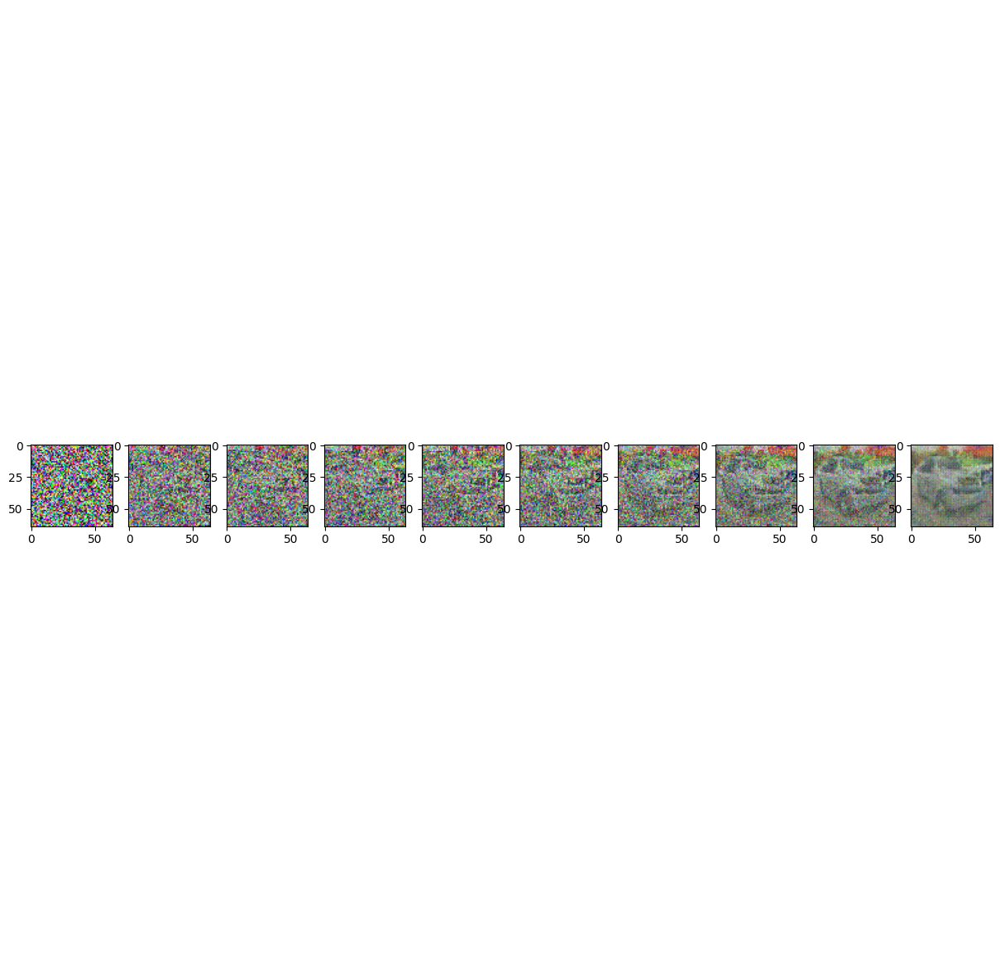

Epoch 161 started
Epoch 162 started
Epoch 163 started
Epoch 164 started
Epoch 165 started
Loss: 0.11654558032751083


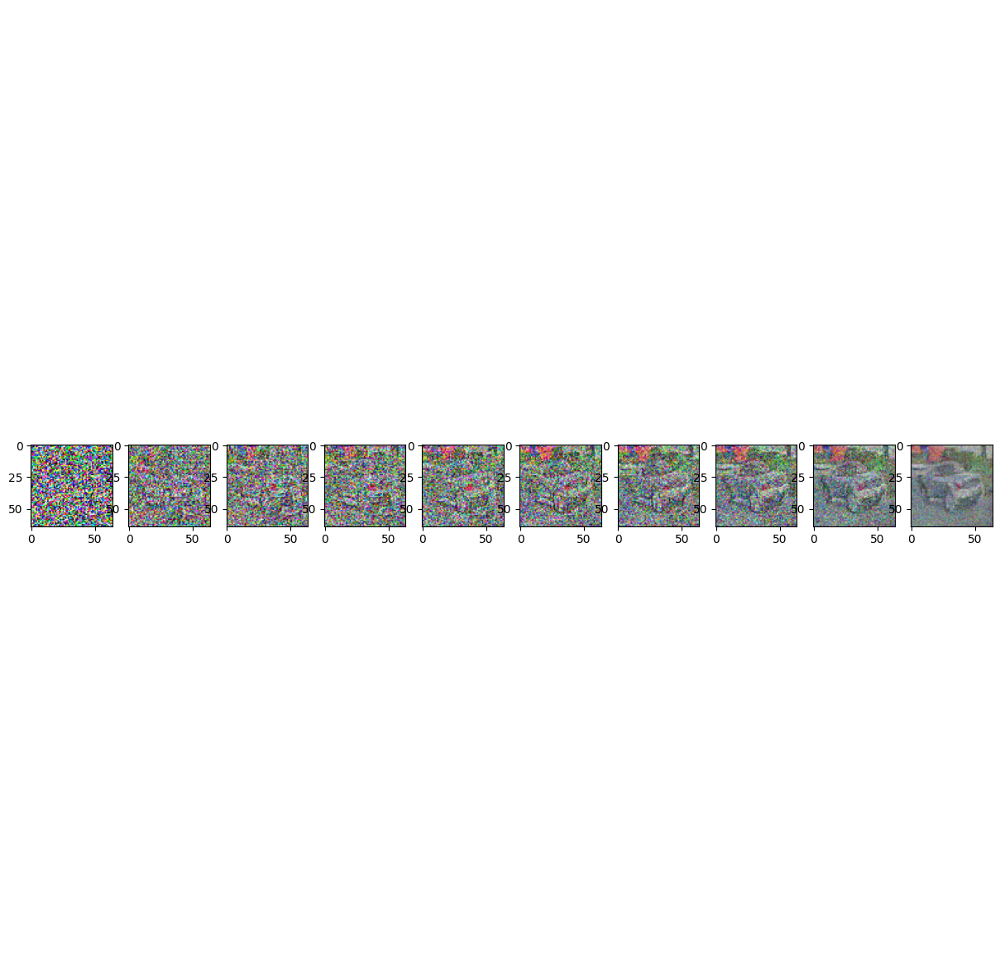

Epoch 166 started
Epoch 167 started
Epoch 168 started
Epoch 169 started
Epoch 170 started
Loss: 0.11705636978149414


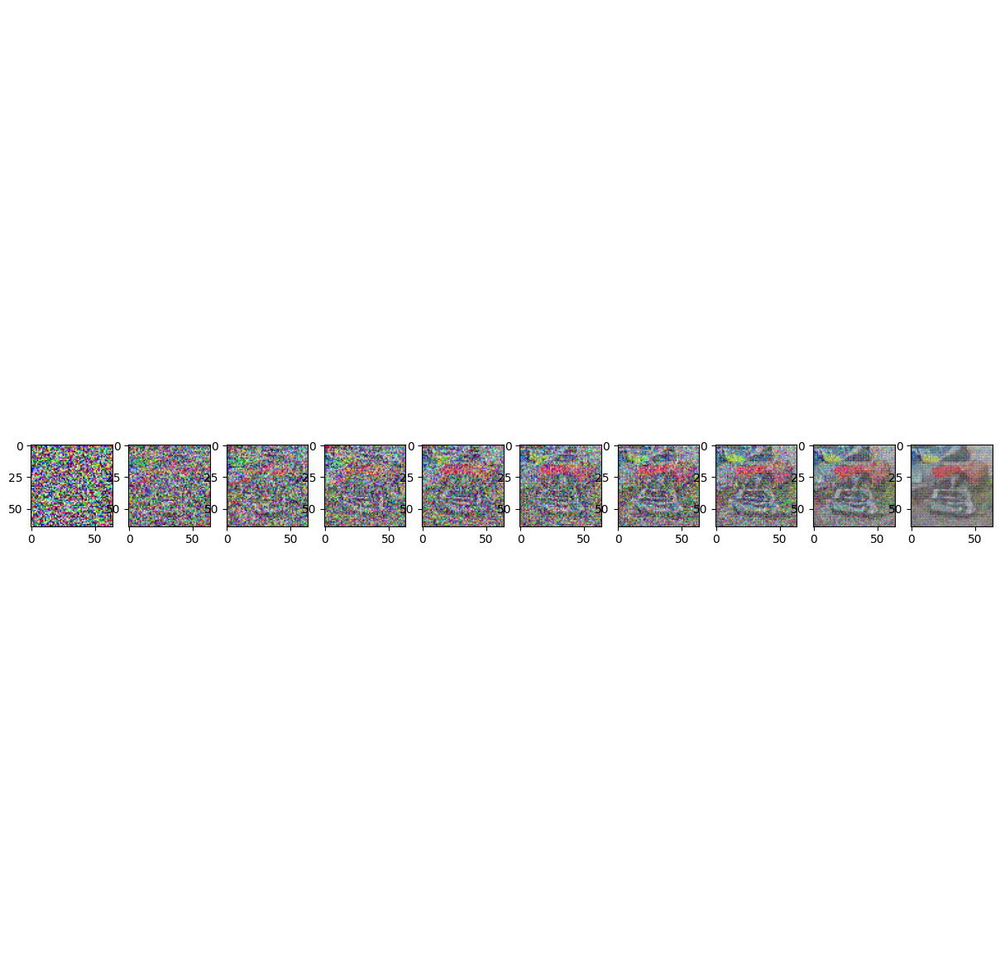

Epoch 171 started
Epoch 172 started
Epoch 173 started
Epoch 174 started
Epoch 175 started
Loss: 0.11863018572330475


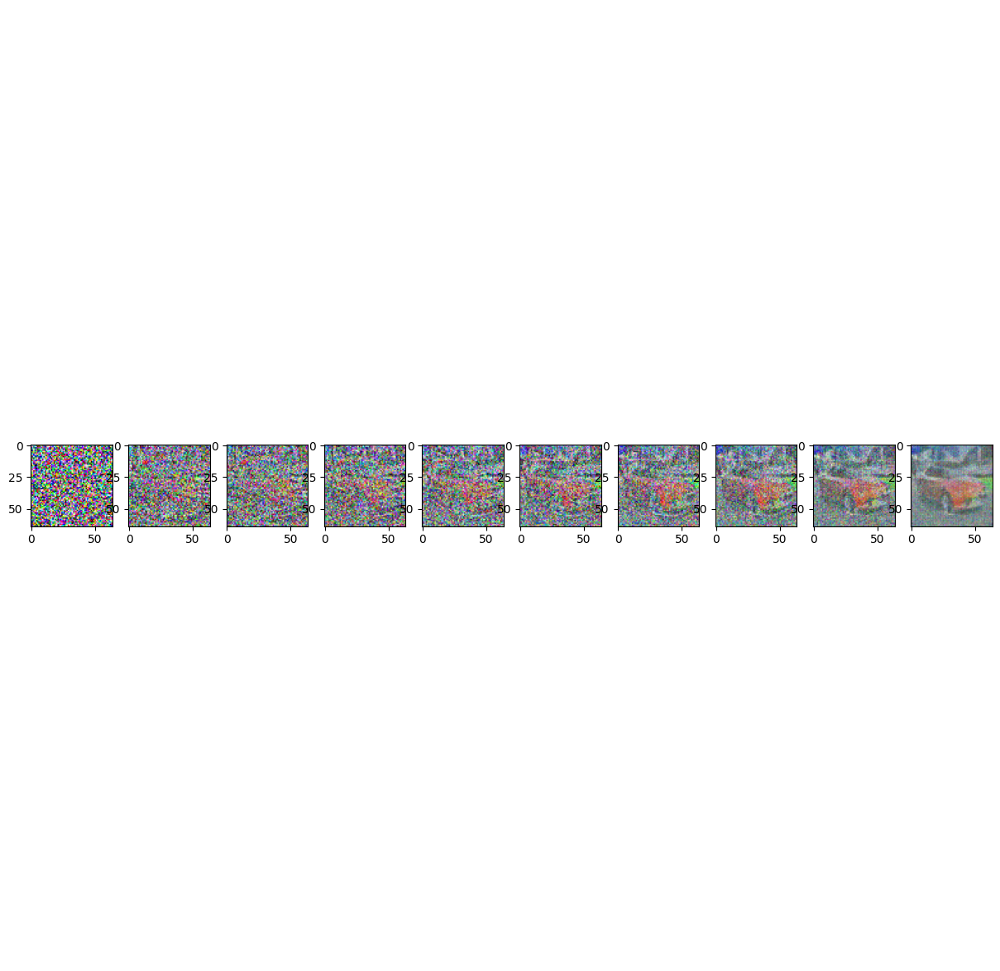

Epoch 176 started
Epoch 177 started
Epoch 178 started
Epoch 179 started
Epoch 180 started
Loss: 0.12569260597229004


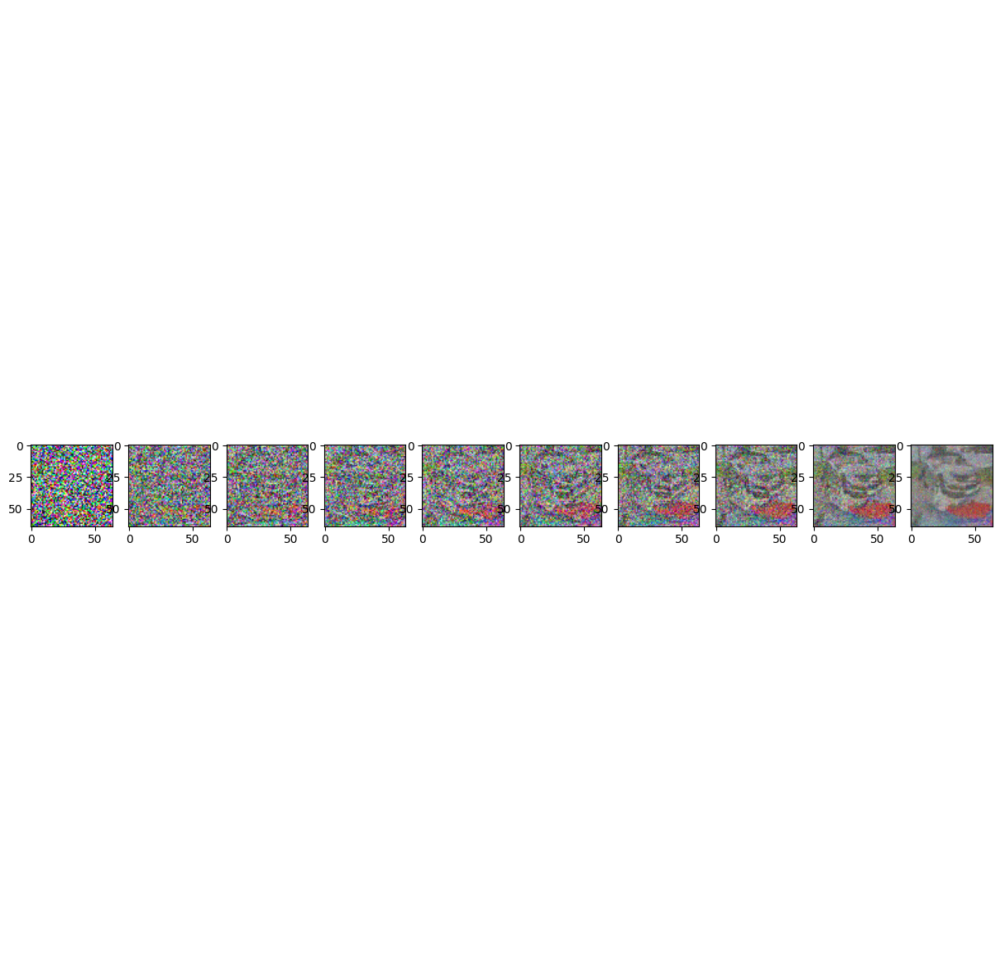

Epoch 181 started
Epoch 182 started
Epoch 183 started
Epoch 184 started
Epoch 185 started
Loss: 0.13710710406303406


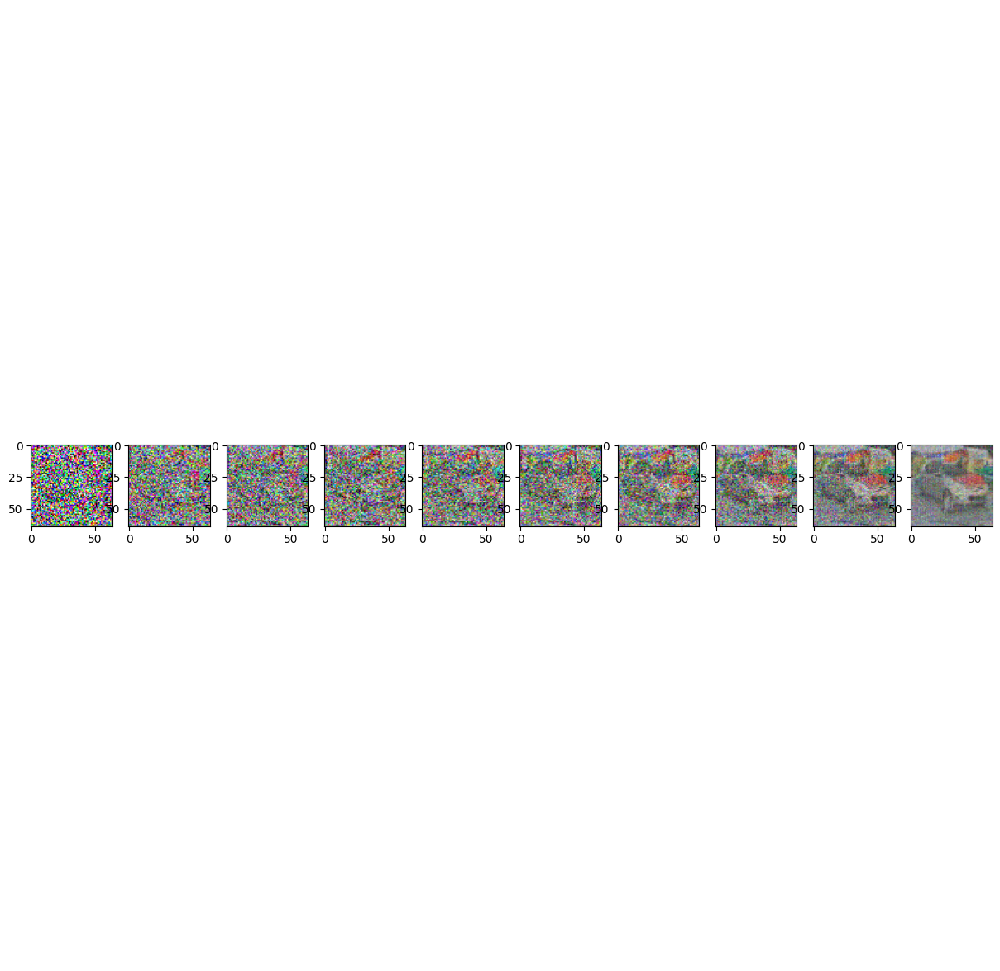

Epoch 186 started
Epoch 187 started
Epoch 188 started
Epoch 189 started
Epoch 190 started
Loss: 0.1258072853088379


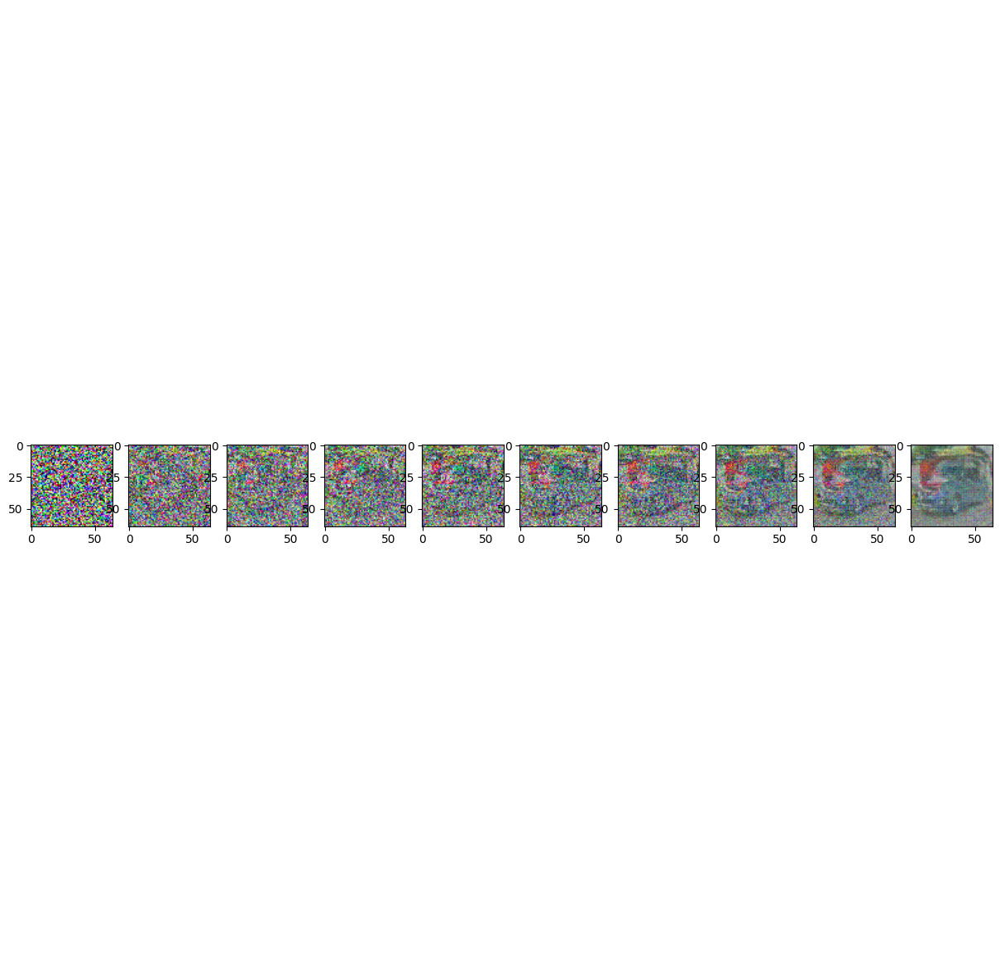

Epoch 191 started
Epoch 192 started
Epoch 193 started
Epoch 194 started
Epoch 195 started
Loss: 0.12824797630310059


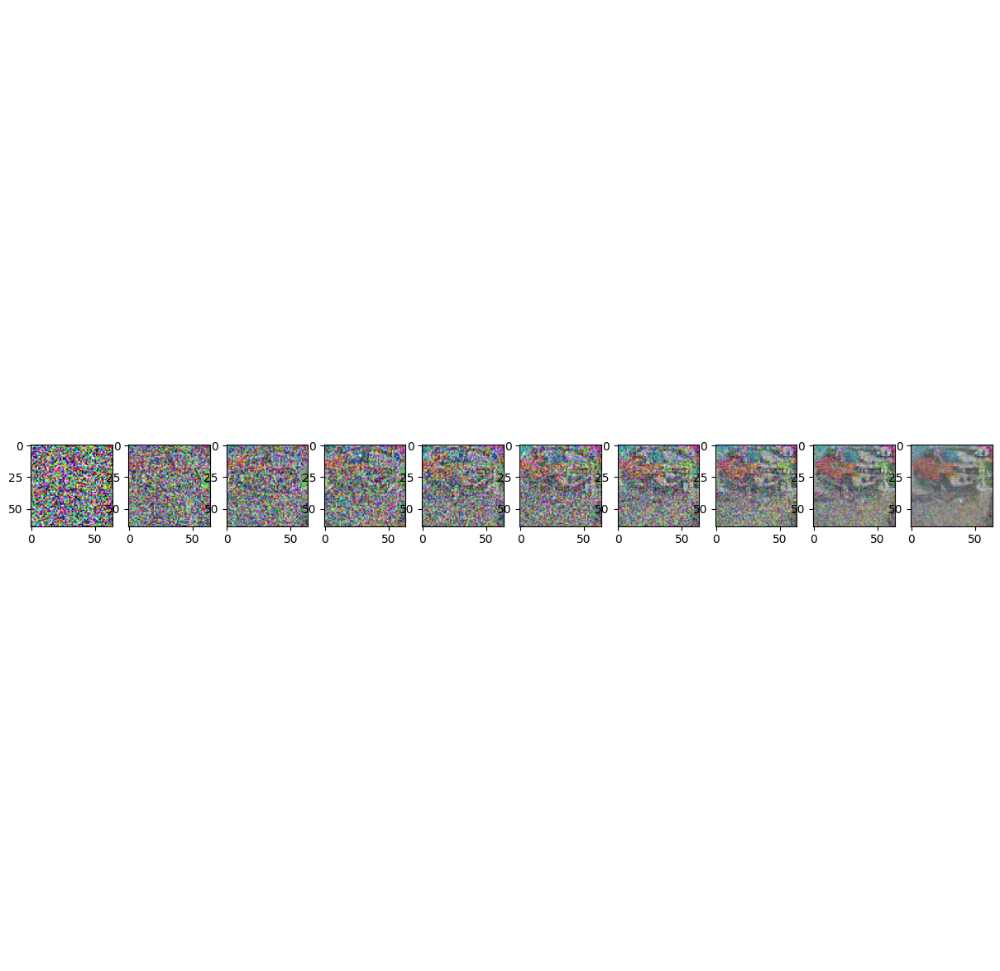

Epoch 196 started
Epoch 197 started
Epoch 198 started
Epoch 199 started
Epoch 200 started
Loss: 0.1338130533695221


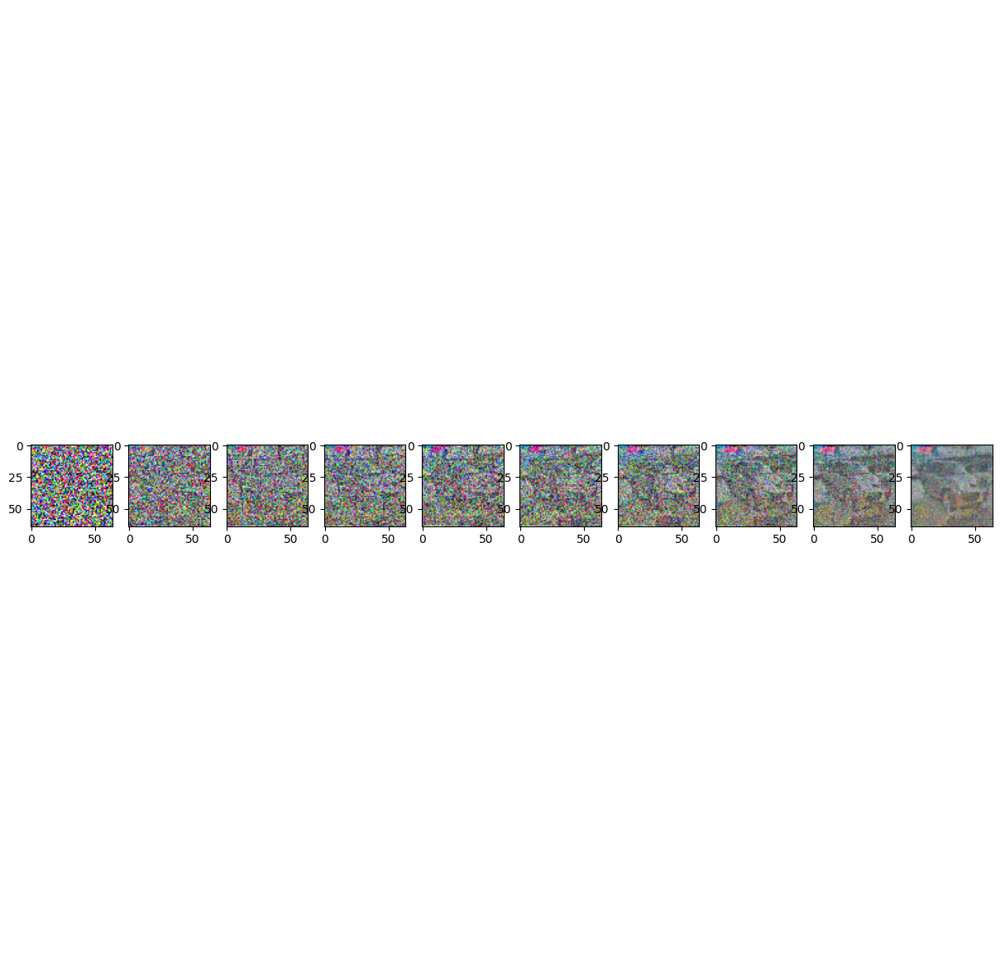

Epoch 201 started
Epoch 202 started
Epoch 203 started
Epoch 204 started
Epoch 205 started
Loss: 0.13795945048332214


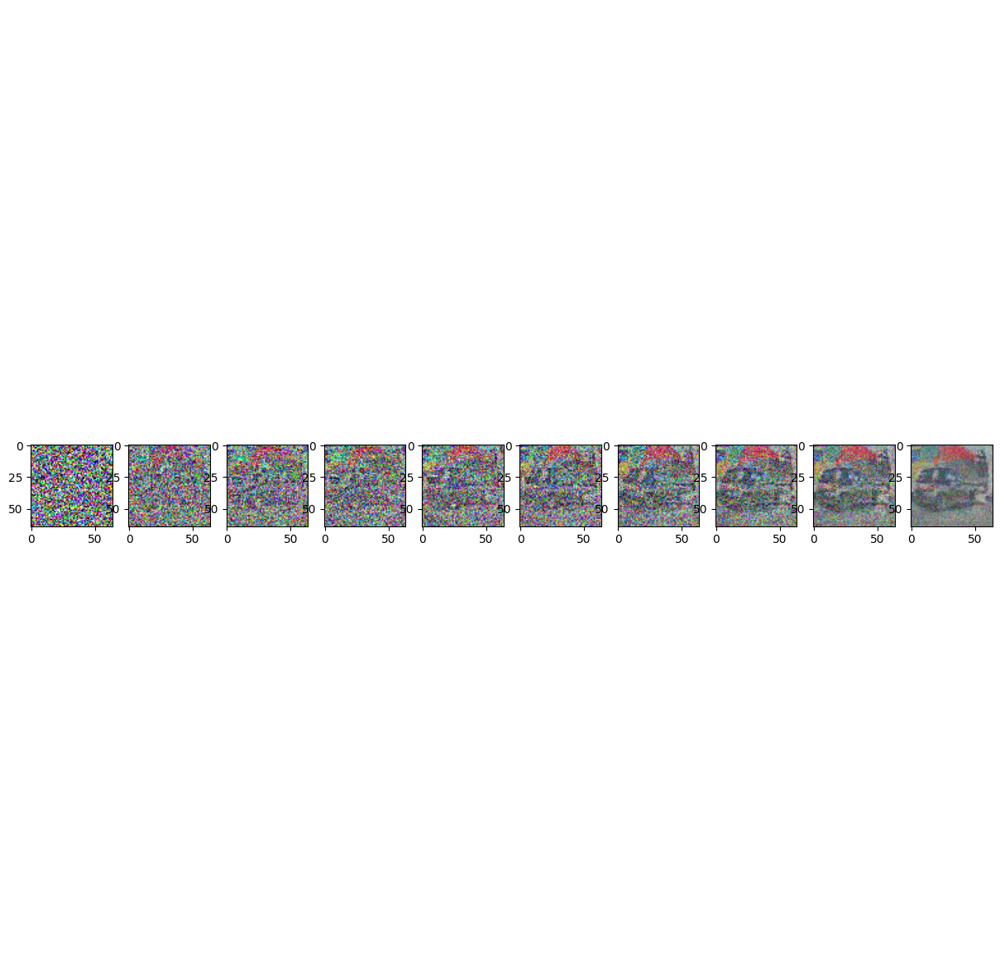

Epoch 206 started
Epoch 207 started
Epoch 208 started
Epoch 209 started
Epoch 210 started
Loss: 0.12801676988601685


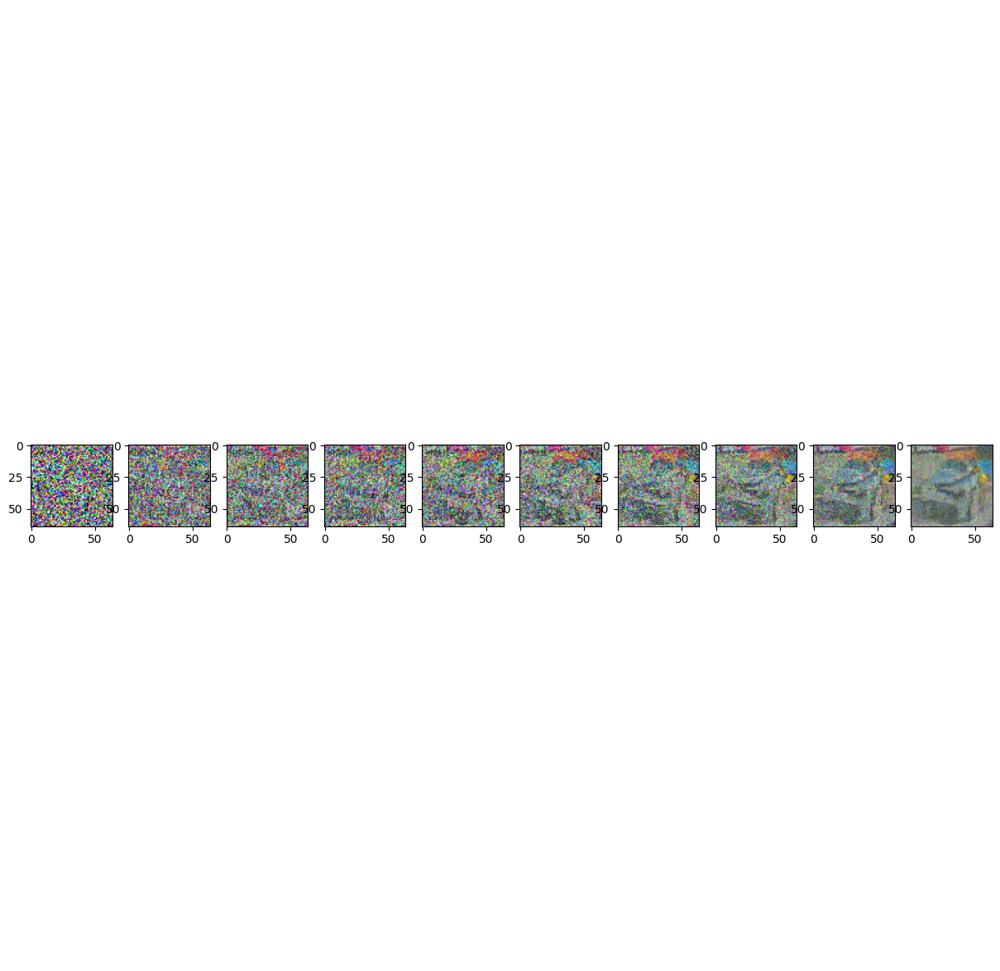

Epoch 211 started
Epoch 212 started
Epoch 213 started
Epoch 214 started
Epoch 215 started
Loss: 0.14509426057338715


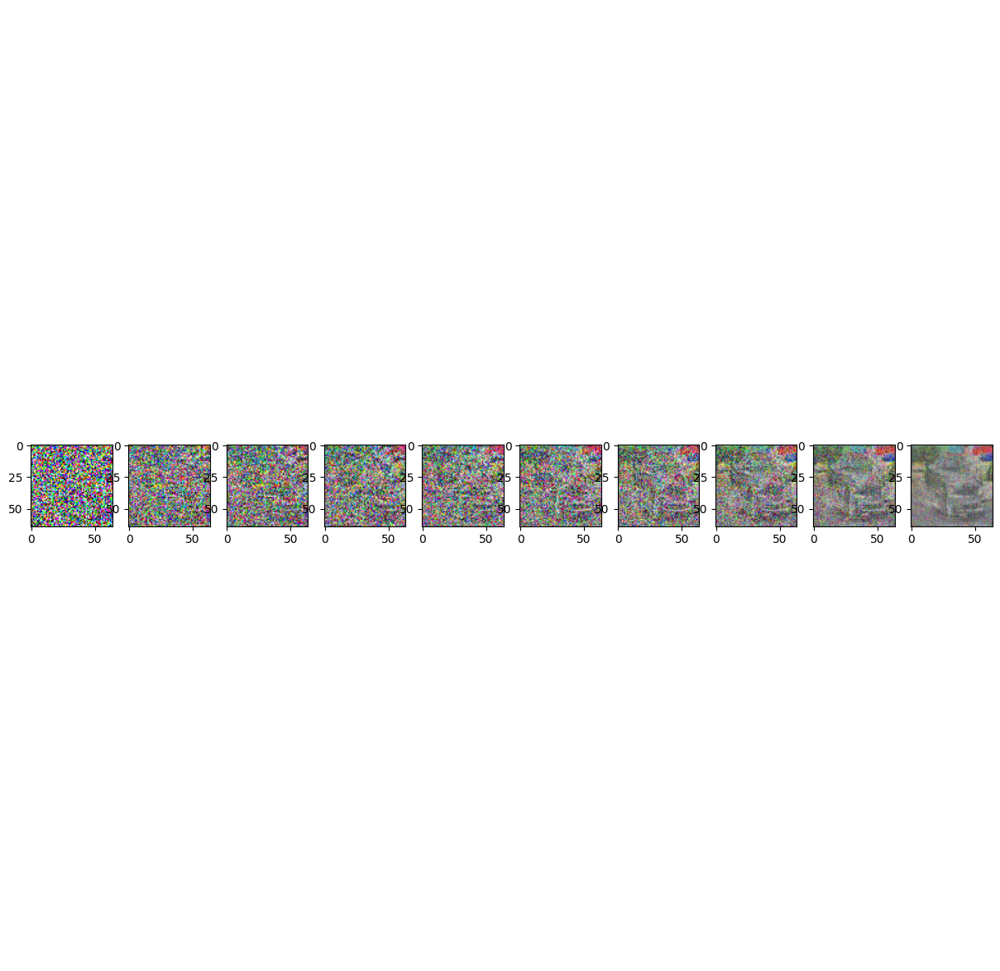

Epoch 216 started
Epoch 217 started
Epoch 218 started
Epoch 219 started
Epoch 220 started
Loss: 0.12431319802999496


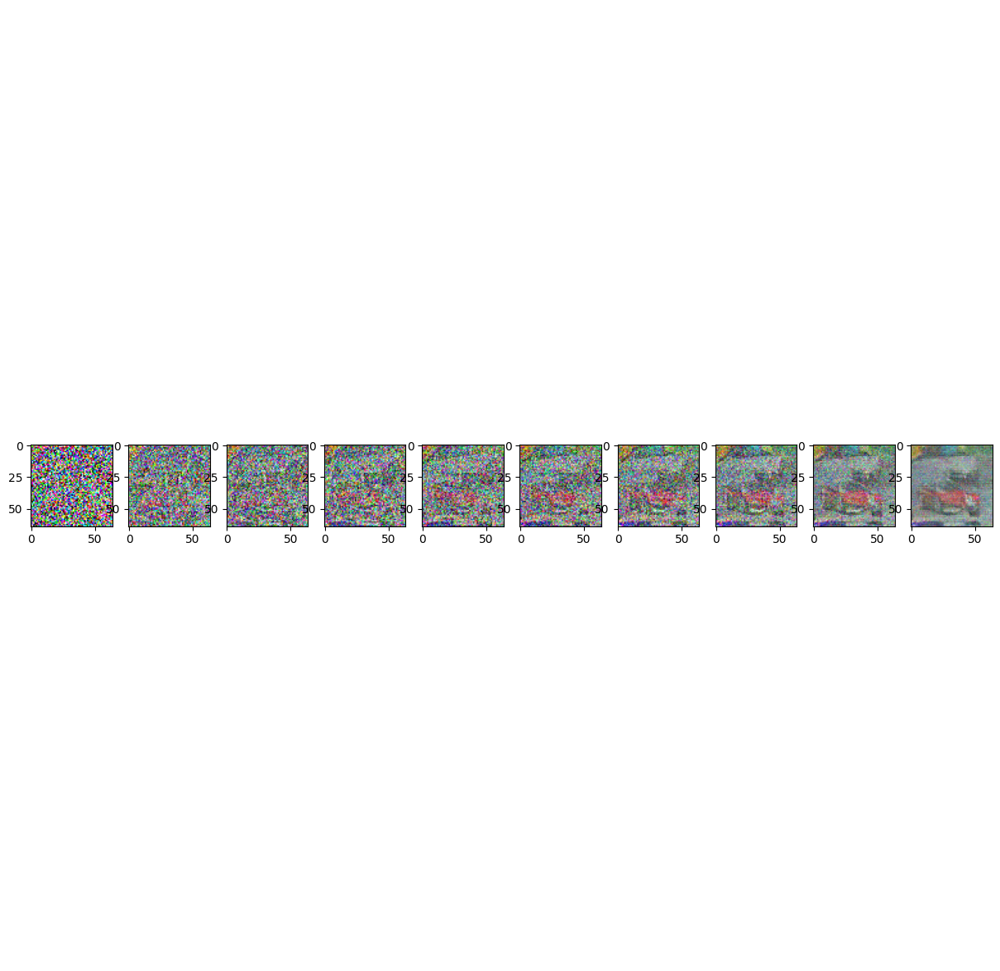

Epoch 221 started
Epoch 222 started
Epoch 223 started
Epoch 224 started
Epoch 225 started
Loss: 0.11945798248052597


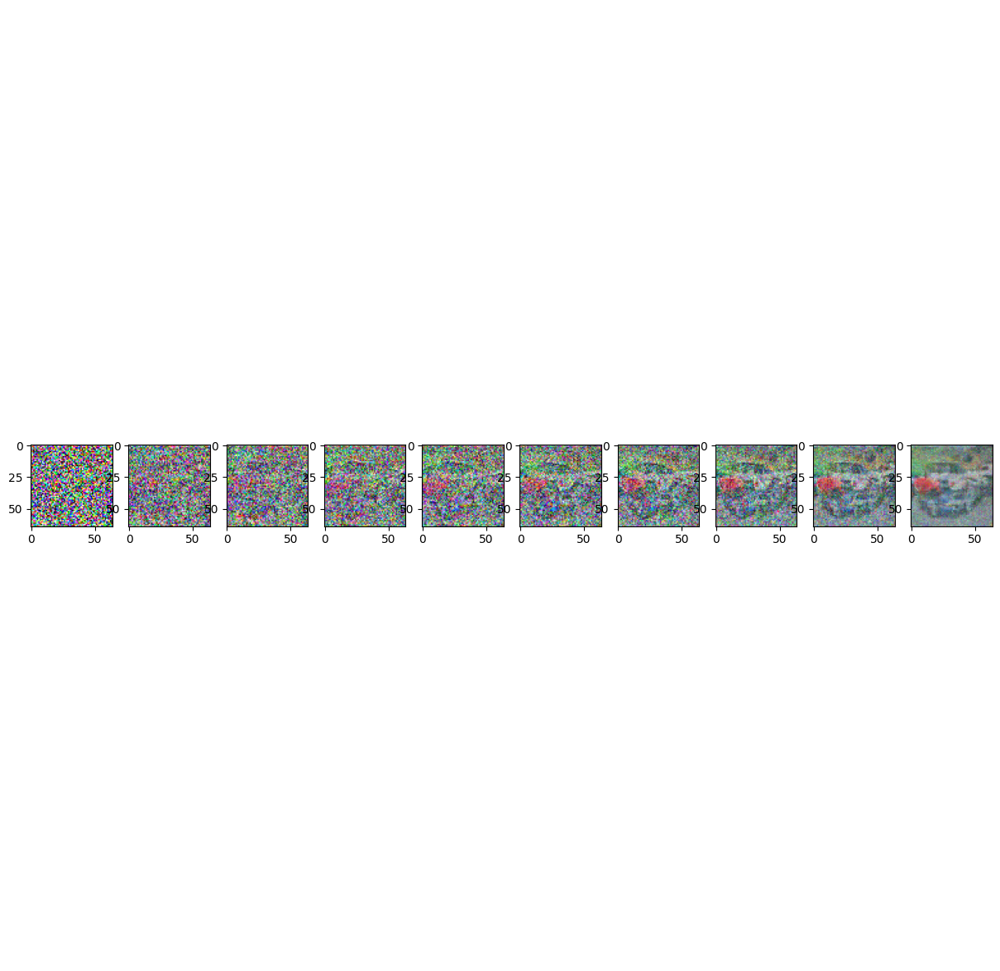

Epoch 226 started
Epoch 227 started
Epoch 228 started
Epoch 229 started
Epoch 230 started
Loss: 0.12621155381202698


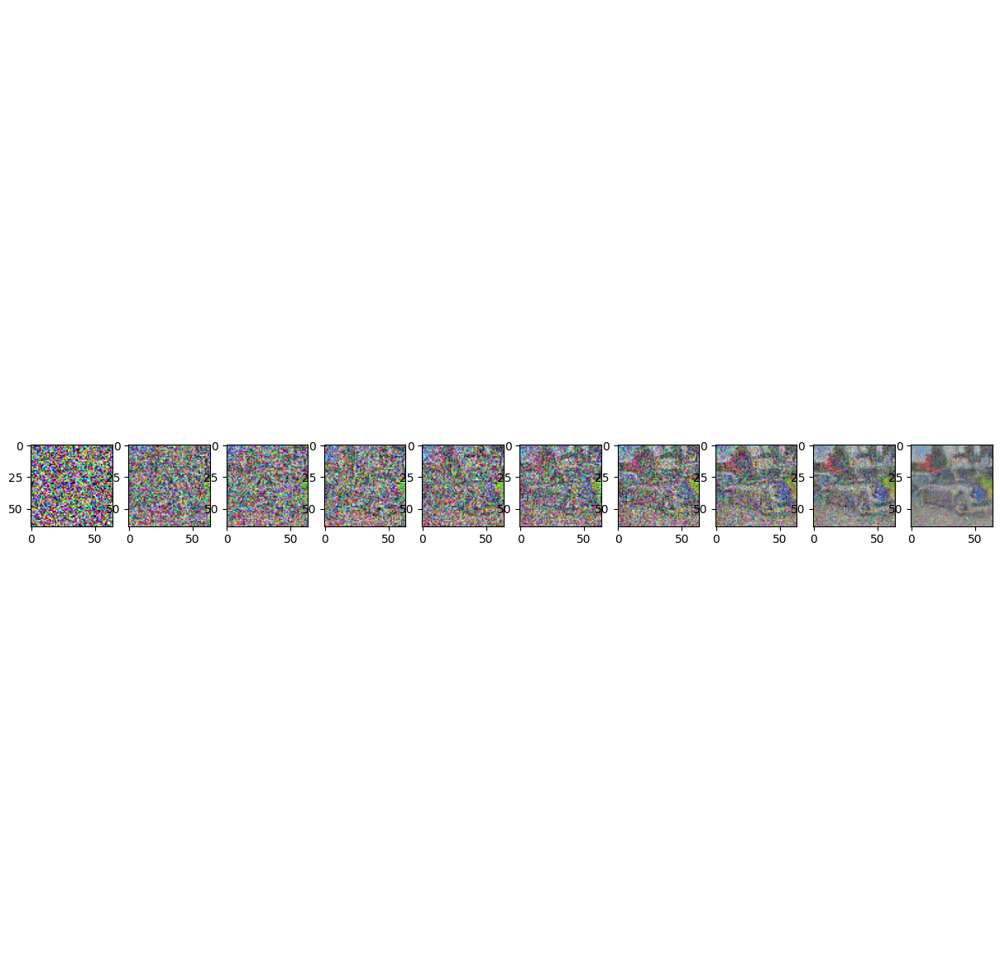

Epoch 231 started
Epoch 232 started
Epoch 233 started
Epoch 234 started
Epoch 235 started
Loss: 0.13069167733192444


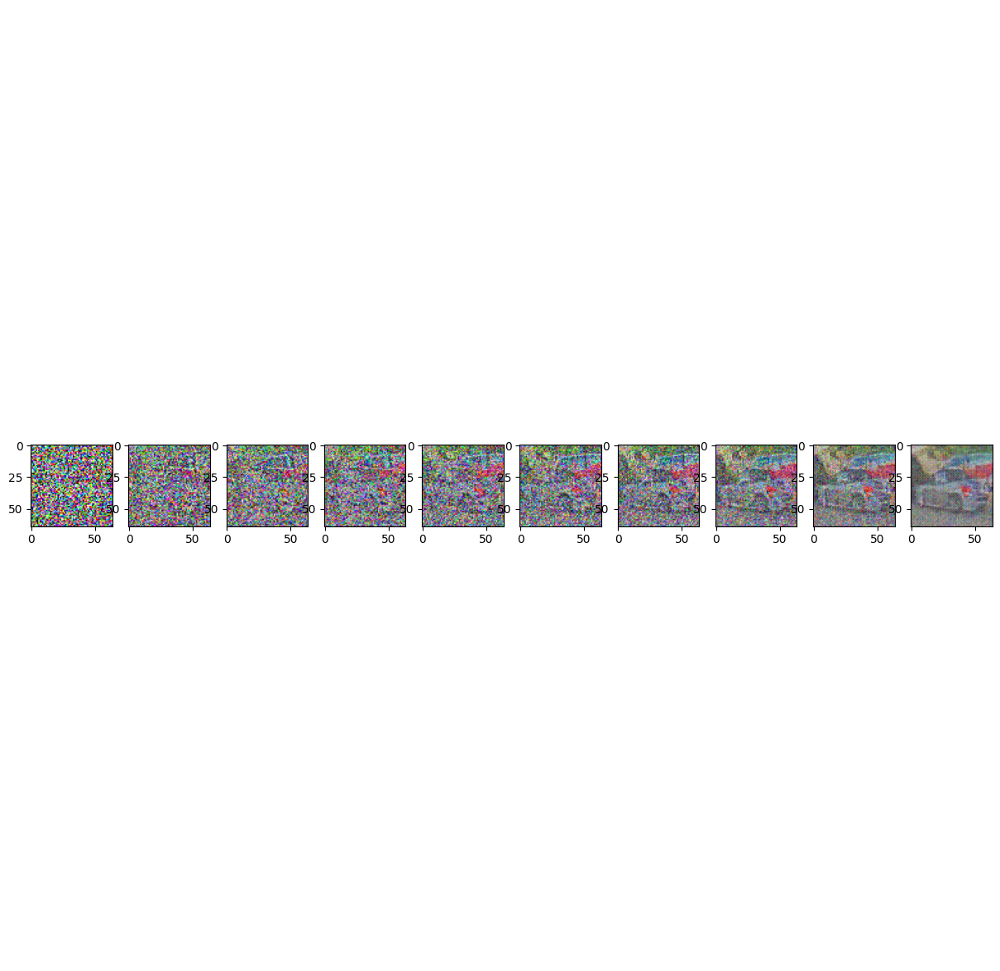

Epoch 236 started
Epoch 237 started
Epoch 238 started
Epoch 239 started
Epoch 240 started
Loss: 0.12552735209465027


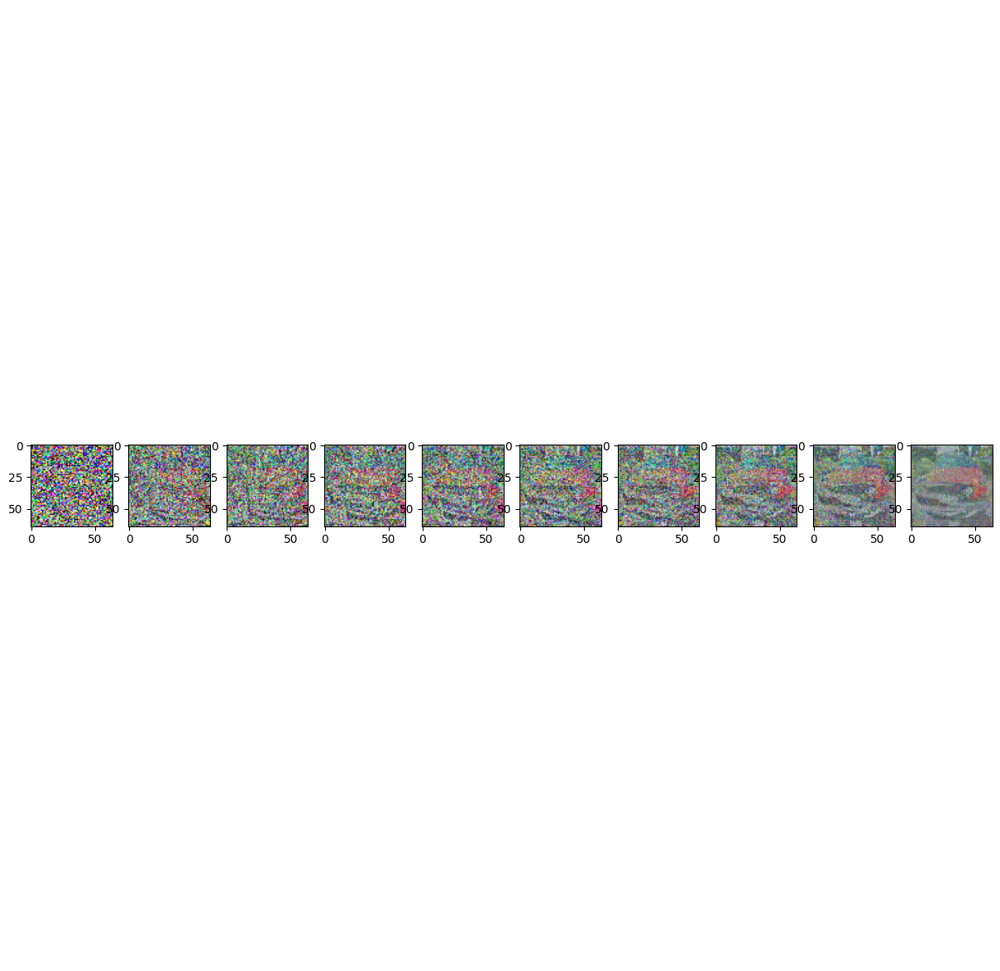

Epoch 241 started
Epoch 242 started
Epoch 243 started
Epoch 244 started
Epoch 245 started
Loss: 0.12581662833690643


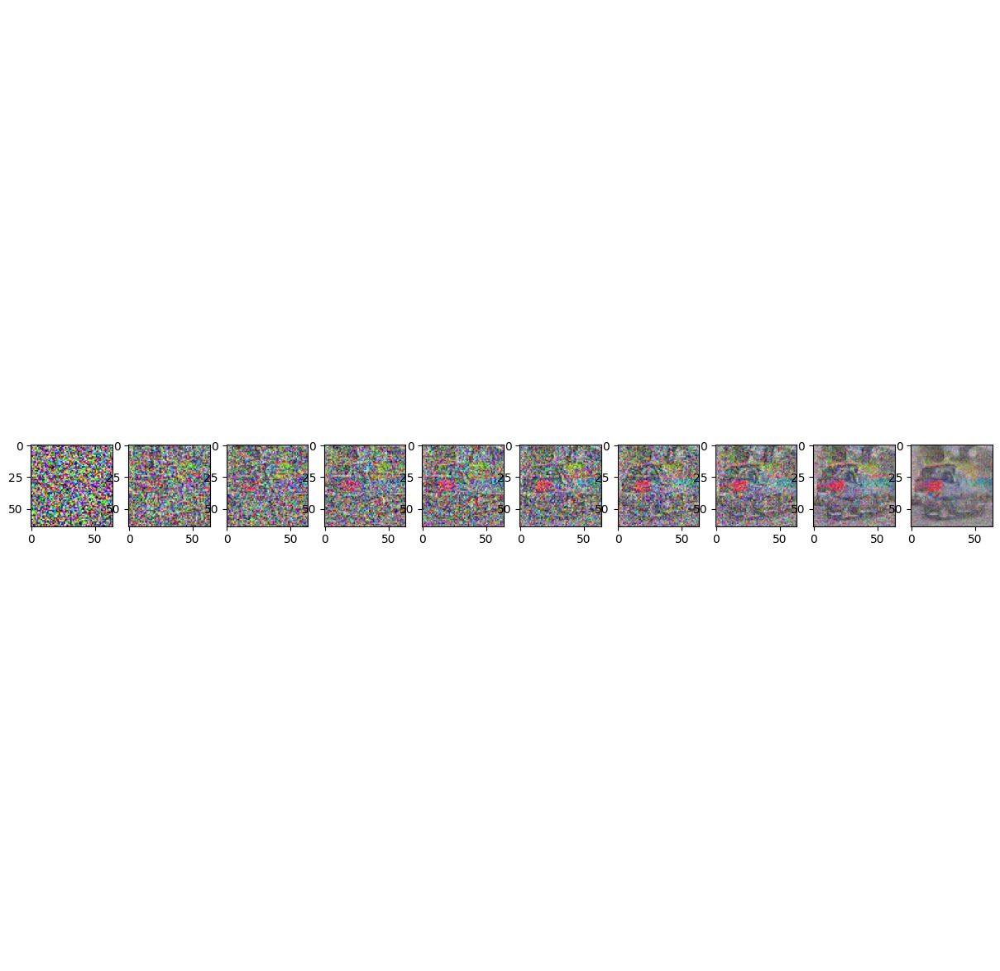

Epoch 246 started
Epoch 247 started
Epoch 248 started
Epoch 249 started
Epoch 250 started
Loss: 0.12466368079185486


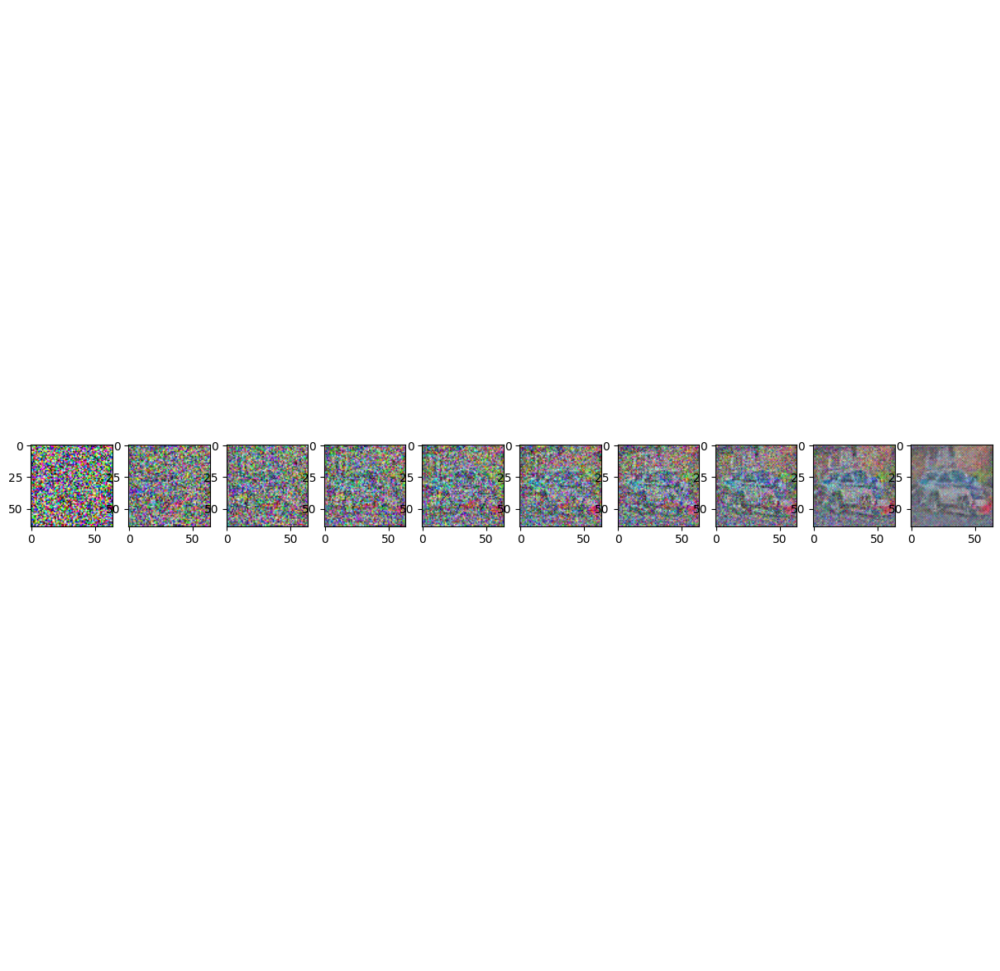

Epoch 251 started
Epoch 252 started
Epoch 253 started
Epoch 254 started
Epoch 255 started
Loss: 0.12456630915403366


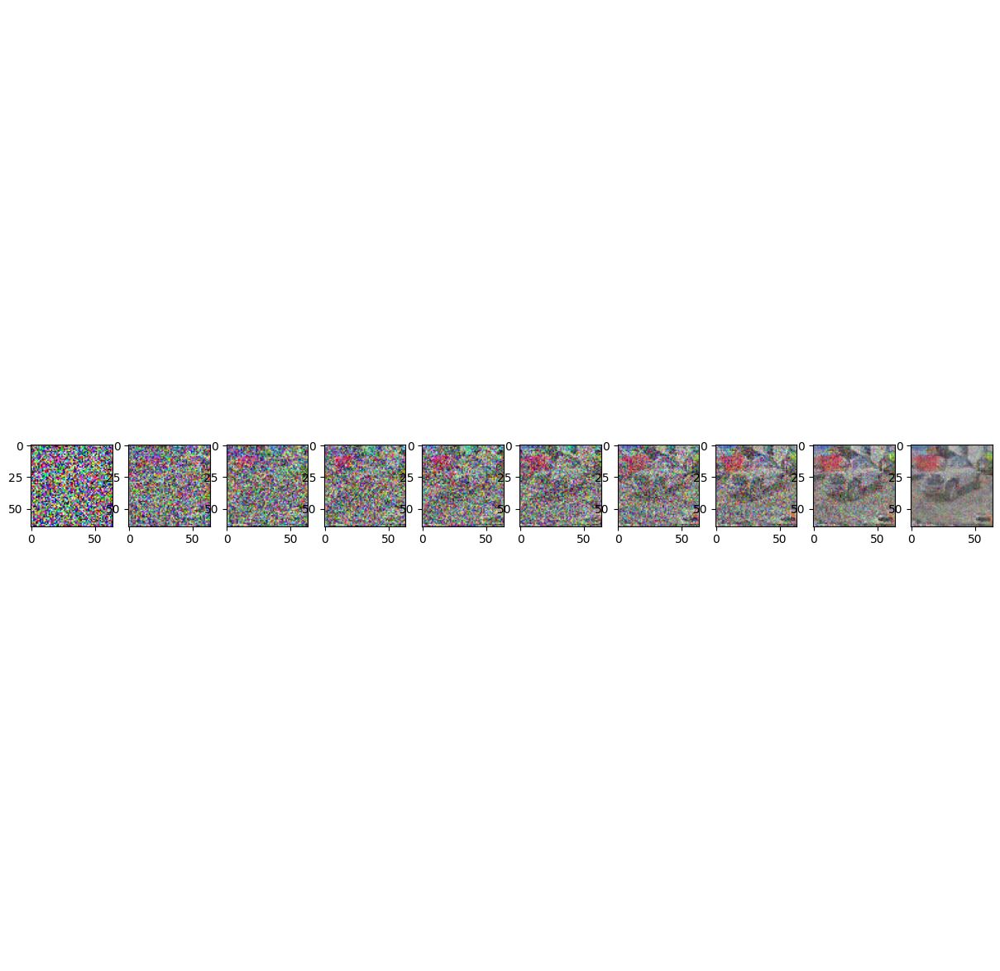

Epoch 256 started
Epoch 257 started
Epoch 258 started
Epoch 259 started
Epoch 260 started
Loss: 0.12566065788269043


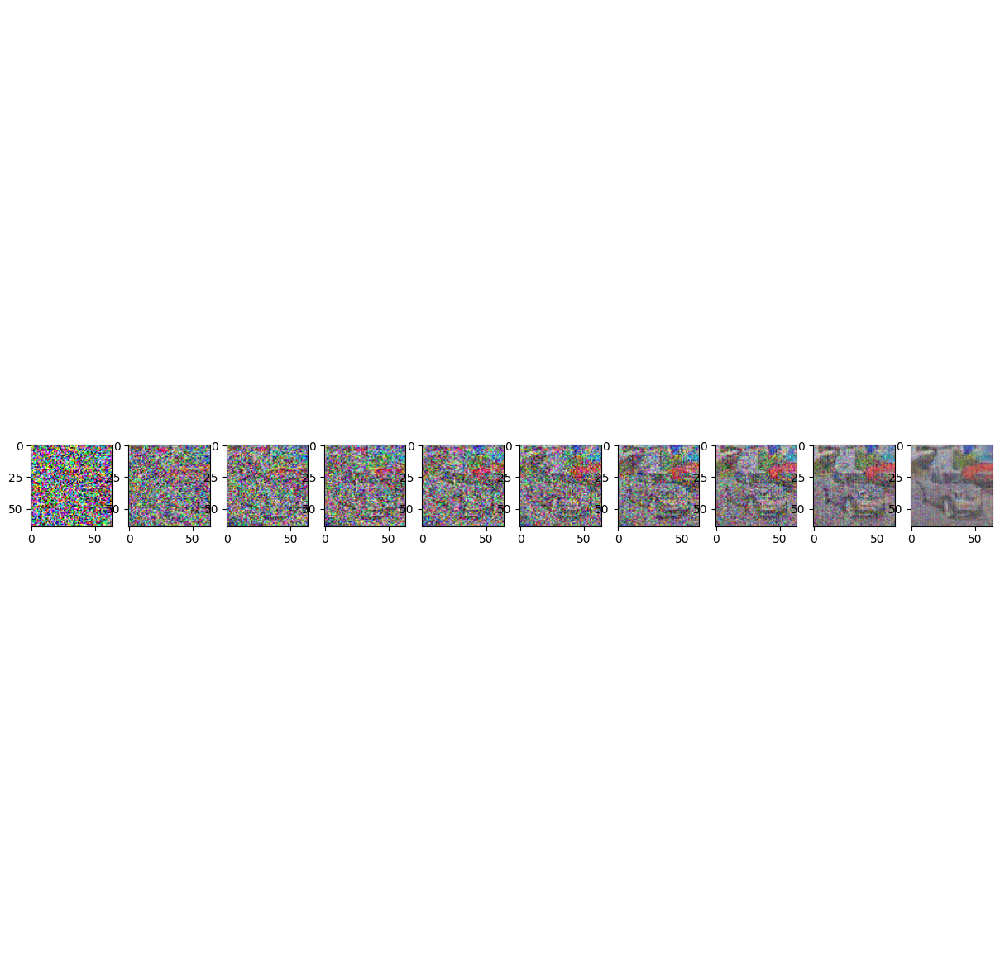

Epoch 261 started
Epoch 262 started
Epoch 263 started
Epoch 264 started
Epoch 265 started
Loss: 0.13152353465557098


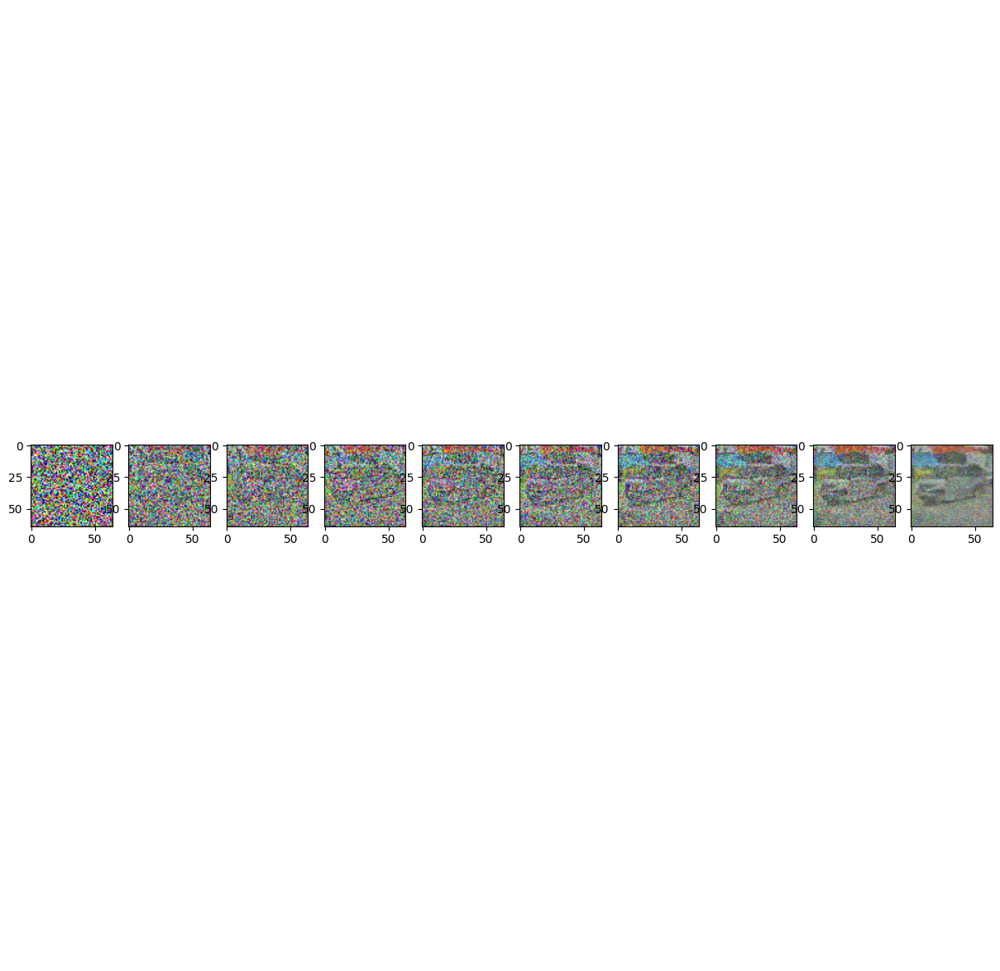

Epoch 266 started
Epoch 267 started
Epoch 268 started
Epoch 269 started
Epoch 270 started
Loss: 0.1336630880832672


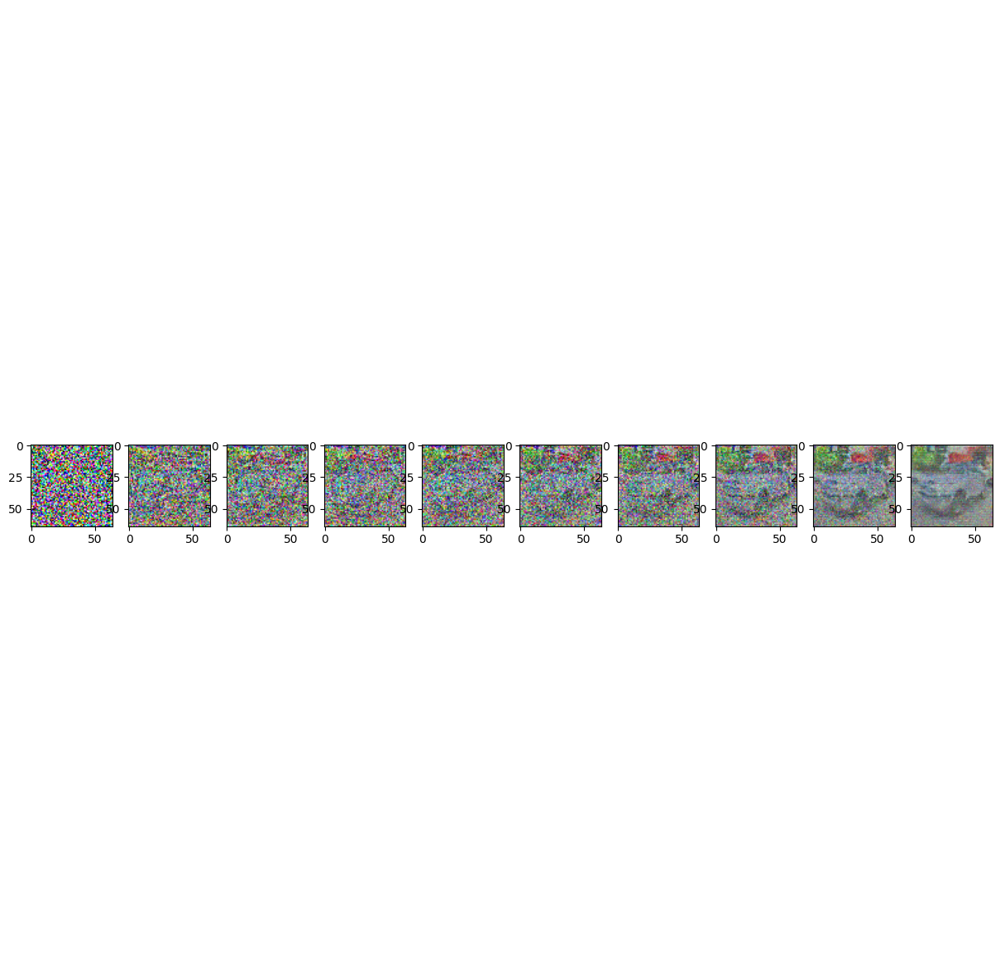

Epoch 271 started
Epoch 272 started
Epoch 273 started
Epoch 274 started
Epoch 275 started
Loss: 0.11521045863628387


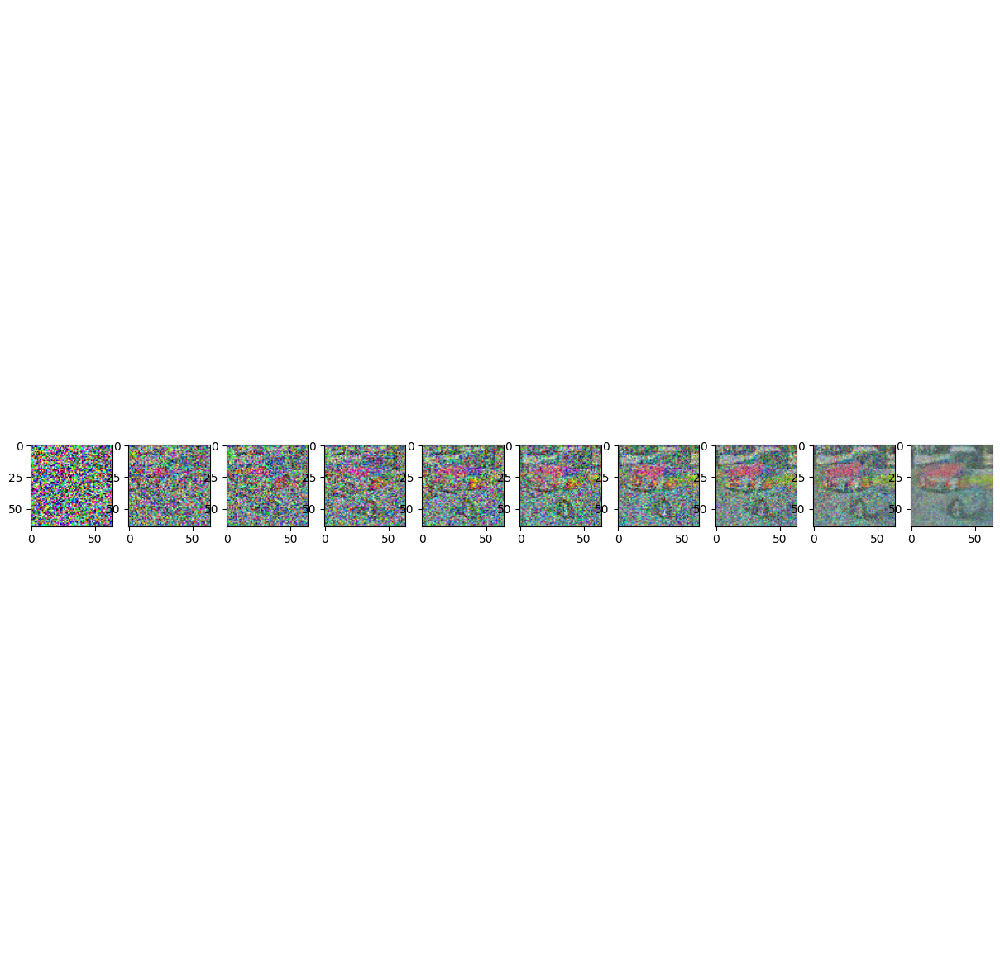

Epoch 276 started
Epoch 277 started
Epoch 278 started
Epoch 279 started
Epoch 280 started
Loss: 0.12516002357006073


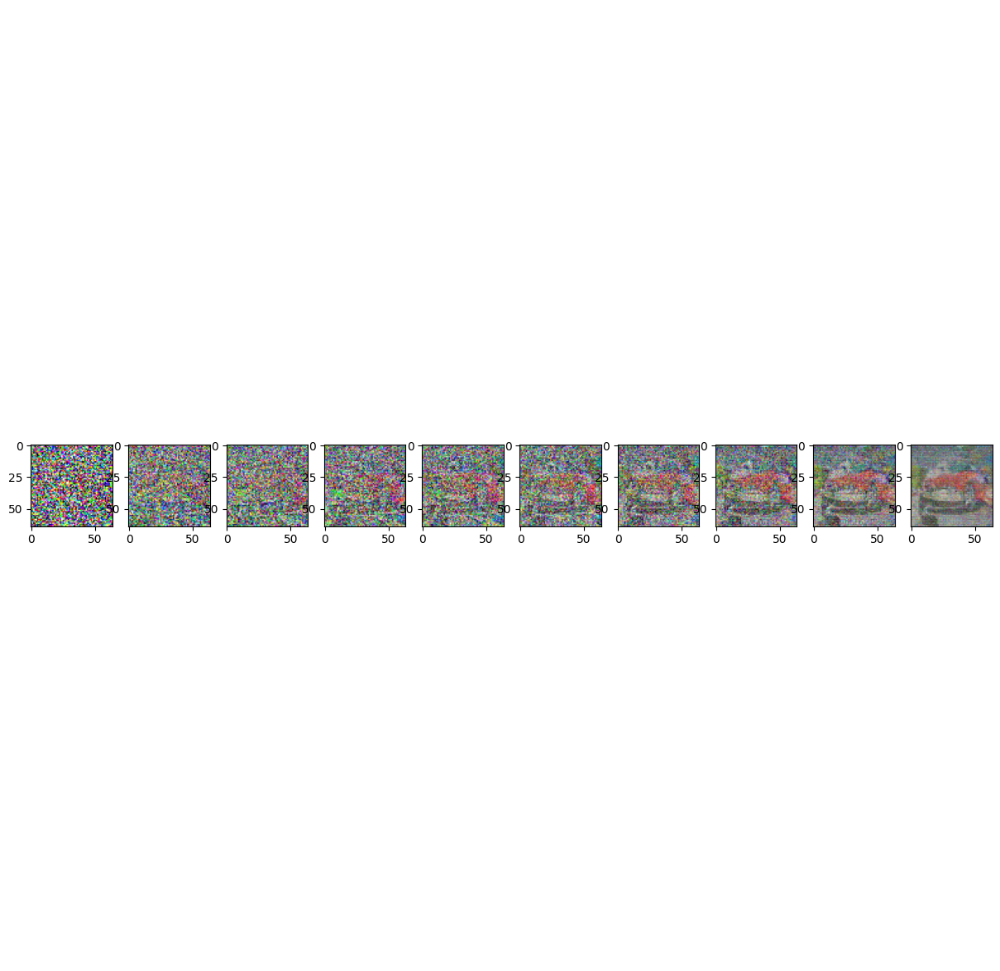

Epoch 281 started
Epoch 282 started
Epoch 283 started
Epoch 284 started
Epoch 285 started
Loss: 0.11680569499731064


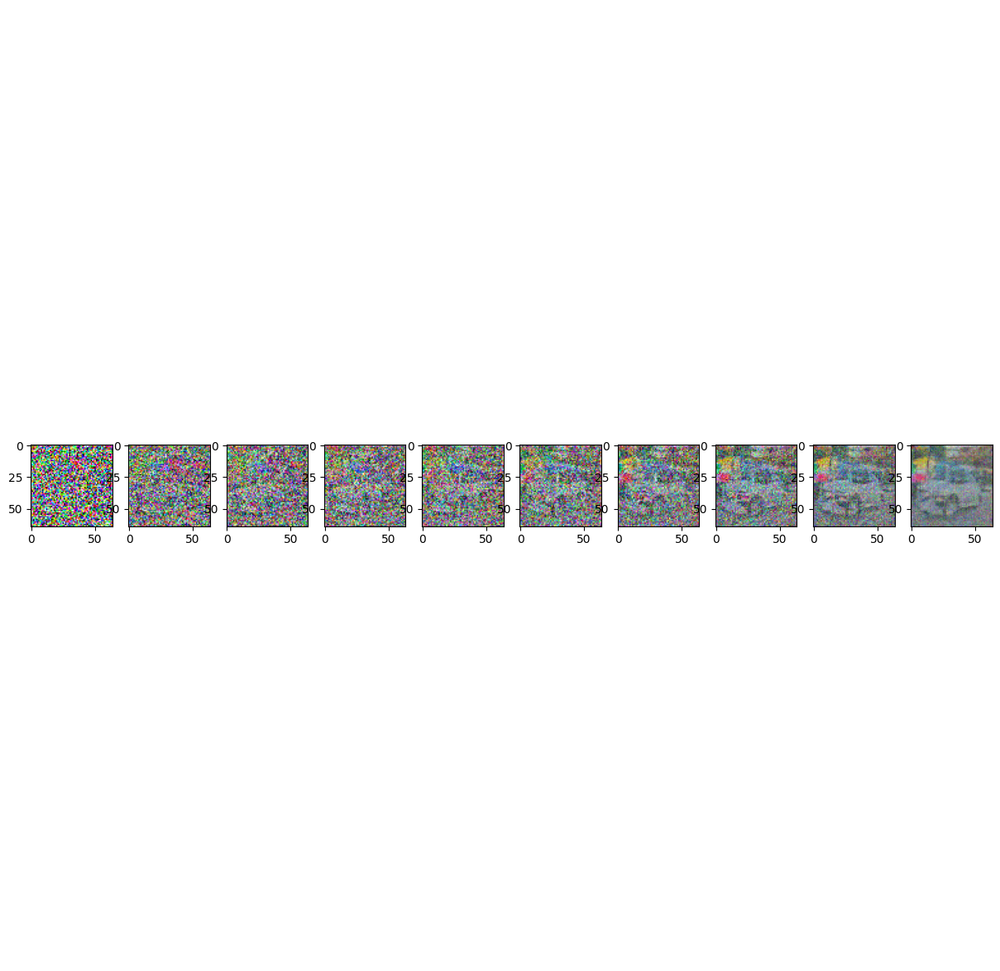

Epoch 286 started
Epoch 287 started
Epoch 288 started
Epoch 289 started
Epoch 290 started
Loss: 0.12007255852222443


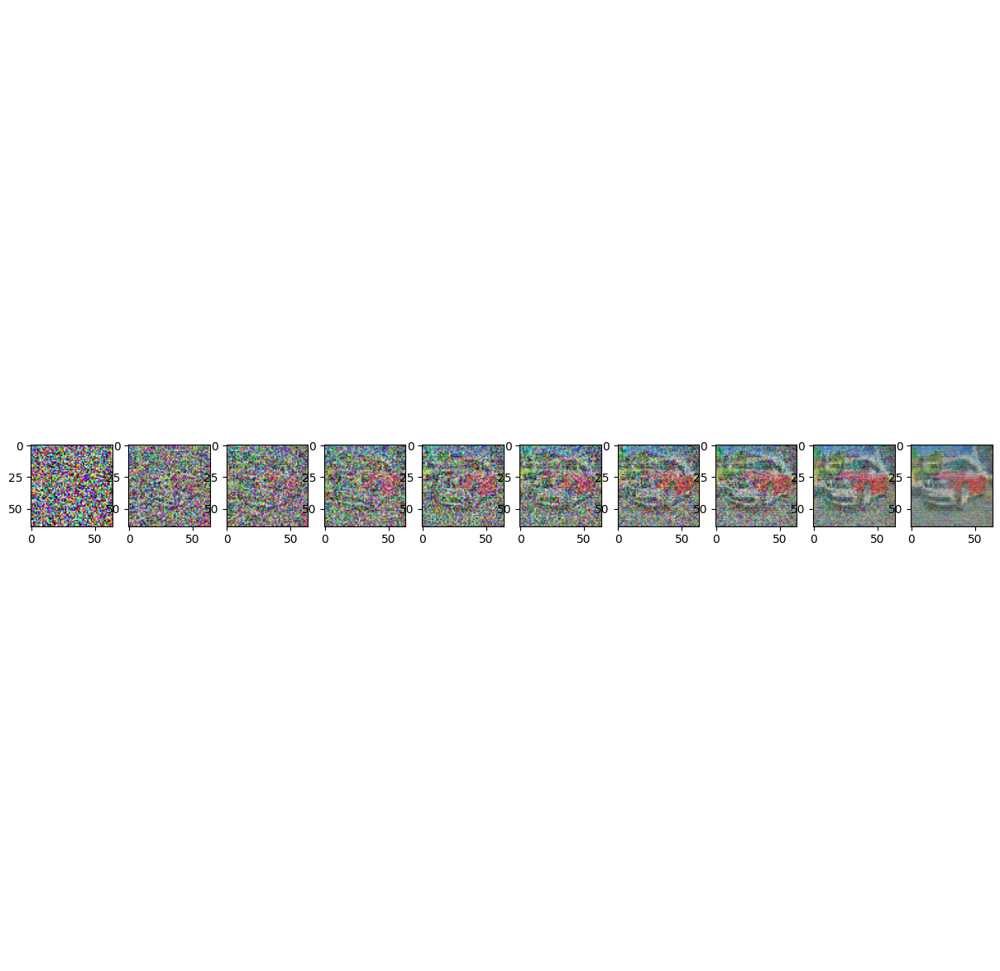

Epoch 291 started
Epoch 292 started
Epoch 293 started
Epoch 294 started
Epoch 295 started
Loss: 0.1145281046628952


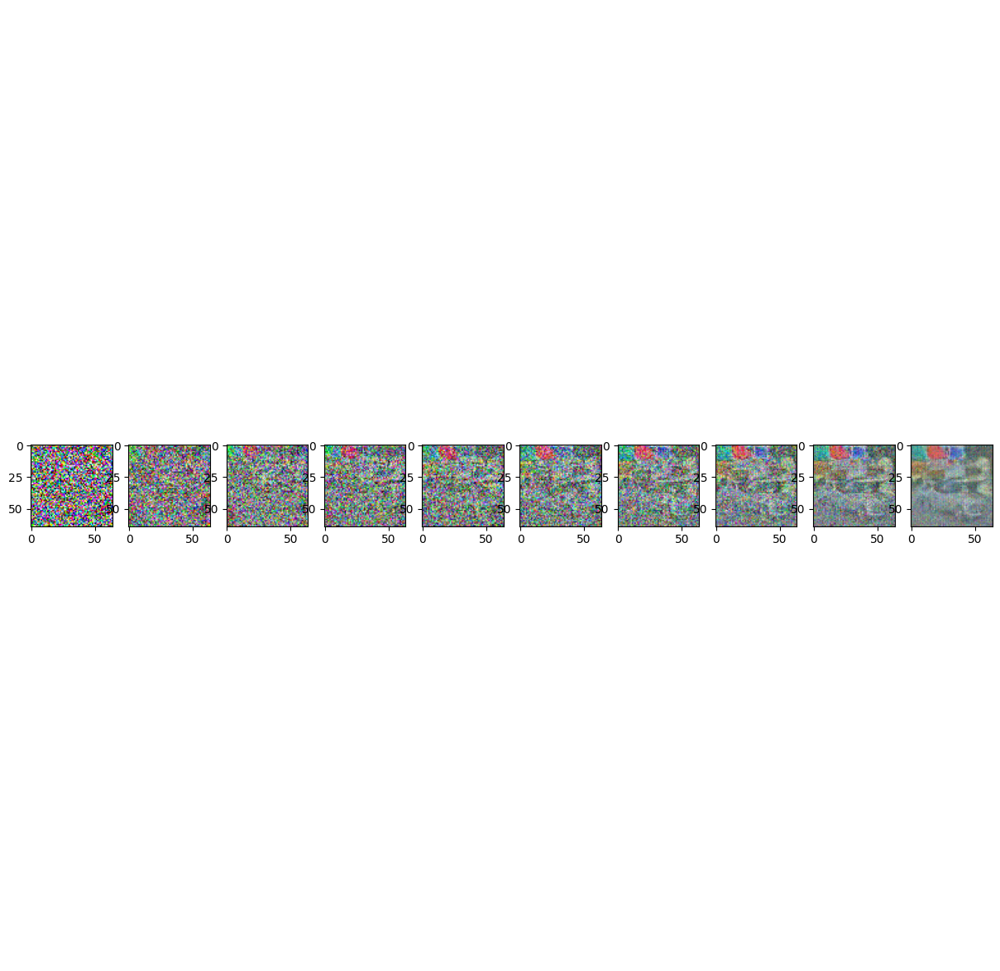

Epoch 296 started
Epoch 297 started
Epoch 298 started
Epoch 299 started
Epoch 300 started
Loss: 0.1276981681585312


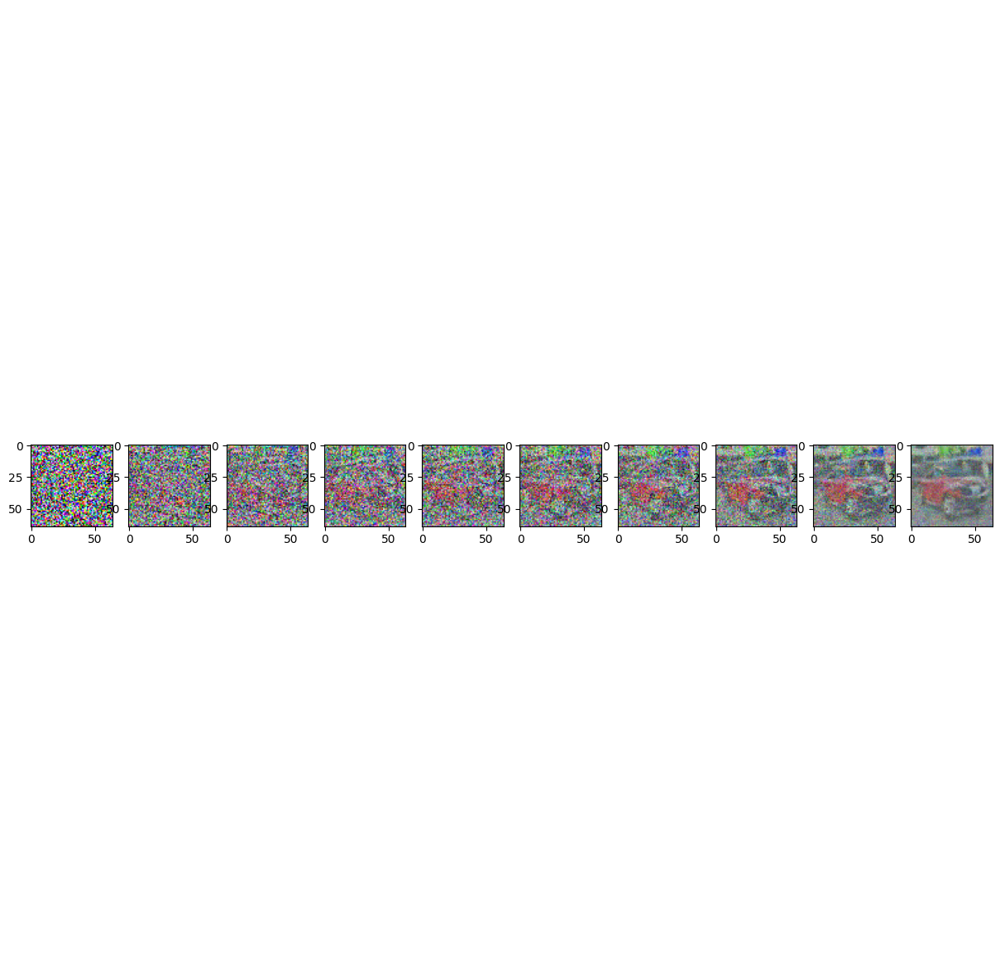

Epoch 301 started
Epoch 302 started
Epoch 303 started
Epoch 304 started
Epoch 305 started
Loss: 0.12612870335578918


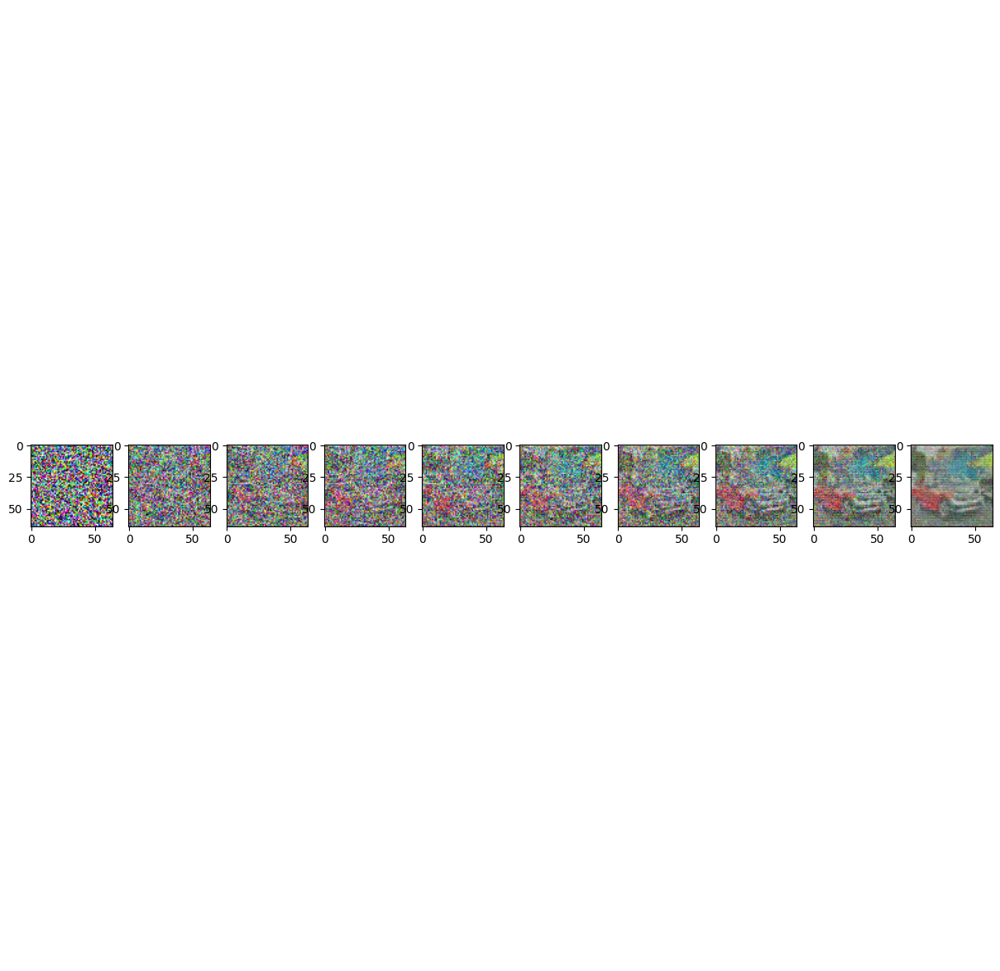

Epoch 306 started
Epoch 307 started
Epoch 308 started
Epoch 309 started
Epoch 310 started
Loss: 0.12351372838020325


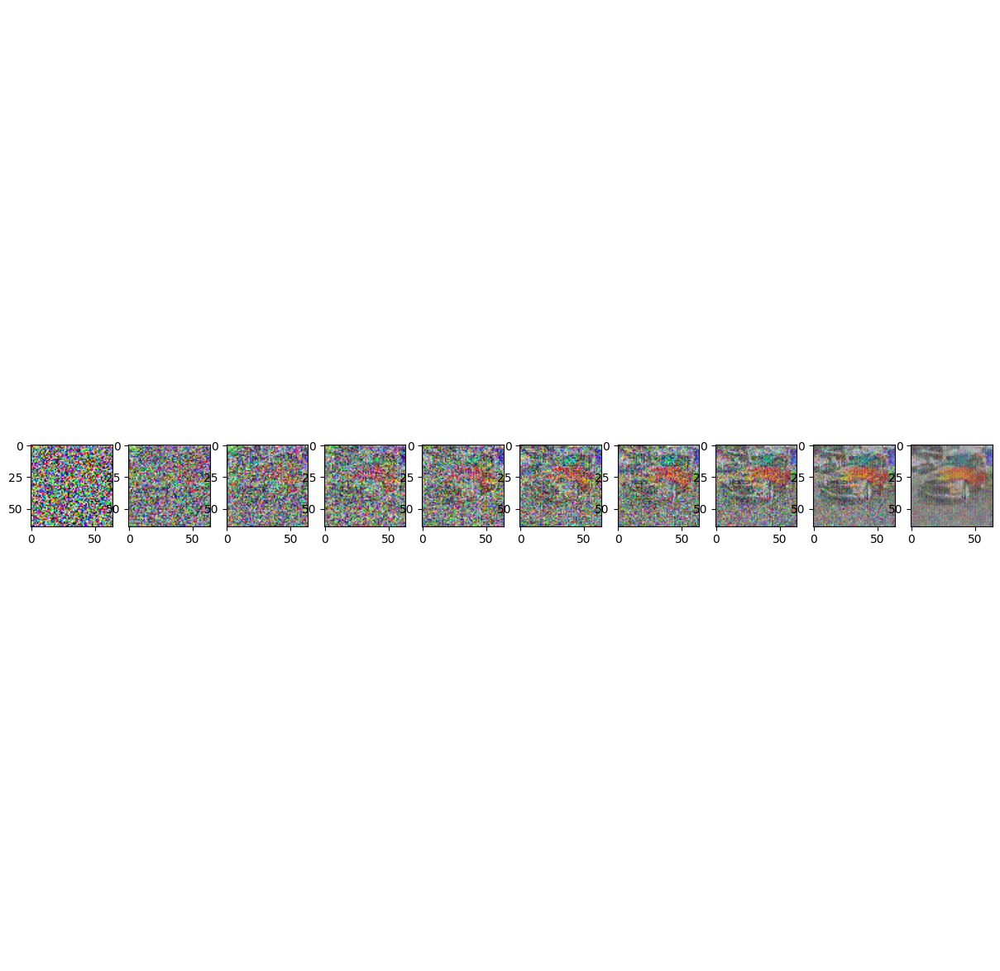

Epoch 311 started
Epoch 312 started
Epoch 313 started
Epoch 314 started
Epoch 315 started
Loss: 0.13145822286605835


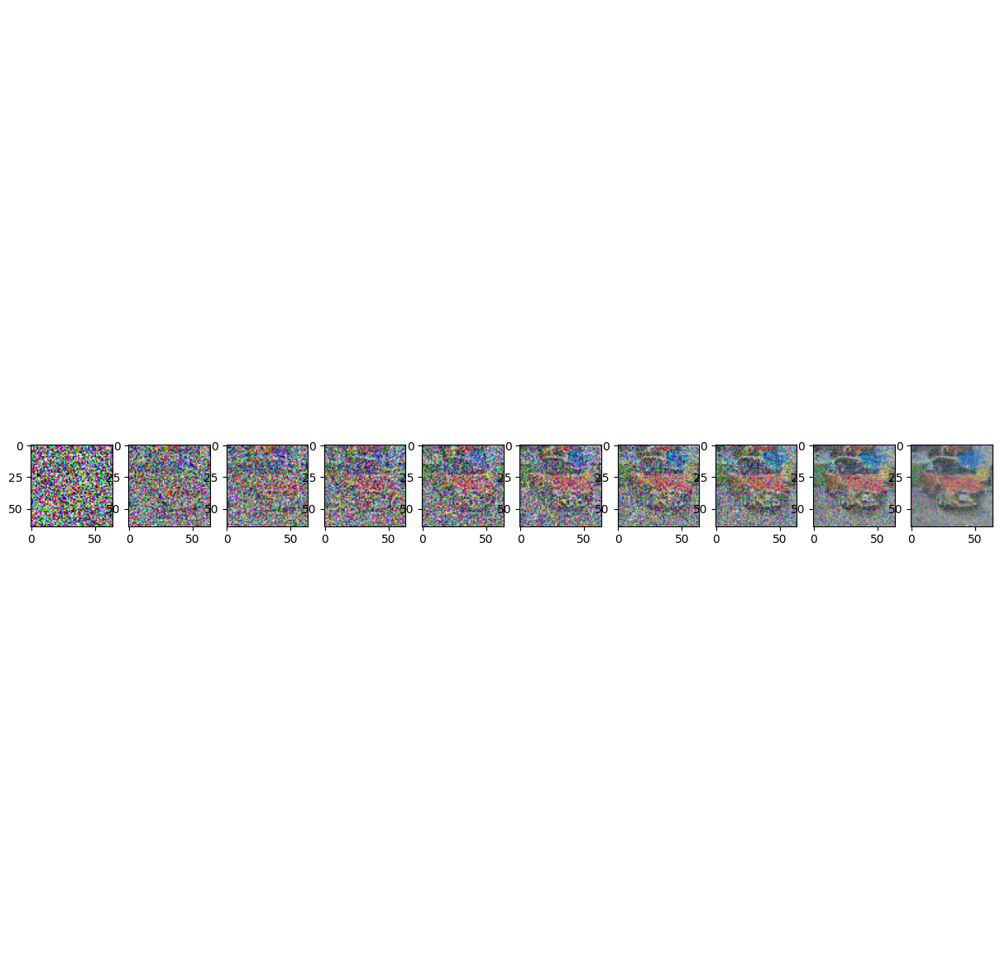

Epoch 316 started
Epoch 317 started
Epoch 318 started
Epoch 319 started
Epoch 320 started
Loss: 0.11325404047966003


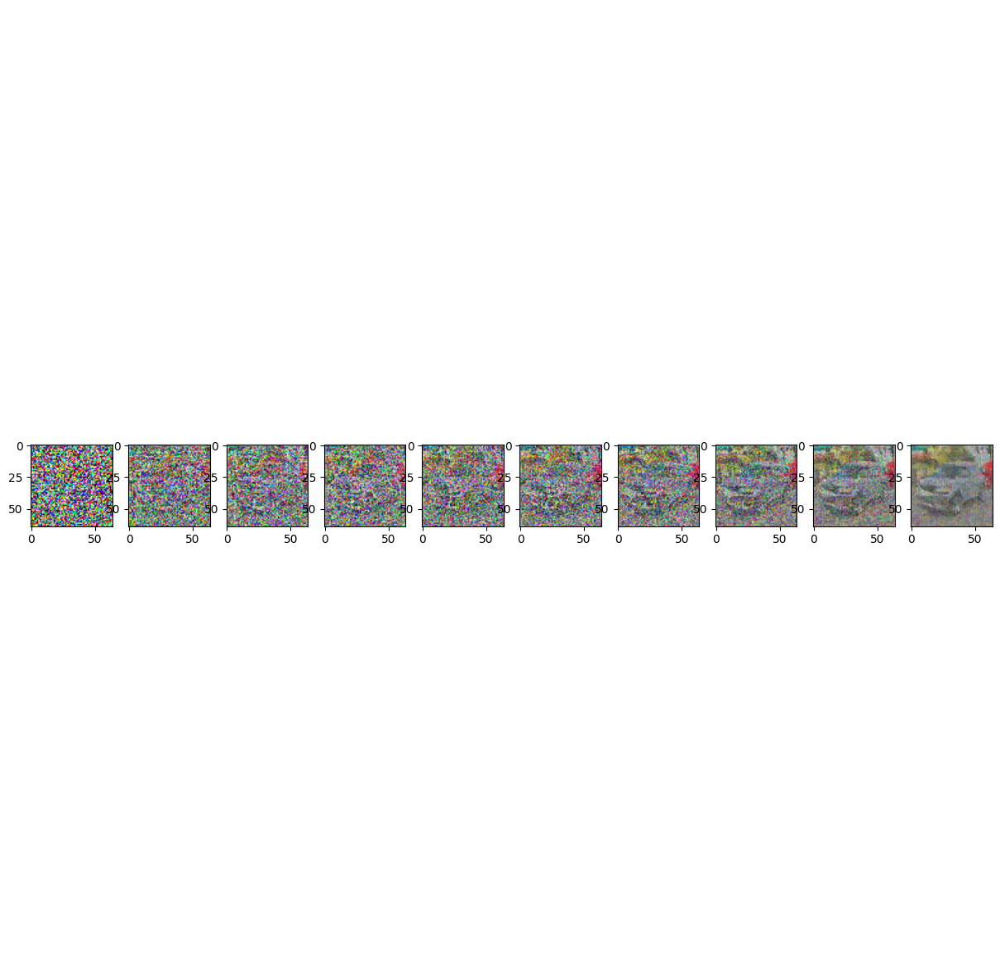

Epoch 321 started
Epoch 322 started
Epoch 323 started
Epoch 324 started
Epoch 325 started
Loss: 0.11975367367267609


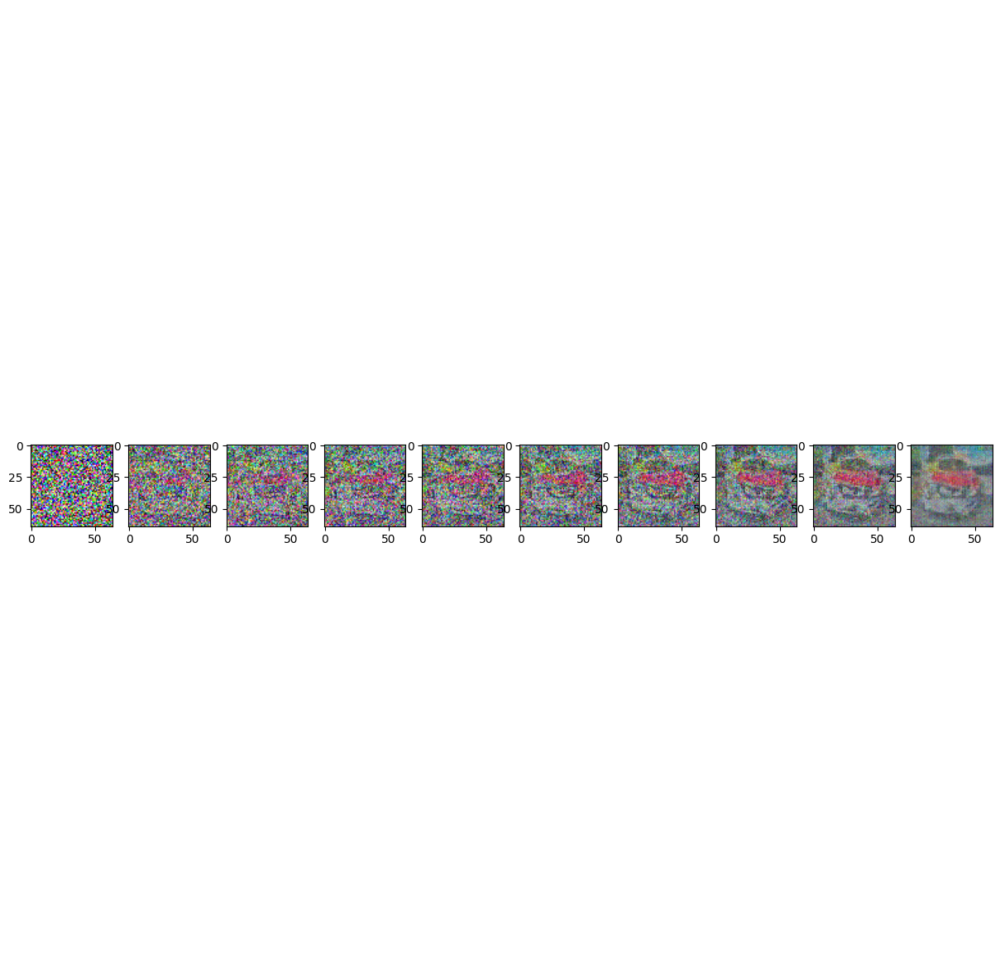

Epoch 326 started
Epoch 327 started
Epoch 328 started
Epoch 329 started
Epoch 330 started
Loss: 0.12650732696056366


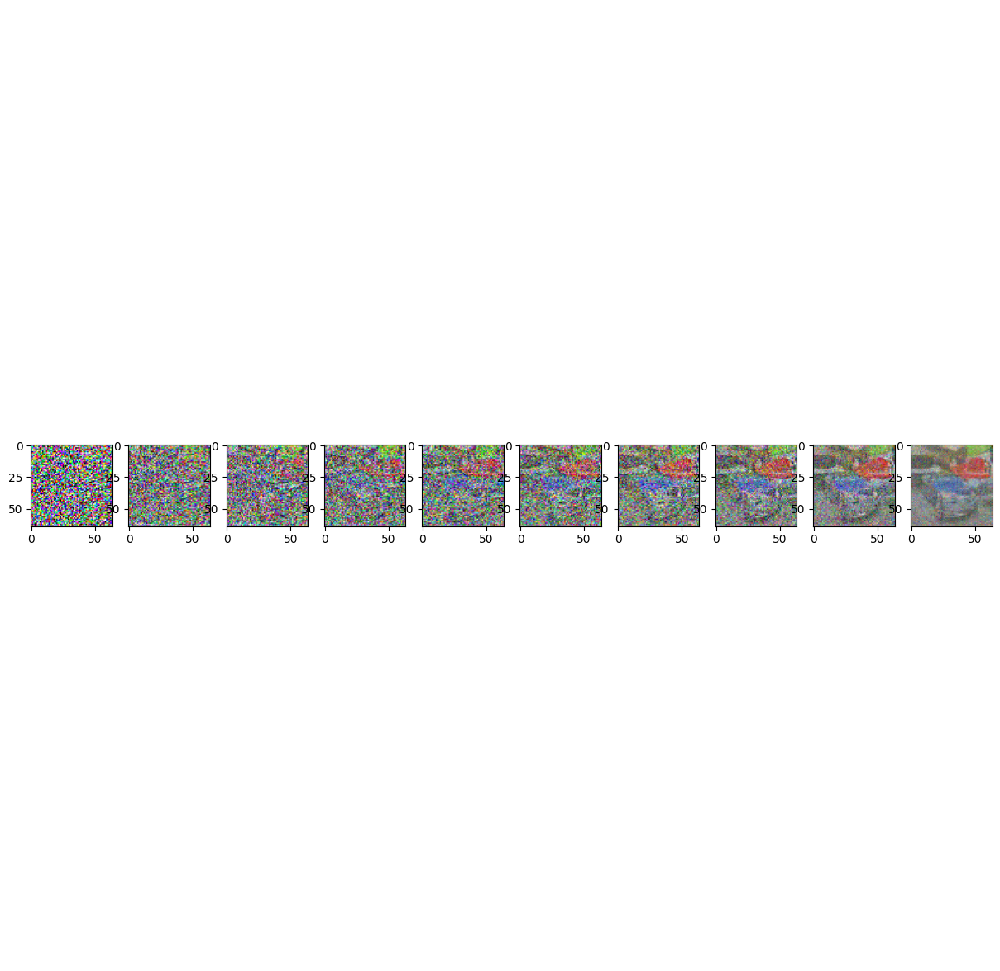

Epoch 331 started
Epoch 332 started
Epoch 333 started
Epoch 334 started
Epoch 335 started
Loss: 0.14240898191928864


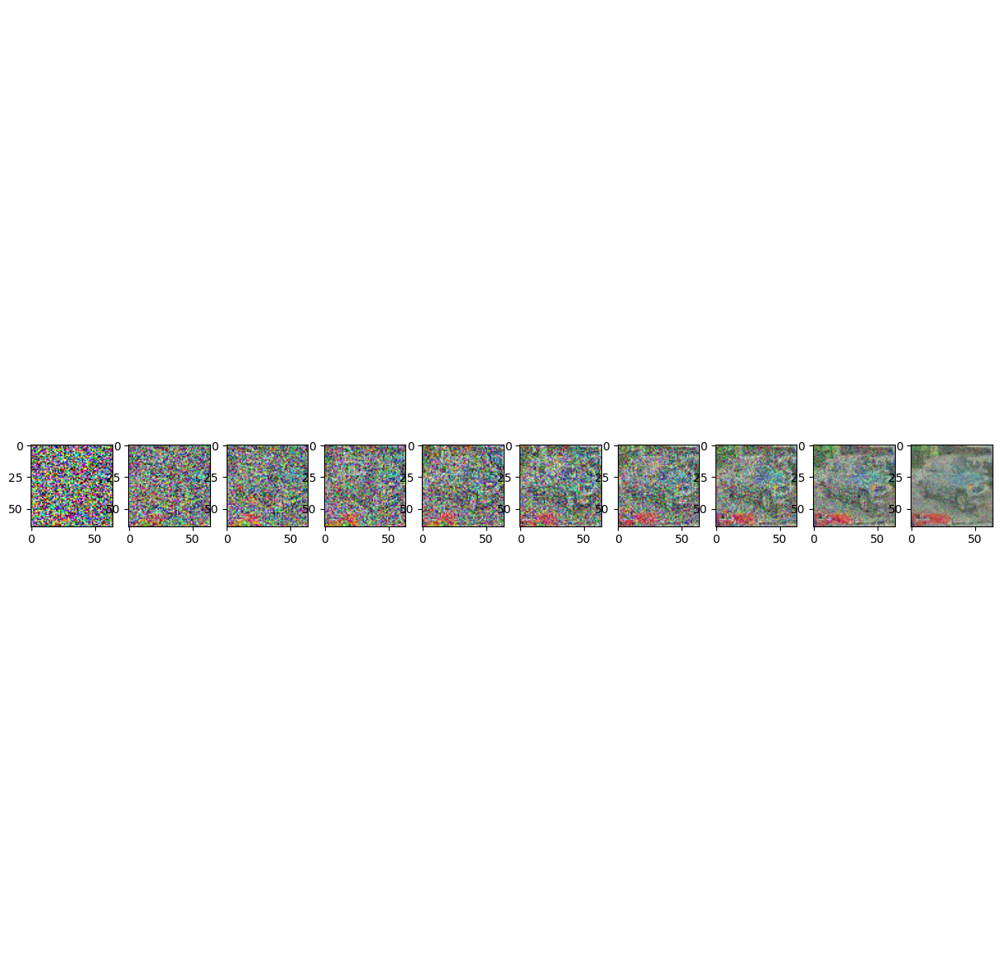

Epoch 336 started
Epoch 337 started
Epoch 338 started
Epoch 339 started
Epoch 340 started
Loss: 0.12798316776752472


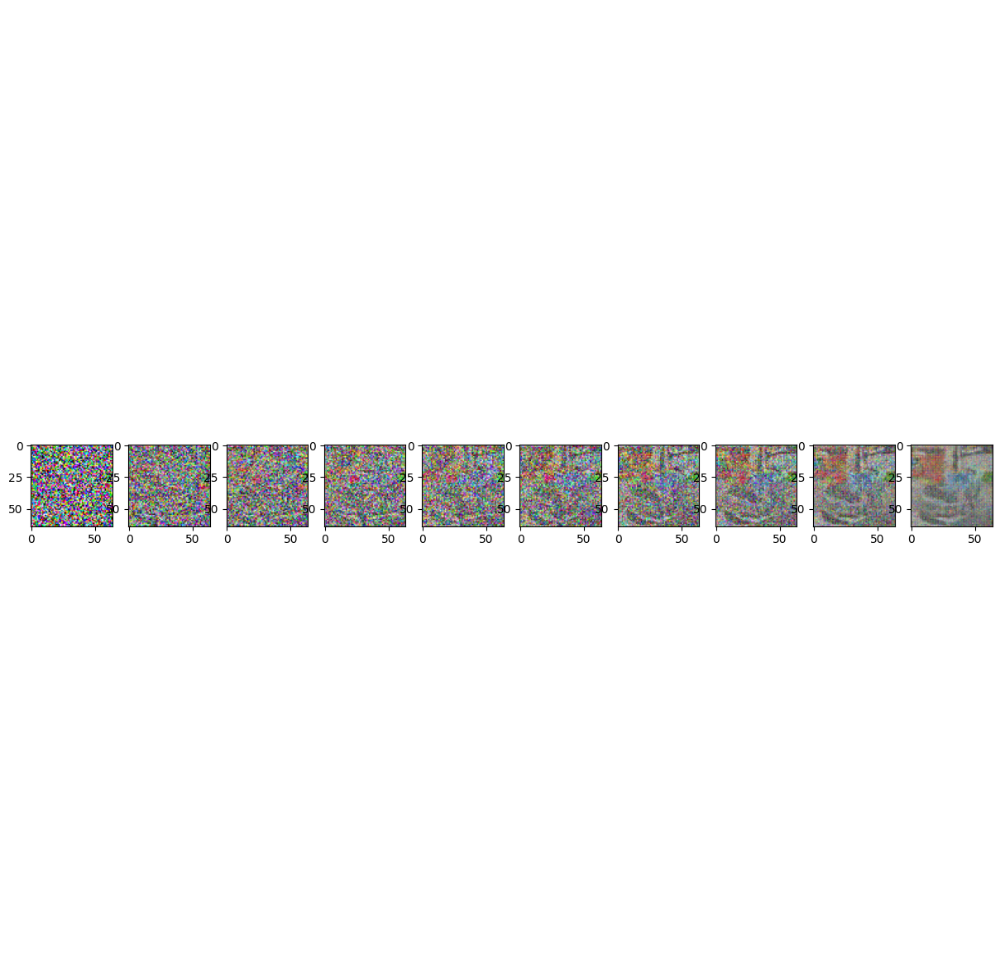

Epoch 341 started
Epoch 342 started
Epoch 343 started
Epoch 344 started
Epoch 345 started
Loss: 0.130962073802948


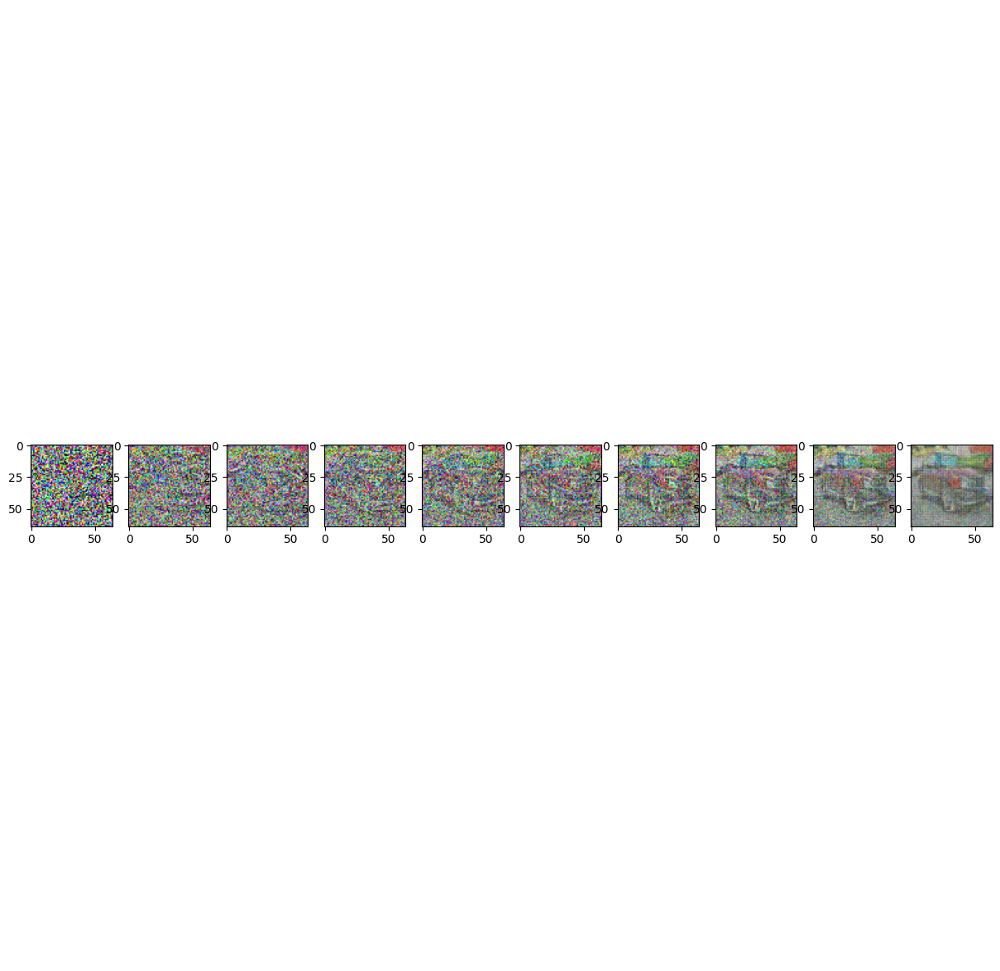

Epoch 346 started
Epoch 347 started
Epoch 348 started
Epoch 349 started
Epoch 350 started
Loss: 0.11200164258480072


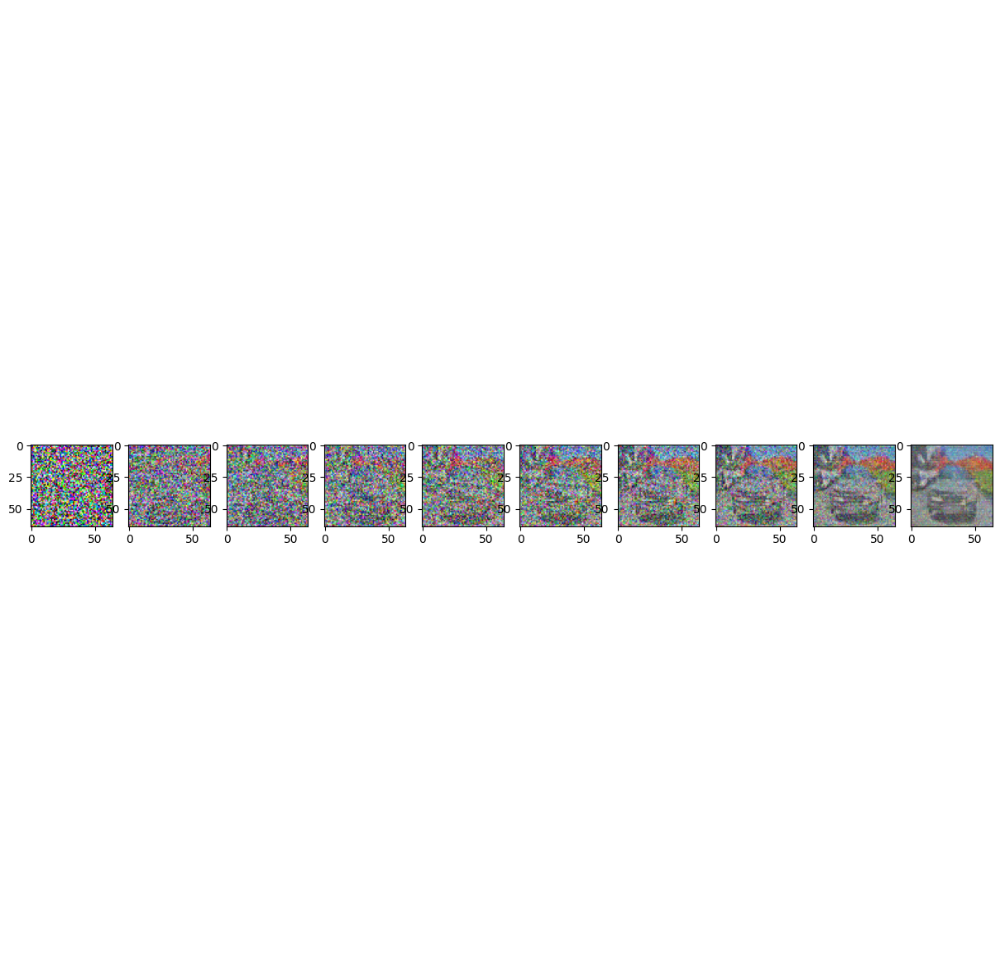

Epoch 351 started
Epoch 352 started
Epoch 353 started
Epoch 354 started
Epoch 355 started
Loss: 0.13201981782913208


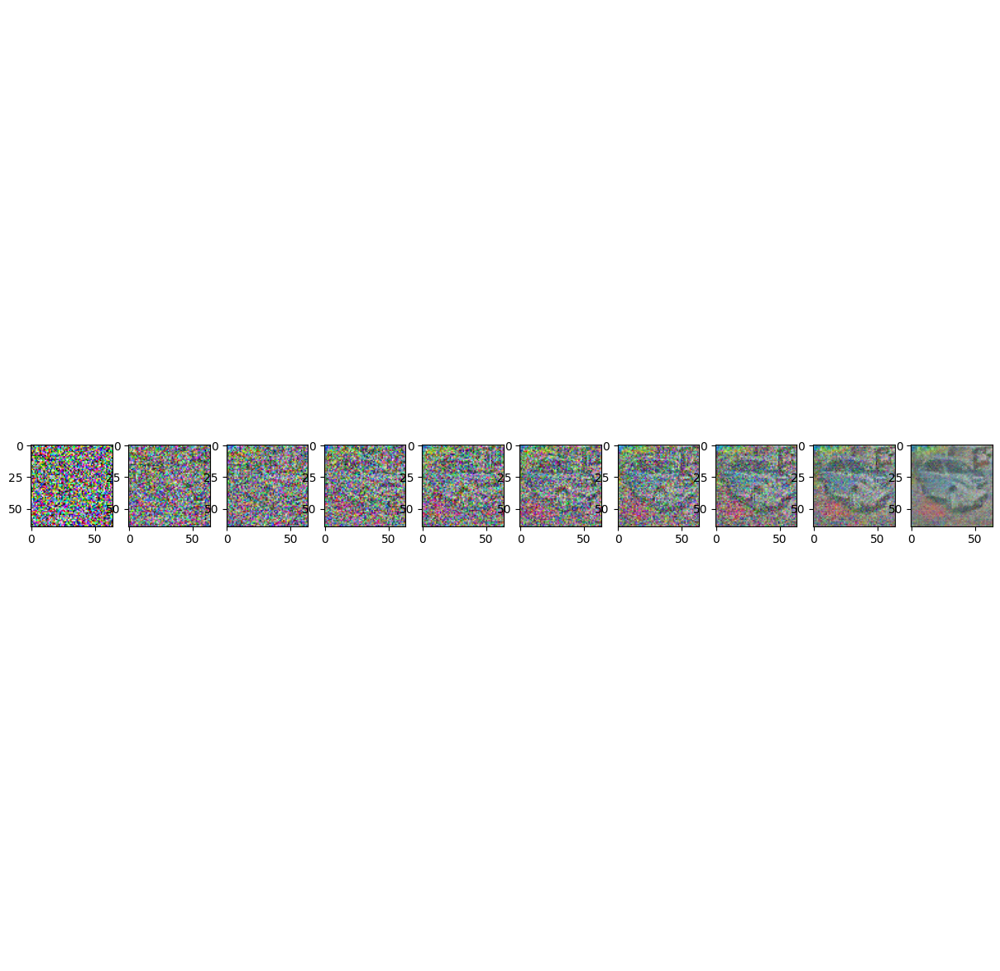

Epoch 356 started
Epoch 357 started
Epoch 358 started
Epoch 359 started
Epoch 360 started
Loss: 0.11899035423994064


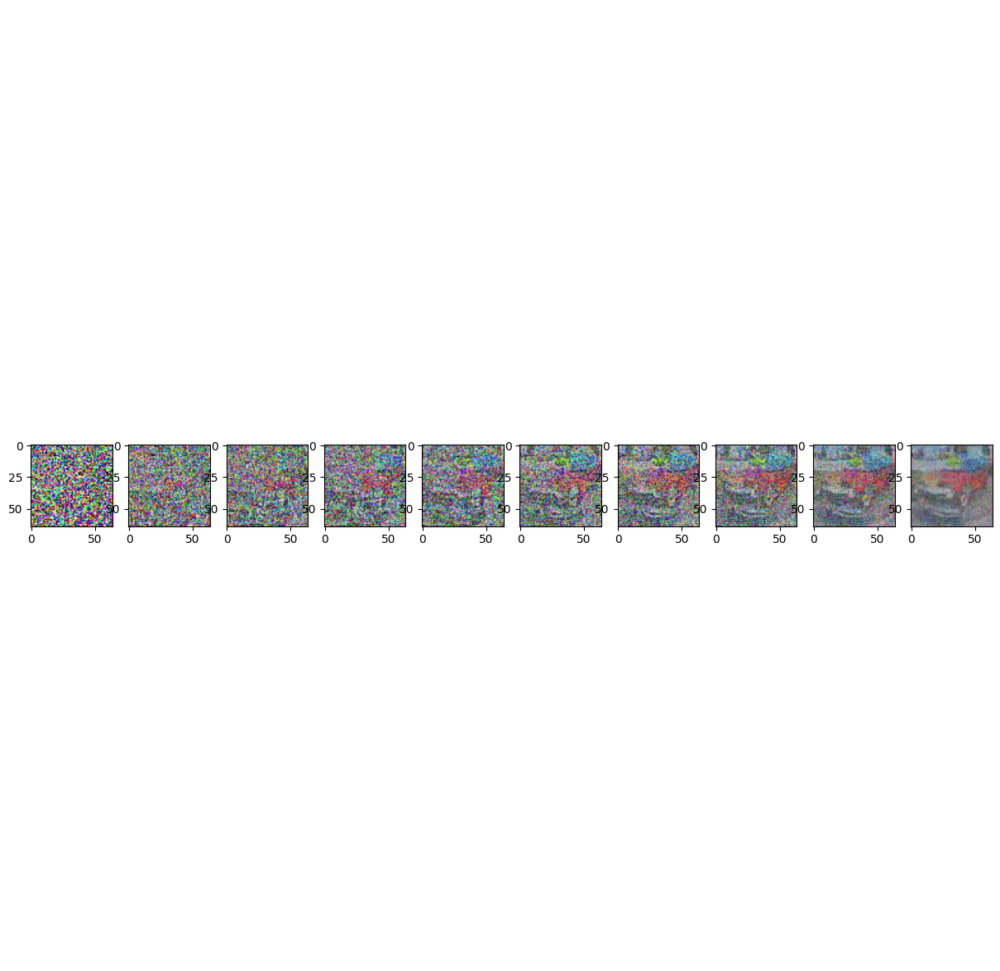

Epoch 361 started
Epoch 362 started
Epoch 363 started
Epoch 364 started
Epoch 365 started
Loss: 0.11899019777774811


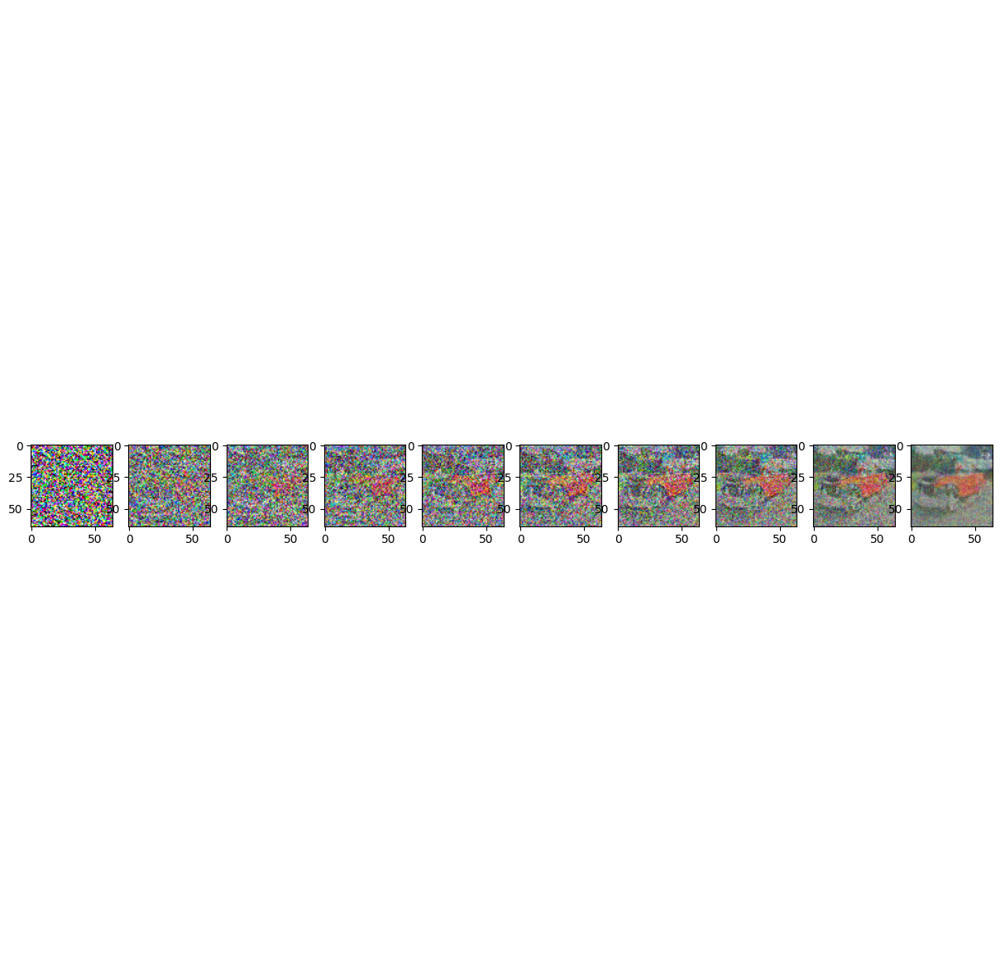

Epoch 366 started
Epoch 367 started
Epoch 368 started
Epoch 369 started
Epoch 370 started
Loss: 0.12743628025054932


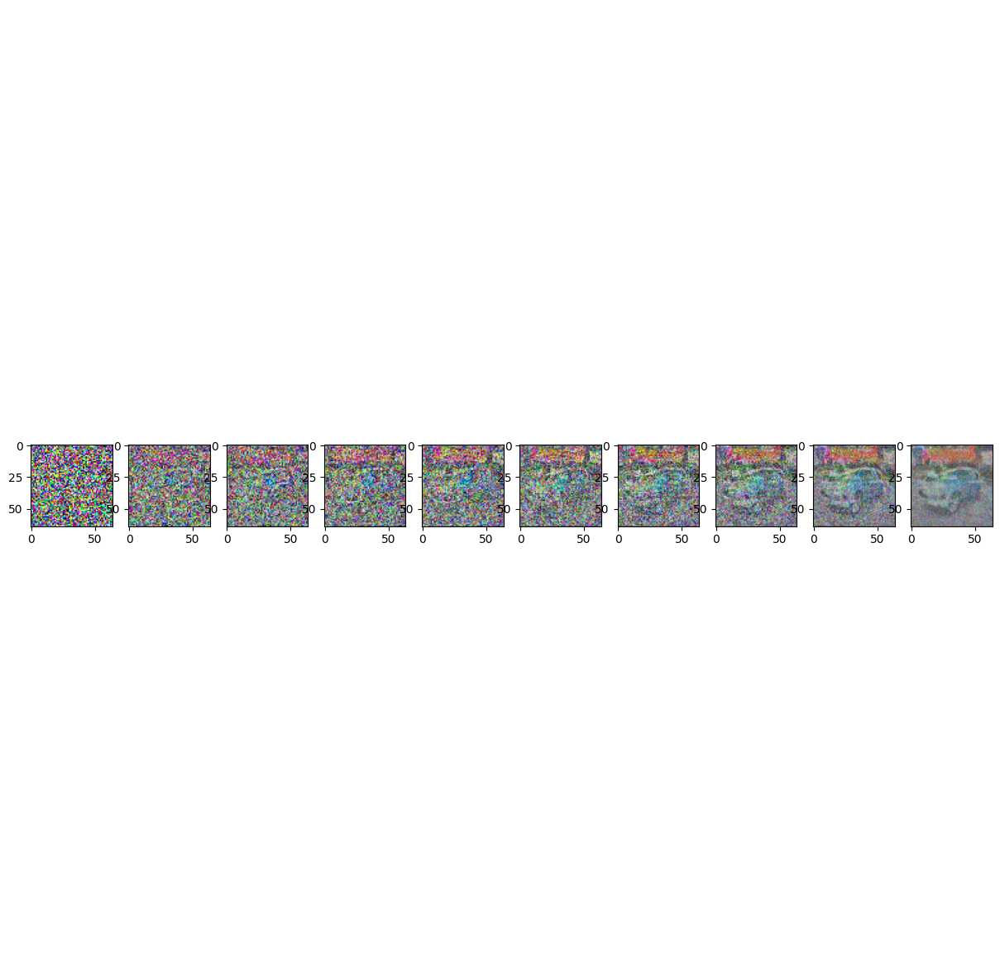

Epoch 371 started
Epoch 372 started
Epoch 373 started
Epoch 374 started
Epoch 375 started
Loss: 0.12662868201732635


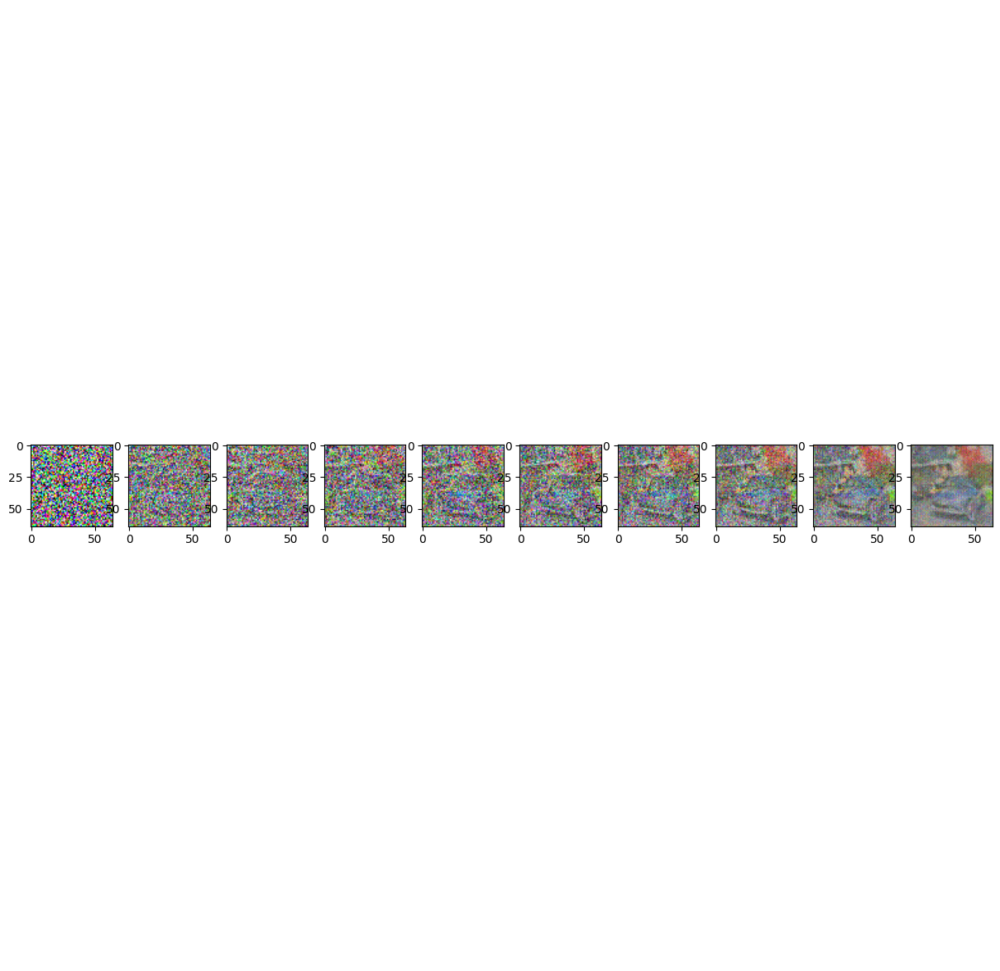

Epoch 376 started
Epoch 377 started
Epoch 378 started
Epoch 379 started
Epoch 380 started
Loss: 0.12438397109508514


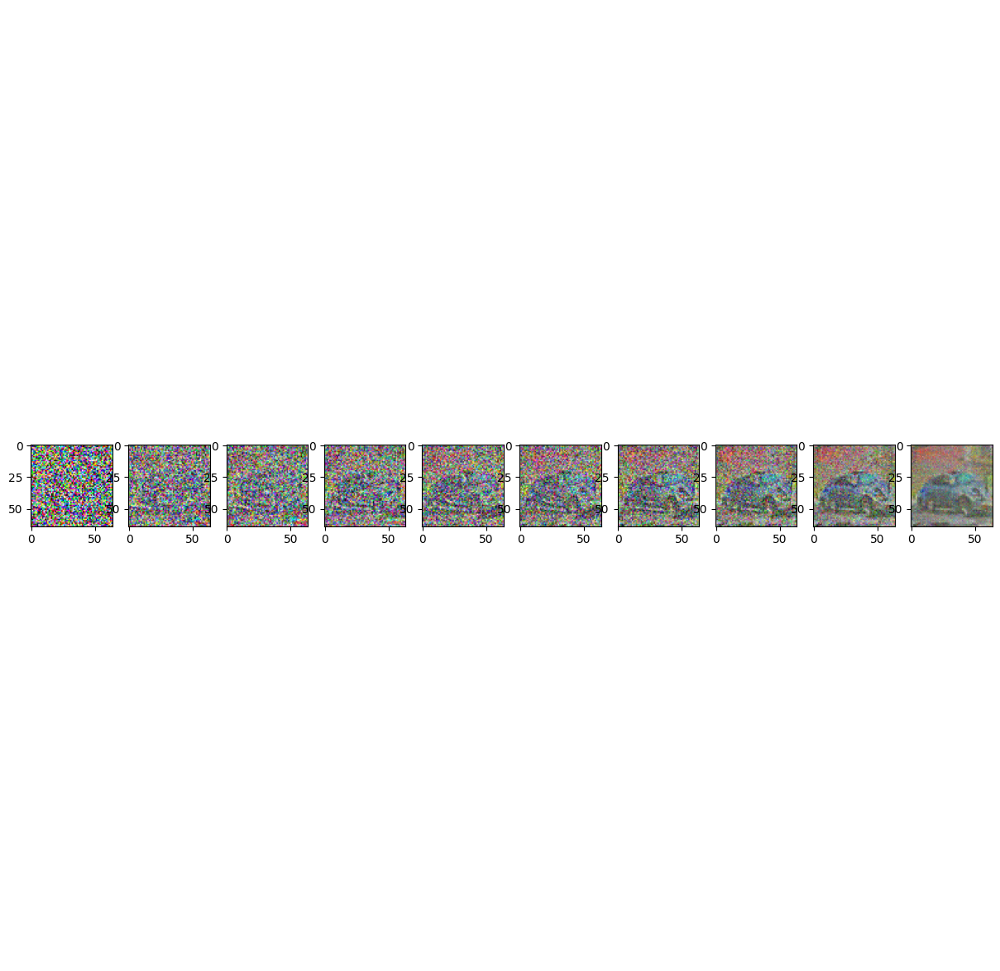

Epoch 381 started
Epoch 382 started
Epoch 383 started
Epoch 384 started
Epoch 385 started
Loss: 0.11629196256399155


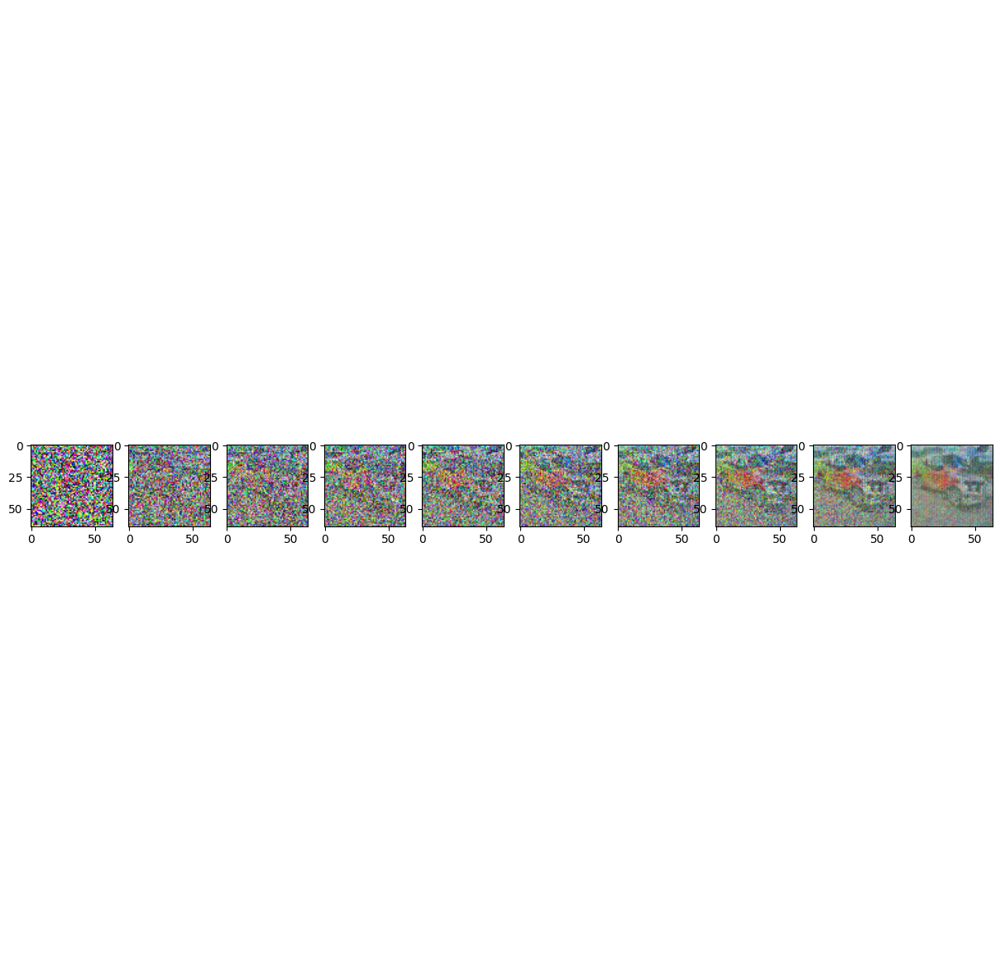

Epoch 386 started
Epoch 387 started
Epoch 388 started
Epoch 389 started
Epoch 390 started
Loss: 0.11853992193937302


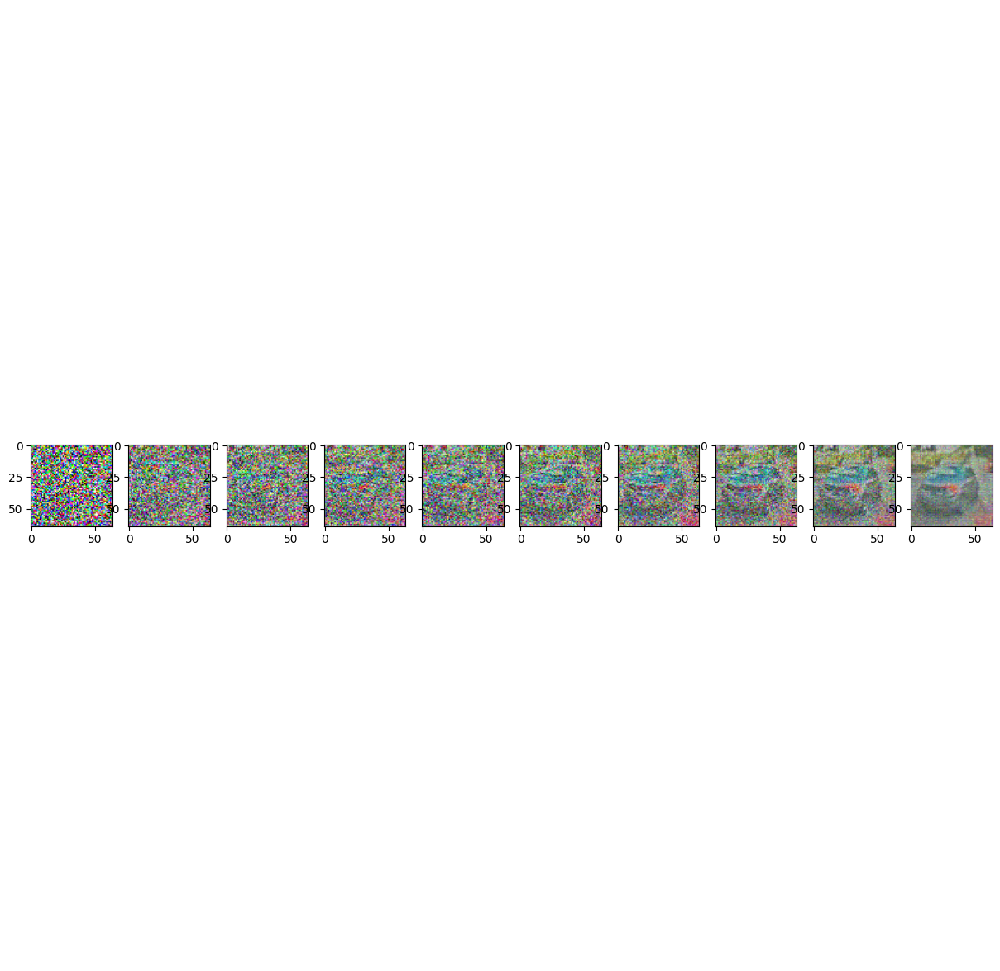

Epoch 391 started
Epoch 392 started
Epoch 393 started
Epoch 394 started
Epoch 395 started
Loss: 0.11512844264507294


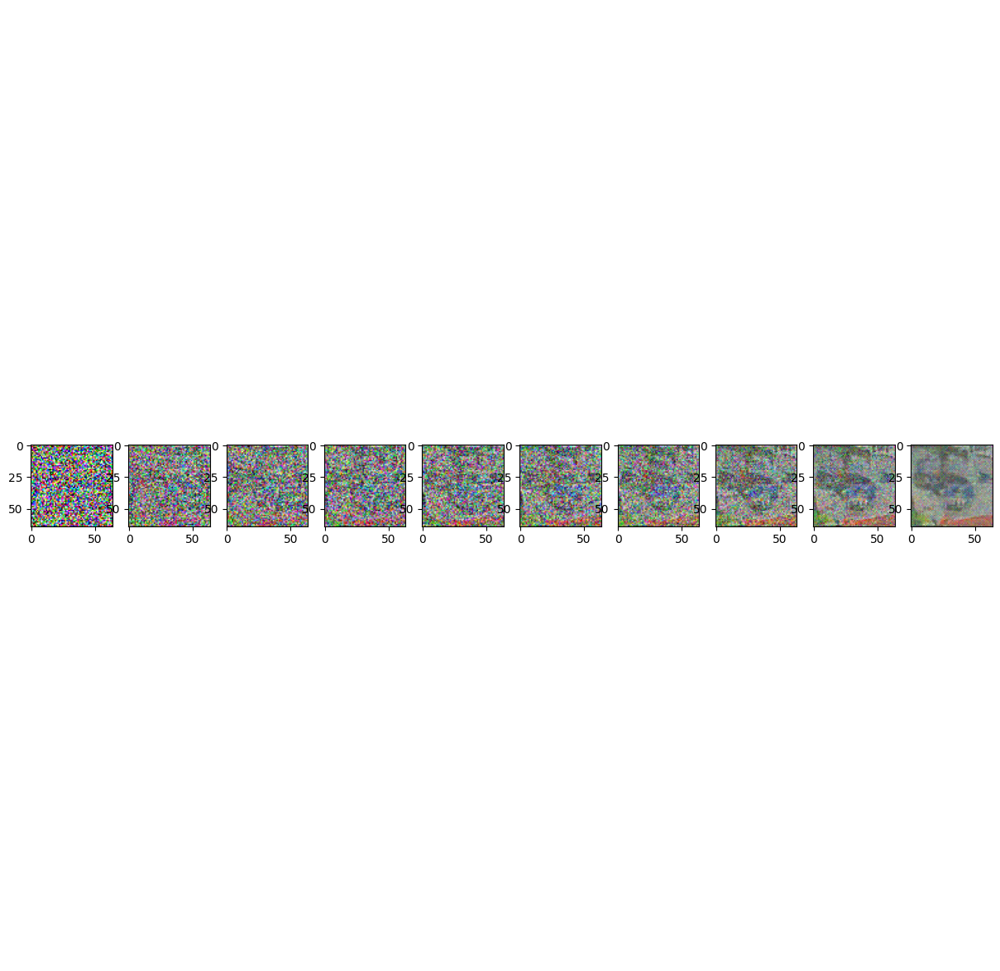

Epoch 396 started
Epoch 397 started
Epoch 398 started
Epoch 399 started
Loaded model from epoch 400 with loss None


In [28]:
def train_model(optimizer, epochs, path):
    device = "cuda" if torch.cuda.is_available() else "cpu"
    model.to(device)
    loss = None  # Initialize loss within the function
    for epoch in range(epochs):
        print(f"Epoch {epoch} started")
        for step, batch in enumerate(dataloader):
            optimizer.zero_grad()
            t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
            loss = get_loss(model, batch[0].to(device), t, device)
            loss.backward()
            optimizer.step()

            if epoch % 5 == 0 and step == 0:
                print(f"Loss: {loss.item()}")
                sample_plot_image(device)
    return loss

optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
epochs = 400  # Define the number of epochs globally
path = "./model_checkpoint.pth"  # Define the path to save the model
loss = train_model(optimizer, epochs, path)

# epoch, loss = load_model(model, optimizer, path)
# print(f"Loaded model from epoch {epoch} with loss {loss}")


In [ ]:
save_model(model, optimizer, epochs, loss, path)